# Capstone Project Part 4: Classification and Prediction Models

In [916]:
import pandas as pd
from bs4 import BeautifulSoup
import requests
from pprint import pprint
import matplotlib.pyplot as plt
from pandas_summary import DataFrameSummary
import seaborn as sns
import numpy as np
from collections import Counter
import operator
plt.style.use('ggplot')
%config InlineBackend.figure_format = 'retina'
%matplotlib inline
import matplotlib.pyplot as plt


from sklearn.linear_model import LinearRegression,LogisticRegression, RidgeCV, LassoCV, Ridge, Lasso
from sklearn.model_selection import train_test_split, GridSearchCV
from sklearn.model_selection import cross_val_score, cross_val_predict, KFold, train_test_split
from sklearn.metrics import mean_squared_error, accuracy_score
from sklearn.preprocessing import StandardScaler, MinMaxScaler, RobustScaler
from sklearn.ensemble import RandomForestClassifier, RandomForestRegressor, ExtraTreesClassifier
from nltk.stem import WordNetLemmatizer
from sklearn.svm import SVR, LinearSVR
from sklearn.neural_network import MLPRegressor
from sklearn.pipeline import Pipeline
from sklearn.feature_selection import VarianceThreshold 
from sklearn.neighbors.classification import KNeighborsClassifier
from sklearn.multioutput import ClassifierChain
from sklearn.metrics import hamming_loss, zero_one_loss
from skmultilearn.problem_transform import BinaryRelevance, ClassifierChain, LabelPowerset
from skmultilearn.adapt import MLkNN
from textblob import TextBlob
from sklearn.metrics import accuracy_score, classification_report, confusion_matrix, precision_score, roc_auc_score
from sklearn.feature_extraction.text import CountVectorizer, TfidfTransformer
from sklearn.metrics import average_precision_score
from sklearn.metrics import precision_recall_curve
from sklearn.metrics import precision_score, recall_score, classification_report, mean_squared_error, roc_curve, auc

from sklearn.externals.six import StringIO
from sklearn.tree import export_graphviz
import pydotplus
from IPython.display import Image

from sklearn.metrics import precision_recall_curve

from PIL import Image
import matplotlib.pyplot as plt
import matplotlib as mpl
from wordcloud import WordCloud
import matplotlib.colors as colors

In [882]:
df = pd.read_csv('part_3_with_occ_gend_top.csv')
pd.set_option('display.max_columns',None)
pd.set_option('display.max_rows',None)

In [883]:
# removing the unnamed column added when the dataframe was saved as csv at the previous section of the project
df = df[list(df.columns)[1:]]

In [884]:
df.head()

,comments,description,duration,event,film_date,languages,main_speaker,name,published_date,ratings,speaker_occupation,tags,title,url,views,music,conversation,transcript,persuasive,inspiring,unconvincing,applause,laughter,norm_persuasive,norm_inspiring,norm_unconvincing,WC,Analytic,Clout,Authentic,Tone,WPS,Sixltr,Dic,function,pronoun,ppron,i,we,you,shehe,they,ipron,article,prep,auxverb,adverb,conj,negate,verb,adj,compare,interrog,number,quant,affect,posemo,negemo,anx,anger,sad,social,family,friend,female,male,cogproc,insight,cause,discrep,tentat,certain,differ,percept,see,hear,feel,bio,body,health,sexual,ingest,drives,affiliation,achieve,power,reward,risk,focuspast,focuspresent,focusfuture,relativ,motion,space,time,work,leisure,home,money,relig,death,informal,swear,netspeak,assent,nonflu,filler,AllPunc,Period,Comma,Colon,SemiC,QMark,Exclam,Dash,Quote,Apostro,Parenth,OtherP,Moral,HarmVirtue,HarmVice,FairnessVirtue,FairnessVice,IngroupVirtue,IngroupVice,AuthorityVirtue,AuthorityVice,PurityVirtue,PurityVice,MoralityGeneral,published_year,Harm,Fairness,Purity,Ingroup,Authority,fname,gender,technology_th,society_th,policy_politics_th,security_th,science_and_research_th,nature_environment_th,living_spaces_cult_th,religions_spirituality_th,tedmem_awardwin_th,emotions_psychology_th,business_th,entertainment_th,media_th,music_th,health_and_medicine_th,art_and_design_th,gender_matters_th,educ_learn_youth_th,sports,literature_th,human_th,continents_cities_countries_th,updated_occupations
0,4553,Sir Ken Robinson makes an entertaining and pro...,1164,TED2006,1140825600,60,Ken Robinson,Ken Robinson: Do schools kill creativity?,1151367060,"[{'id': 7, 'name': 'Funny', 'count': 19645}, {...",Author/educator,"['children', 'creativity', 'culture', 'dance',...",Do schools kill creativity?,https://www.ted.com/talks/ken_robinson_says_sc...,47227110,0,0,"Good morning. How are you?()It's been great, h...",10704,24924,300,4,39,226.649482,527.747728,6.352284,3119,38.67,90.77,30.78,56.66,15.07,14.84,91.50,59.70,18.98,12.28,2.50,2.56,2.60,2.76,1.86,6.70,7.57,13.02,12.02,5.13,6.70,2.28,20.94,3.30,1.54,2.12,1.67,1.83,3.78,2.66,1.03,0.35,0.10,0.10,16.45,0.45,0.03,2.47,1.31,11.99,2.82,1.76,2.08,2.15,1.64,3.56,2.79,0.80,1.76,0.13,1.67,0.74,0.45,0.03,0.35,8.27,3.33,1.12,2.98,0.83,0.45,6.25,12.98,1.15,13.95,2.44,7.60,3.94,3.27,1.44,0.42,0.10,0.13,0.00,0.22,0.00,0.00,0.06,0.06,0.10,26.42,7.18,7.69,0.13,0.35,1.25,0.06,0.48,2.24,4.26,2.76,0.00,0.99,0.00,0.00,0.00,0.00,0.03,0.00,0.41,0.00,0.00,0.03,0.51,2006,0.00,0.00,0.03,0.03,0.41,Ken,male,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,1,0,1,0,0,1,0,Educator
1,265,With the same humor and humanity he exuded in ...,977,TED2006,1140825600,43,Al Gore,Al Gore: Averting the climate crisis,1151367060,"[{'id': 7, 'name': 'Funny', 'count': 544}, {'i...",Climate advocate,"['alternative energy', 'cars', 'climate change...",Averting the climate crisis,https://www.ted.com/talks/al_gore_on_averting_...,3200520,0,0,"Thank you so much, Chris. And it's truly a gre...",268,413,258,3,21,83.736393,129.041531,80.611901,723,76.53,75.55,70.35,51.66,30.12,12.59,86.86,55.33,16.74,11.48,6.09,2.35,1.11,1.38,0.55,5.26,8.02,15.77,7.33,4.15,5.53,0.41,17.29,4.01,1.80,1.11,1.52,2.49,3.87,2.63,1.24,0.28,0.14,0.55,10.93,0.69,0.41,0.97,1.11,5.95,0.97,0.97,0.83,0.83,1.52,0.97,3.46,0.83,2.49,0.14,1.80,0.28,0.28,0.00,1.24,8.02,3.73,0.69,2.35,1.66,0.14,9.68,5.95,1.11,18.40,2.77,10.51,5.67,1.24,1.52,1.11,0.69,0.00,0.00,0.14,0.00,0.00,0.14,0.00,0.00,27.11,5.12,7.47,0.28,0.14,0.41,0.69,0.83,2.07,2.90,7.19,0.00,1.10,0.00,0.00,0.00,0.00,0.55,0.00,0.41,0.00,0.00,0.00,0.14,2006,0.00,0.00,0.00,0.55,0.41,Al,male,1,0,0,0,1,1,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,Activist
2,124,New York Times columnist David Pogue takes aim...,1286,TED2006,1140739200,26,David Pogue,David Pogue: Simplicity sells,1151367060,"[{'id': 7, 'name': 'Funny', 'count': 964}, {'i...",Technology columnist,"['computers', 'entertainment', 'interface desi...",Simplicity sells,https://www.ted.com/talks/david_pogue_says

## Predicting the Number of Views

### Preparing Predictor Variables

#### Gender Column

In [885]:
# Changing the
df.gender = df.gender.map(lambda x:1 if x == 'male' else 0)

In [886]:
df.gender.head()

0    1
1    1
2    1
3    0
4    1
Name: gender, dtype: int64

#### Updated Occupations Column

In [887]:
df.updated_occupations.head()

0    Educator
1    Activist
2      Writer
3    Activist
4      Expert
Name: updated_occupations, dtype: object

I didn't use 'drop_first' option below as I would like to drop the other category in occupations to be able to see how other categories with less data points will perform in my analyses.

In [888]:
dummy_occ = pd.get_dummies(df['updated_occupations'],prefix='occ')
df = pd.concat([df, dummy_occ], axis = 1)

In [889]:
list(df.columns).index('fname')

137

In [890]:
list(df.columns)[139:]

['technology_th',
 'society_th',
 'policy_politics_th',
 'security_th',
 'science_and_research_th',
 'nature_environment_th',
 'living_spaces_cult_th',
 'religions_spirituality_th',
 'tedmem_awardwin_th',
 'emotions_psychology_th',
 'business_th',
 'entertainment_th',
 'media_th',
 'music_th',
 'health_and_medicine_th',
 'art_and_design_th',
 'gender_matters_th',
 'educ_learn_youth_th',
 'sports',
 'literature_th',
 'human_th',
 'continents_cities_countries_th',
 'updated_occupations',
 'occ_Activist',
 'occ_Anthropologist',
 'occ_Archaeologist',
 'occ_Architect',
 'occ_Artist',
 'occ_Astronomer',
 'occ_Athlete',
 'occ_Author',
 'occ_Biologist',
 'occ_Blogger',
 'occ_CEO',
 'occ_Chef',
 'occ_Chemist',
 'occ_Comedian',
 'occ_Consultant',
 'occ_Curator',
 'occ_Designer',
 'occ_Doctor',
 'occ_Ecologist',
 'occ_Economist',
 'occ_Editor',
 'occ_Educator',
 'occ_Engineer',
 'occ_Entrepreneur',
 'occ_Expert',
 'occ_Filmmaker',
 'occ_Founder',
 'occ_Futurist',
 'occ_Geneticist',
 'occ_Governme

In [891]:
# renaming the column names with spaces
df = df.rename(columns= {'occ_No Occupation Noted':'occ_No_Occupation_Noted', 
                         'occ_Venture capitalist':'occ_Venture_capitalist',
                        'occ_Government Official': 'occ_Government_Official',
                        'occ_Spiritual leader': 'occ_Spiritual_leader',
                        'occ_Media exec': 'occ_Media_exec',})

#### Eliminating the Continuous Variables with High Correlations

In [892]:
corr = df.corr()
high_corr = corr[(1> corr) & (corr > 0.7)].stack().reset_index()
high_corr.columns = ['level1', 'level2', 'correlation']
high_corr.sort_values(by=['correlation'], ascending=False).drop_duplicates(subset='correlation', keep='last')

,level1,level2,correlation
58,published_year,published_date,0.995832
55,AuthorityVirtue,Authority,0.986240
1,film_date,published_date,0.936109
54,IngroupVirtue,Ingroup,0.934285
57,published_year,film_date,0.930754
0,duration,WC,0.906017
56,PurityVice,Purity,0.891969
42,affiliation,we,0.861767
52,FairnessVirtue,Fairness,0.850141
19,ppron,pronoun,0.823897


Removed Published year, published date - film date, 
Authority Virtue and Authority Vice - Authority
Ingroup Virtue, Ingroup Vice - Ingroup
Duration - WC
Purity Vice , Purity Virtue - Purity
Fairness Vice & Virtue - Fairness
we - affiliation
ppron - pronoun
assent - informal
male - heshe
affect-posemotion 
'HarmVirtue','HarmVice' - harm
relativ - space
health - bio
pronoun, function
nonflu - informal
auxverb - verb
affiliation - drives
see -percept
tone - posemo - keep

### Removing Extreme Continuous Outliers

As my models performed poorly with the extreme outliers in my trials, I will be removing the extreme ones (out of +/- 5SD range) and continue with my analyses with the reduced sample. There will still be some outliers remained in my features using with this range, but I removing the rest reduces my sample size considerably.

In [893]:
var_list = ['comments', 'film_date', 'languages','music',
         'conversation','norm_persuasive','norm_inspiring','norm_unconvincing', 'WC','Analytic',
         'Clout','Authentic','Tone','WPS','Sixltr','Dic','function','i','you','shehe','they','ipron',
         'article','prep','auxverb','adverb','conj','negate','verb','adj','compare','interrog','number',
        'quant','posemo','negemo','anx','anger','sad','social','family','friend','female','cogproc',
        'insight','cause','discrep','tentat','certain','differ','percept','hear','feel','bio','body',
        'health','sexual','ingest','drives','achieve','power','reward','risk','focuspast','focuspresent',
        'focusfuture','motion','space','time','work','leisure','home','money','relig','death','informal',
        'swear','netspeak','filler','AllPunc','Period','Comma','Colon','SemiC','QMark','Exclam','Dash','Quote',
        'Apostro','Parenth','OtherP','Moral','MoralityGeneral','Harm','Fairness','Purity','Ingroup','Authority',
        'gender']

In [894]:
def drop_outliers(df, var_list):
    for var in var_list:
        mask = ((df[var] < ((df[var].mean() - (5)*(df[var].std())))) |
            (df[var] > ((df[var].mean() + (5)*(df[var].std())))))
        df = df[~mask]
    return df
    
df_= drop_outliers(df, var_list)
df_.shape

(1846, 233)

### Dependent and Independent Variables

In [895]:
# Predictor matrix
X = df_[['film_date', 'languages','music',
         'conversation','norm_persuasive','norm_inspiring','norm_unconvincing', 'WC','Analytic',
         'Clout','Authentic','Tone','WPS','Sixltr','Dic','function','i','you','shehe','they','ipron',
         'article','prep','auxverb','adverb','conj','negate','verb','adj','compare','interrog','number',
        'quant','posemo','negemo','anx','anger','sad','social','family','friend','female','cogproc',
        'insight','cause','discrep','tentat','certain','differ','percept','hear','feel','bio','body',
        'health','sexual','ingest','drives','achieve','power','reward','risk','focuspast','focuspresent',
        'focusfuture','motion','space','time','work','leisure','home','money','relig','death','informal',
        'swear','netspeak','filler','AllPunc','Period','Comma','Colon','SemiC','QMark','Exclam','Dash','Quote',
        'Apostro','Parenth','OtherP','Moral','MoralityGeneral','Harm','Fairness','Purity','Ingroup','Authority',
        'gender']]

In [896]:
# Centering the Outcome Variable
y = df_.views.map(np.log)

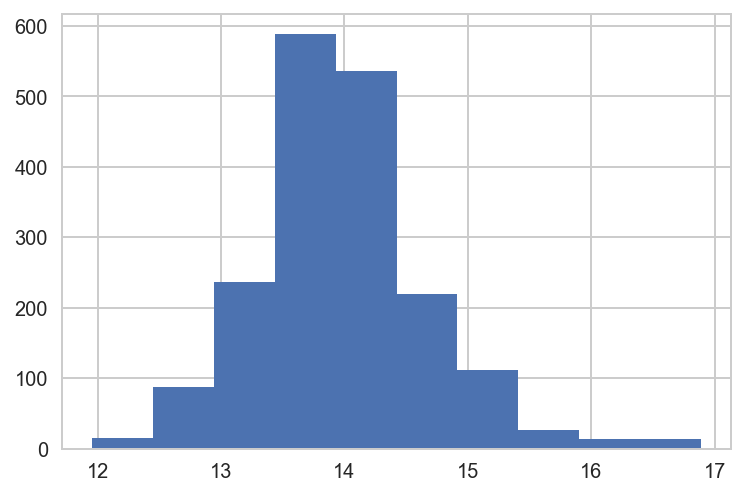

In [897]:
sns.set(style="whitegrid", color_codes=True, font_scale=1)
fig, ax = plt.subplots(figsize=(6,4))
plt.hist(y);

In [899]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state = 1, shuffle=True)

Robust Scaler removes the median and scales the data according to the quantile range (defaults to IQR: Interquartile Range). The IQR is the range between the 1st quartile (25th quantile) and the 3rd quartile (75th quantile).

### Pipelines

In [527]:
# Random Forest Regressor Pipeline and parameters
pipeline_RF = Pipeline([
    ('rfm', RandomForestRegressor()),
])
parameters_RF = {"rfm__max_depth": [3, 6, 10, 15, None],
              "rfm__max_features": ['sqrt', 'log2', None, 0.2, 0.5, 0.7],
              "rfm__min_samples_split": [2, 3, 10, 15, 20, 50, 100],
              "rfm__min_samples_leaf": [1, 3, 10, 15, 20, 50, 100],
              "rfm__bootstrap": [True, False],
                'rfm__n_estimators':[30]}

# SVR Pipeline and parameters
pipeline_LSVR = Pipeline([
    ('ss', RobustScaler()),
    ('lsvr', LinearSVR())
])

parameters_LSVR = {
'lsvr__C': np.logspace(-3, 1, 50),
'lsvr__loss': ('epsilon_insensitive', 'squared_epsilon_insensitive')}

# MLP Regressor pipeline and parameters
pipeline_MLP = Pipeline([
    ('rs', RobustScaler()),
    ('mlp', MLPRegressor(random_state=1, max_iter=800)),
])

parameters_MLP ={'mlp__hidden_layer_sizes':((50,), (75,), (100,), (150,), (200,)),
                 'mlp__solver':('sgd', 'adam'),
                 'mlp__activation':('relu', 'identity'),
                 'mlp__alpha':np.logspace(-3, 1, 10) }


#### Randon Forest Pipeline

In [528]:
gs = GridSearchCV(pipeline_RF, param_grid = parameters_RF , cv=3, n_jobs=-1, verbose=1)
gs.fit(X_train, y_train)

Fitting 3 folds for each of 2940 candidates, totalling 8820 fits


[Parallel(n_jobs=-1)]: Done  76 tasks      | elapsed:    2.2s
[Parallel(n_jobs=-1)]: Done 352 tasks      | elapsed:   14.6s
[Parallel(n_jobs=-1)]: Done 602 tasks      | elapsed:   29.1s
[Parallel(n_jobs=-1)]: Done 952 tasks      | elapsed:   50.4s
[Parallel(n_jobs=-1)]: Done 1544 tasks      | elapsed:  1.5min
[Parallel(n_jobs=-1)]: Done 2373 tasks      | elapsed:  2.4min
[Parallel(n_jobs=-1)]: Done 3130 tasks      | elapsed:  3.6min
[Parallel(n_jobs=-1)]: Done 3894 tasks      | elapsed:  4.6min
[Parallel(n_jobs=-1)]: Done 4829 tasks      | elapsed:  5.8min
[Parallel(n_jobs=-1)]: Done 5866 tasks      | elapsed:  7.3min
[Parallel(n_jobs=-1)]: Done 7003 tasks      | elapsed:  9.7min
[Parallel(n_jobs=-1)]: Done 8325 tasks      | elapsed: 12.2min
[Parallel(n_jobs=-1)]: Done 8820 out of 8820 | elapsed: 13.3min finished


GridSearchCV(cv=3, error_score='raise',
       estimator=Pipeline(memory=None,
     steps=[('rfm', RandomForestRegressor(bootstrap=True, criterion='mse', max_depth=None,
           max_features='auto', max_leaf_nodes=None,
           min_impurity_decrease=0.0, min_impurity_split=None,
           min_samples_leaf=1, min_samples_split=2,
           min_weight_fraction_leaf=0.0, n_estimators=10, n_jobs=1,
           oob_score=False, random_state=None, verbose=0, warm_start=False))]),
       fit_params=None, iid=True, n_jobs=-1,
       param_grid={'rfm__max_depth': [3, 6, 10, 15, None], 'rfm__max_features': ['sqrt', 'log2', None, 0.2, 0.5, 0.7], 'rfm__min_samples_split': [2, 3, 10, 15, 20, 50, 100], 'rfm__min_samples_leaf': [1, 3, 10, 15, 20, 50, 100], 'rfm__bootstrap': [True, False], 'rfm__n_estimators': [30]},
       pre_dispatch='2*n_jobs', refit=True, return_train_score='warn',
       scoring=None, verbose=1)

In [529]:
print('Best Model Score:', gs.best_score_)
print('Best Parameters:', gs.best_params_)
print('Accuracy Score:', gs.best_estimator_.score(X_test, y_test))

Best Model Score: 0.504227287134499
Best Parameters: {'rfm__bootstrap': True, 'rfm__max_depth': 15, 'rfm__max_features': None, 'rfm__min_samples_leaf': 1, 'rfm__min_samples_split': 3, 'rfm__n_estimators': 30}
Accuracy Score: 0.5507818307587358


In [530]:
best_rf = gs.best_estimator_
best_rf.fit(X_train, y_train)

Pipeline(memory=None,
     steps=[('rfm', RandomForestRegressor(bootstrap=True, criterion='mse', max_depth=15,
           max_features=None, max_leaf_nodes=None,
           min_impurity_decrease=0.0, min_impurity_split=None,
           min_samples_leaf=1, min_samples_split=3,
           min_weight_fraction_leaf=0.0, n_estimators=30, n_jobs=1,
           oob_score=False, random_state=None, verbose=0, warm_start=False))])

In [531]:
best_rf.steps[0]

('rfm', RandomForestRegressor(bootstrap=True, criterion='mse', max_depth=15,
            max_features=None, max_leaf_nodes=None,
            min_impurity_decrease=0.0, min_impurity_split=None,
            min_samples_leaf=1, min_samples_split=3,
            min_weight_fraction_leaf=0.0, n_estimators=30, n_jobs=1,
            oob_score=False, random_state=None, verbose=0, warm_start=False))

In [532]:
best_rf.steps[0][1].estimators_[0]

DecisionTreeRegressor(criterion='mse', max_depth=15, max_features=None,
           max_leaf_nodes=None, min_impurity_decrease=0.0,
           min_impurity_split=None, min_samples_leaf=1,
           min_samples_split=3, min_weight_fraction_leaf=0.0,
           presort=False, random_state=292134187, splitter='best')

In [533]:
dot_data = StringIO()
export_graphviz(best_rf.steps[0][1].estimators_[0], out_file=dot_data,
                feature_names=X_train.columns,
#                 class_names=best_rf[0].feature_names,
               filled=True, rounded=True,
                proportion=True,
                special_characters=True,
                node_ids=True)
graph = pydotplus.graph_from_dot_data(dot_data.getvalue())

In [534]:
Image(graph.create_png())

In [566]:
feature_im = pd.DataFrame({'importance':best_rf.steps[0][1].estimators_[0].feature_importances_, 'variable':X_test.columns})
feature_im.sort_values(by=['importance'], ascending=False).head(20)

,importance,variable
1,0.320706,languages
0,0.086753,film_date
6,0.083688,norm_unconvincing
7,0.053904,WC
48,0.032146,differ
33,0.025849,posemo
14,0.025363,Dic
15,0.022596,function
88,0.021902,Parenth
43,0.019746,insight


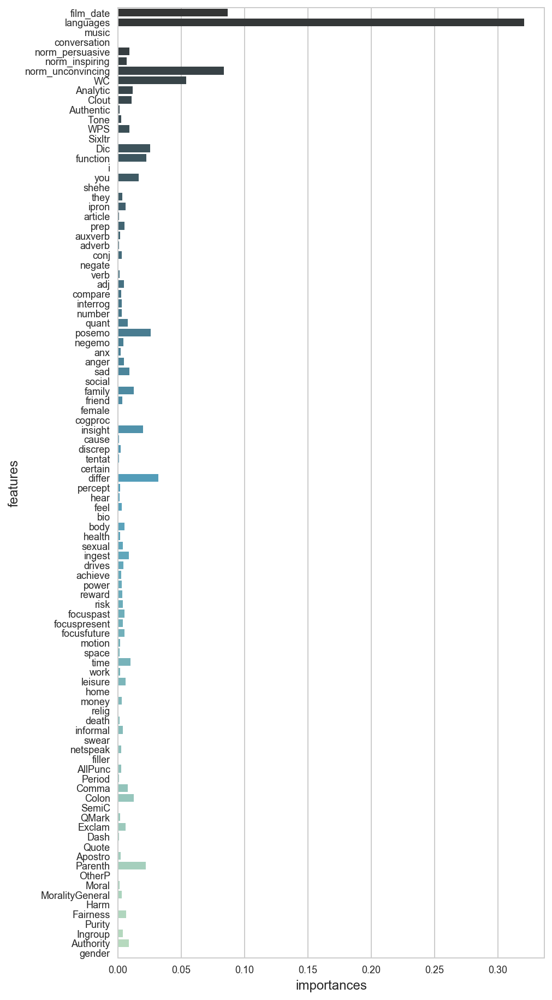

In [575]:
sns.set(style="whitegrid", color_codes=True, font_scale=0.9)
# sns.countplot(y = feature_im.index() , x = 'importance', data=feature_im, palette='GnBu_d', orient='h');
fig = plt.figure(figsize=(7,16))
ax = fig.gca()

sns.barplot(y='variable',x='importance', data=feature_im, palette='GnBu_d');
ax.set_ylabel('features', fontsize=12)
ax.set_xlabel('importances', fontsize=12);

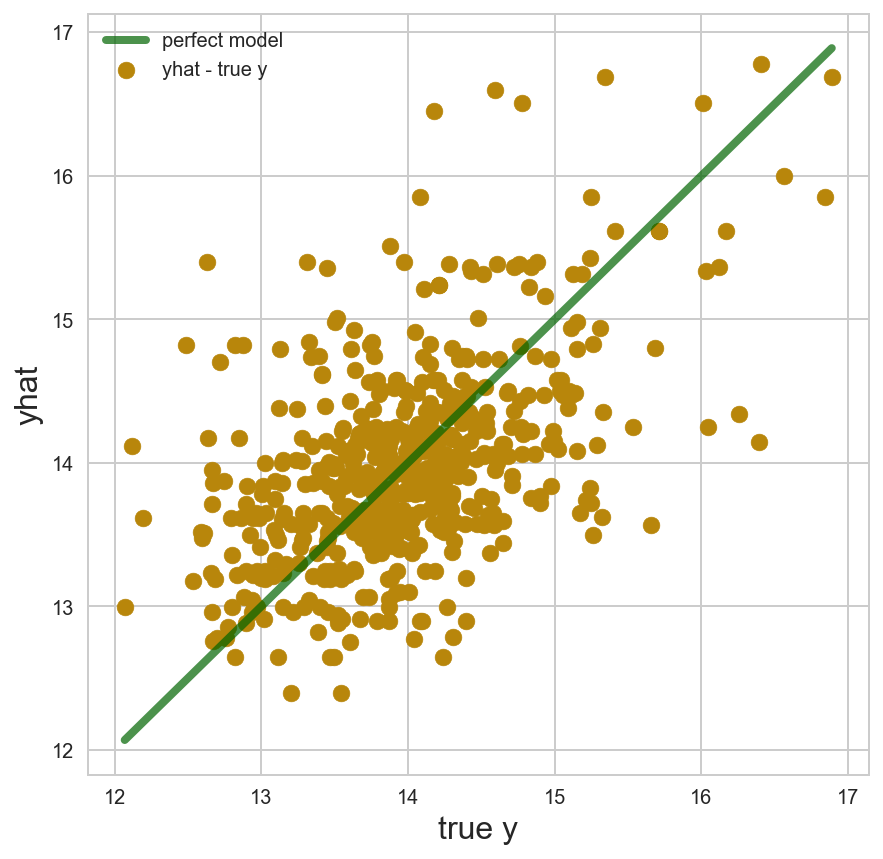

In [544]:
def plot_y_yhat(y, yhat):

    fig = plt.figure(figsize=(7,7))
    ax = fig.gca()

    ax.scatter(y, yhat, color='darkgoldenrod', s=70, label='yhat - true y')

    max_val = np.max(y)
    min_val = np.min(y)

    ax.plot([min_val, max_val], [min_val, max_val], color='darkgreen',
            linewidth=4.0, alpha=0.7, label='perfect model')

    ax.set_xlabel('true y', fontsize=16)
    ax.set_ylabel('yhat', fontsize=16)

    plt.legend(loc='upper left')

    plt.show()
    
plot_y_yhat(y_test, best_rf.steps[0][1].estimators_[0].predict(X_test))

#### LinearSVR Pipeline

In [244]:
gs_lsvr = GridSearchCV(pipeline_LSVR, param_grid = parameters_LSVR , cv=3, n_jobs=1, verbose=1)
gs_lsvr.fit(X_train, y_train)

Fitting 3 folds for each of 100 candidates, totalling 300 fits


[Parallel(n_jobs=1)]: Done 300 out of 300 | elapsed:   23.6s finished


GridSearchCV(cv=3, error_score='raise',
       estimator=Pipeline(memory=None,
     steps=[('ss', RobustScaler(copy=True, quantile_range=(25.0, 75.0), with_centering=True,
       with_scaling=True)), ('lsvr', LinearSVR(C=1.0, dual=True, epsilon=0.0, fit_intercept=True,
     intercept_scaling=1.0, loss='epsilon_insensitive', max_iter=1000,
     random_state=None, tol=0.0001, verbose=0))]),
       fit_params=None, iid=True, n_jobs=1,
       param_grid={'lsvr__C': array([1.00000e-03, 1.20679e-03, 1.45635e-03, 1.75751e-03, 2.12095e-03,
       2.55955e-03, 3.08884e-03, 3.72759e-03, 4.49843e-03, 5.42868e-03,
       6.55129e-03, 7.90604e-03, 9.54095e-03, 1.15140e-02, 1.38950e-02,
       1.67683e-02, 2.02359e-02, 2.44205e-02, 2.94705e-02, 3....0, 8.28643e+00, 1.00000e+01]), 'lsvr__loss': ('epsilon_insensitive', 'squared_epsilon_insensitive')},
       pre_dispatch='2*n_jobs', refit=True, return_train_score='warn',
       scoring=None, verbose=1)

In [245]:
print('Best Model Score:', gs_lsvr.best_score_)
print('Best Parameters:', gs_lsvr.best_params_)
print('Accuracy Score:', gs_lsvr.best_estimator_.score(X_test, y_test))

Best Model Score: 0.4249035461459765
Best Parameters: {'lsvr__C': 1.5264179671752318, 'lsvr__loss': 'squared_epsilon_insensitive'}
Accuracy Score: 0.5190170995034304


In [556]:
LSVC_coef = pd.DataFrame({'variable': X.columns, 'LSVC_coef': gs_lsvr.best_estimator_.named_steps['lsvr'].coef_, 
                          'abs_coef': np.abs(gs_lsvr.best_estimator_.named_steps['lsvr'].coef_)})
LSVC_coef.sort_values('abs_coef', ascending=False).head(20)


,LSVC_coef,abs_coef,variable
78,-1.620819,1.620819,AllPunc
90,-1.257466,1.257466,Moral
80,0.719659,0.719659,Comma
87,0.597867,0.597867,Apostro
79,0.522046,0.522046,Period
95,0.469560,0.469560,Ingroup
1,0.463001,0.463001,languages
91,0.420287,0.420287,MoralityGeneral
92,0.393598,0.393598,Harm
88,0.387356,0.387356,Parenth


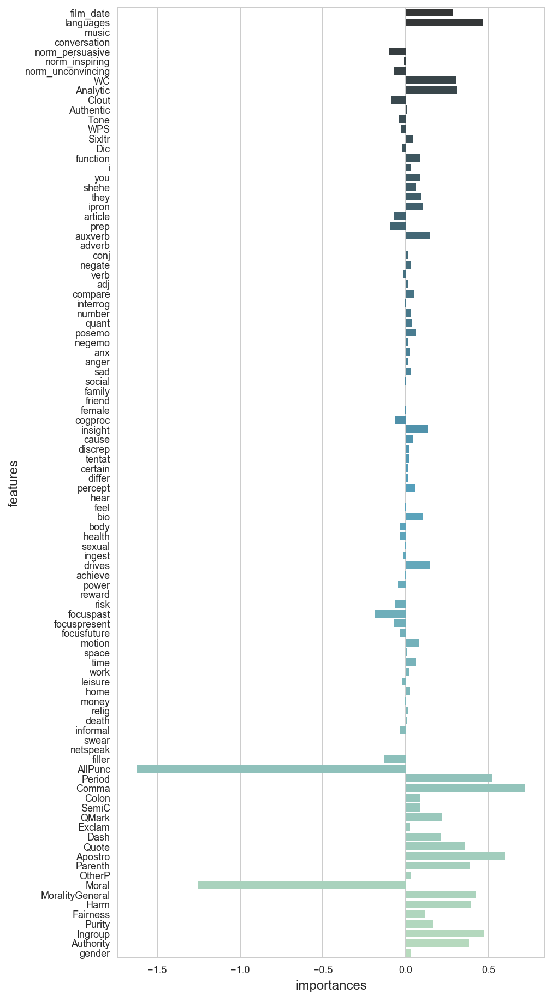

In [580]:
sns.set(style="whitegrid", color_codes=True, font_scale=0.9)
# sns.countplot(y = feature_im.index() , x = 'importance', data=feature_im, palette='GnBu_d', orient='h');
fig = plt.figure(figsize=(7,16))
ax = fig.gca()
sns.barplot(y='variable',x='LSVC_coef', data=LSVC_coef, palette='GnBu_d');
ax.set_ylabel('features', fontsize=12)
ax.set_xlabel('importances', fontsize=12);

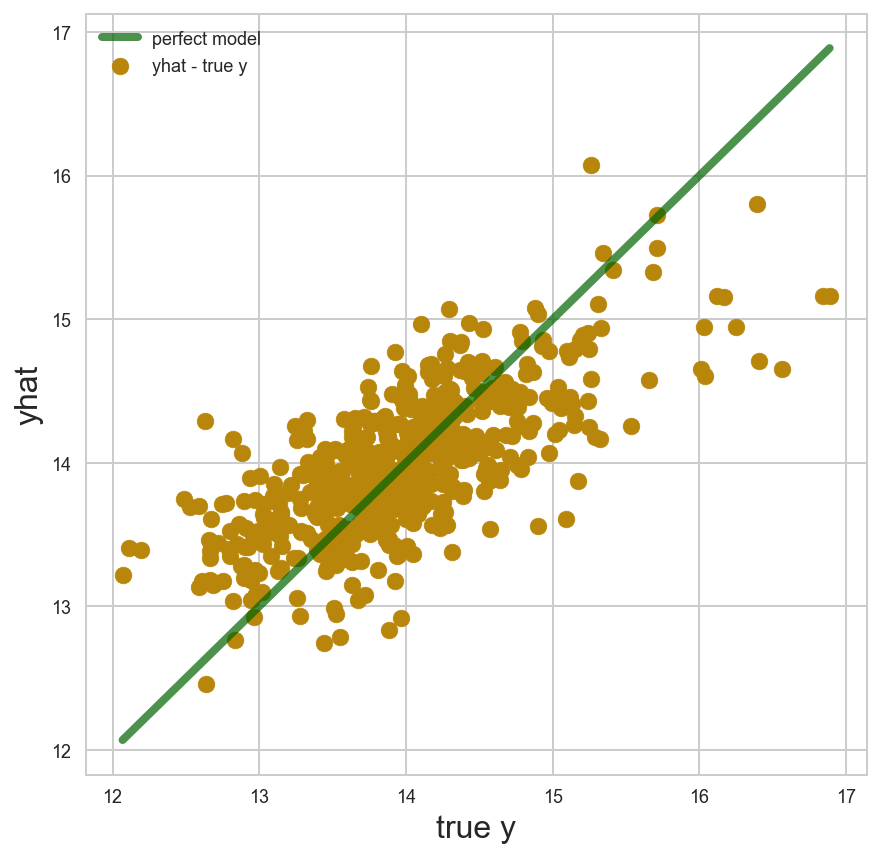

In [582]:
plot_y_yhat(y_test, gs_lsvr.best_estimator_.predict(X_test))

#### MLP Pipeline

In [257]:
gs_MLP = GridSearchCV(pipeline_MLP, param_grid = parameters_MLP , cv=3, n_jobs=1, verbose=2)
gs_MLP.fit(X_train, y_train)

Fitting 3 folds for each of 200 candidates, totalling 600 fits
[CV] mlp__activation=relu, mlp__alpha=0.001, mlp__hidden_layer_sizes=(50,), mlp__solver=sgd 
[CV]  mlp__activation=relu, mlp__alpha=0.001, mlp__hidden_layer_sizes=(50,), mlp__solver=sgd, total=   1.1s
[CV] mlp__activation=relu, mlp__alpha=0.001, mlp__hidden_layer_sizes=(50,), mlp__solver=sgd 


[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    1.1s remaining:    0.0s


[CV]  mlp__activation=relu, mlp__alpha=0.001, mlp__hidden_layer_sizes=(50,), mlp__solver=sgd, total=   1.1s
[CV] mlp__activation=relu, mlp__alpha=0.001, mlp__hidden_layer_sizes=(50,), mlp__solver=sgd 
[CV]  mlp__activation=relu, mlp__alpha=0.001, mlp__hidden_layer_sizes=(50,), mlp__solver=sgd, total=   1.1s
[CV] mlp__activation=relu, mlp__alpha=0.001, mlp__hidden_layer_sizes=(50,), mlp__solver=adam 
[CV]  mlp__activation=relu, mlp__alpha=0.001, mlp__hidden_layer_sizes=(50,), mlp__solver=adam, total=   2.0s
[CV] mlp__activation=relu, mlp__alpha=0.001, mlp__hidden_layer_sizes=(50,), mlp__solver=adam 
[CV]  mlp__activation=relu, mlp__alpha=0.001, mlp__hidden_layer_sizes=(50,), mlp__solver=adam, total=   1.8s
[CV] mlp__activation=relu, mlp__alpha=0.001, mlp__hidden_layer_sizes=(50,), mlp__solver=adam 
[CV]  mlp__activation=relu, mlp__alpha=0.001, mlp__hidden_layer_sizes=(50,), mlp__solver=adam, total=   1.6s
[CV] mlp__activation=relu, mlp__alpha=0.001, mlp__hidden_layer_sizes=(75,), mlp__s

[CV]  mlp__activation=relu, mlp__alpha=0.0027825594022071257, mlp__hidden_layer_sizes=(75,), mlp__solver=adam, total=   1.8s
[CV] mlp__activation=relu, mlp__alpha=0.0027825594022071257, mlp__hidden_layer_sizes=(75,), mlp__solver=adam 
[CV]  mlp__activation=relu, mlp__alpha=0.0027825594022071257, mlp__hidden_layer_sizes=(75,), mlp__solver=adam, total=   1.8s
[CV] mlp__activation=relu, mlp__alpha=0.0027825594022071257, mlp__hidden_layer_sizes=(100,), mlp__solver=sgd 
[CV]  mlp__activation=relu, mlp__alpha=0.0027825594022071257, mlp__hidden_layer_sizes=(100,), mlp__solver=sgd, total=   1.7s
[CV] mlp__activation=relu, mlp__alpha=0.0027825594022071257, mlp__hidden_layer_sizes=(100,), mlp__solver=sgd 
[CV]  mlp__activation=relu, mlp__alpha=0.0027825594022071257, mlp__hidden_layer_sizes=(100,), mlp__solver=sgd, total=   1.5s
[CV] mlp__activation=relu, mlp__alpha=0.0027825594022071257, mlp__hidden_layer_sizes=(100,), mlp__solver=sgd 
[CV]  mlp__activation=relu, mlp__alpha=0.0027825594022071257

[CV]  mlp__activation=relu, mlp__alpha=0.007742636826811269, mlp__hidden_layer_sizes=(100,), mlp__solver=adam, total=   1.8s
[CV] mlp__activation=relu, mlp__alpha=0.007742636826811269, mlp__hidden_layer_sizes=(100,), mlp__solver=adam 
[CV]  mlp__activation=relu, mlp__alpha=0.007742636826811269, mlp__hidden_layer_sizes=(100,), mlp__solver=adam, total=   1.7s
[CV] mlp__activation=relu, mlp__alpha=0.007742636826811269, mlp__hidden_layer_sizes=(100,), mlp__solver=adam 
[CV]  mlp__activation=relu, mlp__alpha=0.007742636826811269, mlp__hidden_layer_sizes=(100,), mlp__solver=adam, total=   1.7s
[CV] mlp__activation=relu, mlp__alpha=0.007742636826811269, mlp__hidden_layer_sizes=(150,), mlp__solver=sgd 
[CV]  mlp__activation=relu, mlp__alpha=0.007742636826811269, mlp__hidden_layer_sizes=(150,), mlp__solver=sgd, total=   1.9s
[CV] mlp__activation=relu, mlp__alpha=0.007742636826811269, mlp__hidden_layer_sizes=(150,), mlp__solver=sgd 
[CV]  mlp__activation=relu, mlp__alpha=0.007742636826811269, ml

[CV]  mlp__activation=relu, mlp__alpha=0.021544346900318832, mlp__hidden_layer_sizes=(150,), mlp__solver=adam, total=   1.9s
[CV] mlp__activation=relu, mlp__alpha=0.021544346900318832, mlp__hidden_layer_sizes=(150,), mlp__solver=adam 
[CV]  mlp__activation=relu, mlp__alpha=0.021544346900318832, mlp__hidden_layer_sizes=(150,), mlp__solver=adam, total=   1.9s
[CV] mlp__activation=relu, mlp__alpha=0.021544346900318832, mlp__hidden_layer_sizes=(150,), mlp__solver=adam 
[CV]  mlp__activation=relu, mlp__alpha=0.021544346900318832, mlp__hidden_layer_sizes=(150,), mlp__solver=adam, total=   1.8s
[CV] mlp__activation=relu, mlp__alpha=0.021544346900318832, mlp__hidden_layer_sizes=(200,), mlp__solver=sgd 
[CV]  mlp__activation=relu, mlp__alpha=0.021544346900318832, mlp__hidden_layer_sizes=(200,), mlp__solver=sgd, total=   2.3s
[CV] mlp__activation=relu, mlp__alpha=0.021544346900318832, mlp__hidden_layer_sizes=(200,), mlp__solver=sgd 
[CV]  mlp__activation=relu, mlp__alpha=0.021544346900318832, ml

[CV]  mlp__activation=relu, mlp__alpha=0.05994842503189409, mlp__hidden_layer_sizes=(200,), mlp__solver=adam, total=   2.2s
[CV] mlp__activation=relu, mlp__alpha=0.05994842503189409, mlp__hidden_layer_sizes=(200,), mlp__solver=adam 
[CV]  mlp__activation=relu, mlp__alpha=0.05994842503189409, mlp__hidden_layer_sizes=(200,), mlp__solver=adam, total=   2.2s
[CV] mlp__activation=relu, mlp__alpha=0.05994842503189409, mlp__hidden_layer_sizes=(200,), mlp__solver=adam 
[CV]  mlp__activation=relu, mlp__alpha=0.05994842503189409, mlp__hidden_layer_sizes=(200,), mlp__solver=adam, total=   2.1s
[CV] mlp__activation=relu, mlp__alpha=0.1668100537200059, mlp__hidden_layer_sizes=(50,), mlp__solver=sgd 
[CV]  mlp__activation=relu, mlp__alpha=0.1668100537200059, mlp__hidden_layer_sizes=(50,), mlp__solver=sgd, total=   1.0s
[CV] mlp__activation=relu, mlp__alpha=0.1668100537200059, mlp__hidden_layer_sizes=(50,), mlp__solver=sgd 
[CV]  mlp__activation=relu, mlp__alpha=0.1668100537200059, mlp__hidden_layer_

/anaconda3/lib/python3.6/site-packages/sklearn/neural_network/multilayer_perceptron.py:564: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (800) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


[CV]  mlp__activation=relu, mlp__alpha=0.46415888336127775, mlp__hidden_layer_sizes=(50,), mlp__solver=adam, total=   2.0s
[CV] mlp__activation=relu, mlp__alpha=0.46415888336127775, mlp__hidden_layer_sizes=(50,), mlp__solver=adam 


/anaconda3/lib/python3.6/site-packages/sklearn/neural_network/multilayer_perceptron.py:564: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (800) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


[CV]  mlp__activation=relu, mlp__alpha=0.46415888336127775, mlp__hidden_layer_sizes=(50,), mlp__solver=adam, total=   2.1s
[CV] mlp__activation=relu, mlp__alpha=0.46415888336127775, mlp__hidden_layer_sizes=(50,), mlp__solver=adam 


/anaconda3/lib/python3.6/site-packages/sklearn/neural_network/multilayer_perceptron.py:564: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (800) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


[CV]  mlp__activation=relu, mlp__alpha=0.46415888336127775, mlp__hidden_layer_sizes=(50,), mlp__solver=adam, total=   2.1s
[CV] mlp__activation=relu, mlp__alpha=0.46415888336127775, mlp__hidden_layer_sizes=(75,), mlp__solver=sgd 
[CV]  mlp__activation=relu, mlp__alpha=0.46415888336127775, mlp__hidden_layer_sizes=(75,), mlp__solver=sgd, total=   1.5s
[CV] mlp__activation=relu, mlp__alpha=0.46415888336127775, mlp__hidden_layer_sizes=(75,), mlp__solver=sgd 
[CV]  mlp__activation=relu, mlp__alpha=0.46415888336127775, mlp__hidden_layer_sizes=(75,), mlp__solver=sgd, total=   1.4s
[CV] mlp__activation=relu, mlp__alpha=0.46415888336127775, mlp__hidden_layer_sizes=(75,), mlp__solver=sgd 
[CV]  mlp__activation=relu, mlp__alpha=0.46415888336127775, mlp__hidden_layer_sizes=(75,), mlp__solver=sgd, total=   1.5s
[CV] mlp__activation=relu, mlp__alpha=0.46415888336127775, mlp__hidden_layer_sizes=(75,), mlp__solver=adam 
[CV]  mlp__activation=relu, mlp__alpha=0.46415888336127775, mlp__hidden_layer_size

/anaconda3/lib/python3.6/site-packages/sklearn/neural_network/multilayer_perceptron.py:564: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (800) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


[CV]  mlp__activation=relu, mlp__alpha=0.46415888336127775, mlp__hidden_layer_sizes=(75,), mlp__solver=adam, total=   2.4s
[CV] mlp__activation=relu, mlp__alpha=0.46415888336127775, mlp__hidden_layer_sizes=(75,), mlp__solver=adam 


/anaconda3/lib/python3.6/site-packages/sklearn/neural_network/multilayer_perceptron.py:564: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (800) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


[CV]  mlp__activation=relu, mlp__alpha=0.46415888336127775, mlp__hidden_layer_sizes=(75,), mlp__solver=adam, total=   2.4s
[CV] mlp__activation=relu, mlp__alpha=0.46415888336127775, mlp__hidden_layer_sizes=(100,), mlp__solver=sgd 
[CV]  mlp__activation=relu, mlp__alpha=0.46415888336127775, mlp__hidden_layer_sizes=(100,), mlp__solver=sgd, total=   1.8s
[CV] mlp__activation=relu, mlp__alpha=0.46415888336127775, mlp__hidden_layer_sizes=(100,), mlp__solver=sgd 
[CV]  mlp__activation=relu, mlp__alpha=0.46415888336127775, mlp__hidden_layer_sizes=(100,), mlp__solver=sgd, total=   1.9s
[CV] mlp__activation=relu, mlp__alpha=0.46415888336127775, mlp__hidden_layer_sizes=(100,), mlp__solver=sgd 
[CV]  mlp__activation=relu, mlp__alpha=0.46415888336127775, mlp__hidden_layer_sizes=(100,), mlp__solver=sgd, total=   1.8s
[CV] mlp__activation=relu, mlp__alpha=0.46415888336127775, mlp__hidden_layer_sizes=(100,), mlp__solver=adam 


/anaconda3/lib/python3.6/site-packages/sklearn/neural_network/multilayer_perceptron.py:564: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (800) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


[CV]  mlp__activation=relu, mlp__alpha=0.46415888336127775, mlp__hidden_layer_sizes=(100,), mlp__solver=adam, total=   2.8s
[CV] mlp__activation=relu, mlp__alpha=0.46415888336127775, mlp__hidden_layer_sizes=(100,), mlp__solver=adam 


/anaconda3/lib/python3.6/site-packages/sklearn/neural_network/multilayer_perceptron.py:564: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (800) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


[CV]  mlp__activation=relu, mlp__alpha=0.46415888336127775, mlp__hidden_layer_sizes=(100,), mlp__solver=adam, total=   2.8s
[CV] mlp__activation=relu, mlp__alpha=0.46415888336127775, mlp__hidden_layer_sizes=(100,), mlp__solver=adam 


/anaconda3/lib/python3.6/site-packages/sklearn/neural_network/multilayer_perceptron.py:564: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (800) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


[CV]  mlp__activation=relu, mlp__alpha=0.46415888336127775, mlp__hidden_layer_sizes=(100,), mlp__solver=adam, total=   2.8s
[CV] mlp__activation=relu, mlp__alpha=0.46415888336127775, mlp__hidden_layer_sizes=(150,), mlp__solver=sgd 
[CV]  mlp__activation=relu, mlp__alpha=0.46415888336127775, mlp__hidden_layer_sizes=(150,), mlp__solver=sgd, total=   2.2s
[CV] mlp__activation=relu, mlp__alpha=0.46415888336127775, mlp__hidden_layer_sizes=(150,), mlp__solver=sgd 
[CV]  mlp__activation=relu, mlp__alpha=0.46415888336127775, mlp__hidden_layer_sizes=(150,), mlp__solver=sgd, total=   1.9s
[CV] mlp__activation=relu, mlp__alpha=0.46415888336127775, mlp__hidden_layer_sizes=(150,), mlp__solver=sgd 
[CV]  mlp__activation=relu, mlp__alpha=0.46415888336127775, mlp__hidden_layer_sizes=(150,), mlp__solver=sgd, total=   2.0s
[CV] mlp__activation=relu, mlp__alpha=0.46415888336127775, mlp__hidden_layer_sizes=(150,), mlp__solver=adam 


/anaconda3/lib/python3.6/site-packages/sklearn/neural_network/multilayer_perceptron.py:564: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (800) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


[CV]  mlp__activation=relu, mlp__alpha=0.46415888336127775, mlp__hidden_layer_sizes=(150,), mlp__solver=adam, total=   3.4s
[CV] mlp__activation=relu, mlp__alpha=0.46415888336127775, mlp__hidden_layer_sizes=(150,), mlp__solver=adam 


/anaconda3/lib/python3.6/site-packages/sklearn/neural_network/multilayer_perceptron.py:564: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (800) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


[CV]  mlp__activation=relu, mlp__alpha=0.46415888336127775, mlp__hidden_layer_sizes=(150,), mlp__solver=adam, total=   4.1s
[CV] mlp__activation=relu, mlp__alpha=0.46415888336127775, mlp__hidden_layer_sizes=(150,), mlp__solver=adam 
[CV]  mlp__activation=relu, mlp__alpha=0.46415888336127775, mlp__hidden_layer_sizes=(150,), mlp__solver=adam, total=   4.2s
[CV] mlp__activation=relu, mlp__alpha=0.46415888336127775, mlp__hidden_layer_sizes=(200,), mlp__solver=sgd 
[CV]  mlp__activation=relu, mlp__alpha=0.46415888336127775, mlp__hidden_layer_sizes=(200,), mlp__solver=sgd, total=   3.4s
[CV] mlp__activation=relu, mlp__alpha=0.46415888336127775, mlp__hidden_layer_sizes=(200,), mlp__solver=sgd 
[CV]  mlp__activation=relu, mlp__alpha=0.46415888336127775, mlp__hidden_layer_sizes=(200,), mlp__solver=sgd, total=   3.3s
[CV] mlp__activation=relu, mlp__alpha=0.46415888336127775, mlp__hidden_layer_sizes=(200,), mlp__solver=sgd 
[CV]  mlp__activation=relu, mlp__alpha=0.46415888336127775, mlp__hidden_l

/anaconda3/lib/python3.6/site-packages/sklearn/neural_network/multilayer_perceptron.py:564: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (800) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


[CV]  mlp__activation=relu, mlp__alpha=0.46415888336127775, mlp__hidden_layer_sizes=(200,), mlp__solver=adam, total=   4.5s
[CV] mlp__activation=relu, mlp__alpha=1.2915496650148828, mlp__hidden_layer_sizes=(50,), mlp__solver=sgd 


/anaconda3/lib/python3.6/site-packages/sklearn/neural_network/multilayer_perceptron.py:564: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (800) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


[CV]  mlp__activation=relu, mlp__alpha=1.2915496650148828, mlp__hidden_layer_sizes=(50,), mlp__solver=sgd, total=   1.8s
[CV] mlp__activation=relu, mlp__alpha=1.2915496650148828, mlp__hidden_layer_sizes=(50,), mlp__solver=sgd 


/anaconda3/lib/python3.6/site-packages/sklearn/neural_network/multilayer_perceptron.py:564: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (800) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


[CV]  mlp__activation=relu, mlp__alpha=1.2915496650148828, mlp__hidden_layer_sizes=(50,), mlp__solver=sgd, total=   1.8s
[CV] mlp__activation=relu, mlp__alpha=1.2915496650148828, mlp__hidden_layer_sizes=(50,), mlp__solver=sgd 


/anaconda3/lib/python3.6/site-packages/sklearn/neural_network/multilayer_perceptron.py:564: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (800) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


[CV]  mlp__activation=relu, mlp__alpha=1.2915496650148828, mlp__hidden_layer_sizes=(50,), mlp__solver=sgd, total=   1.8s
[CV] mlp__activation=relu, mlp__alpha=1.2915496650148828, mlp__hidden_layer_sizes=(50,), mlp__solver=adam 


/anaconda3/lib/python3.6/site-packages/sklearn/neural_network/multilayer_perceptron.py:564: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (800) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


[CV]  mlp__activation=relu, mlp__alpha=1.2915496650148828, mlp__hidden_layer_sizes=(50,), mlp__solver=adam, total=   2.1s
[CV] mlp__activation=relu, mlp__alpha=1.2915496650148828, mlp__hidden_layer_sizes=(50,), mlp__solver=adam 


/anaconda3/lib/python3.6/site-packages/sklearn/neural_network/multilayer_perceptron.py:564: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (800) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


[CV]  mlp__activation=relu, mlp__alpha=1.2915496650148828, mlp__hidden_layer_sizes=(50,), mlp__solver=adam, total=   2.1s
[CV] mlp__activation=relu, mlp__alpha=1.2915496650148828, mlp__hidden_layer_sizes=(50,), mlp__solver=adam 


/anaconda3/lib/python3.6/site-packages/sklearn/neural_network/multilayer_perceptron.py:564: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (800) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


[CV]  mlp__activation=relu, mlp__alpha=1.2915496650148828, mlp__hidden_layer_sizes=(50,), mlp__solver=adam, total=   2.1s
[CV] mlp__activation=relu, mlp__alpha=1.2915496650148828, mlp__hidden_layer_sizes=(75,), mlp__solver=sgd 


/anaconda3/lib/python3.6/site-packages/sklearn/neural_network/multilayer_perceptron.py:564: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (800) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


[CV]  mlp__activation=relu, mlp__alpha=1.2915496650148828, mlp__hidden_layer_sizes=(75,), mlp__solver=sgd, total=   2.2s
[CV] mlp__activation=relu, mlp__alpha=1.2915496650148828, mlp__hidden_layer_sizes=(75,), mlp__solver=sgd 


/anaconda3/lib/python3.6/site-packages/sklearn/neural_network/multilayer_perceptron.py:564: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (800) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


[CV]  mlp__activation=relu, mlp__alpha=1.2915496650148828, mlp__hidden_layer_sizes=(75,), mlp__solver=sgd, total=   2.3s
[CV] mlp__activation=relu, mlp__alpha=1.2915496650148828, mlp__hidden_layer_sizes=(75,), mlp__solver=sgd 


/anaconda3/lib/python3.6/site-packages/sklearn/neural_network/multilayer_perceptron.py:564: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (800) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


[CV]  mlp__activation=relu, mlp__alpha=1.2915496650148828, mlp__hidden_layer_sizes=(75,), mlp__solver=sgd, total=   2.4s
[CV] mlp__activation=relu, mlp__alpha=1.2915496650148828, mlp__hidden_layer_sizes=(75,), mlp__solver=adam 
[CV]  mlp__activation=relu, mlp__alpha=1.2915496650148828, mlp__hidden_layer_sizes=(75,), mlp__solver=adam, total=   2.6s
[CV] mlp__activation=relu, mlp__alpha=1.2915496650148828, mlp__hidden_layer_sizes=(75,), mlp__solver=adam 


/anaconda3/lib/python3.6/site-packages/sklearn/neural_network/multilayer_perceptron.py:564: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (800) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


[CV]  mlp__activation=relu, mlp__alpha=1.2915496650148828, mlp__hidden_layer_sizes=(75,), mlp__solver=adam, total=   2.4s
[CV] mlp__activation=relu, mlp__alpha=1.2915496650148828, mlp__hidden_layer_sizes=(75,), mlp__solver=adam 


/anaconda3/lib/python3.6/site-packages/sklearn/neural_network/multilayer_perceptron.py:564: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (800) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


[CV]  mlp__activation=relu, mlp__alpha=1.2915496650148828, mlp__hidden_layer_sizes=(75,), mlp__solver=adam, total=   2.4s
[CV] mlp__activation=relu, mlp__alpha=1.2915496650148828, mlp__hidden_layer_sizes=(100,), mlp__solver=sgd 


/anaconda3/lib/python3.6/site-packages/sklearn/neural_network/multilayer_perceptron.py:564: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (800) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


[CV]  mlp__activation=relu, mlp__alpha=1.2915496650148828, mlp__hidden_layer_sizes=(100,), mlp__solver=sgd, total=   2.6s
[CV] mlp__activation=relu, mlp__alpha=1.2915496650148828, mlp__hidden_layer_sizes=(100,), mlp__solver=sgd 


/anaconda3/lib/python3.6/site-packages/sklearn/neural_network/multilayer_perceptron.py:564: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (800) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


[CV]  mlp__activation=relu, mlp__alpha=1.2915496650148828, mlp__hidden_layer_sizes=(100,), mlp__solver=sgd, total=   2.6s
[CV] mlp__activation=relu, mlp__alpha=1.2915496650148828, mlp__hidden_layer_sizes=(100,), mlp__solver=sgd 


/anaconda3/lib/python3.6/site-packages/sklearn/neural_network/multilayer_perceptron.py:564: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (800) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


[CV]  mlp__activation=relu, mlp__alpha=1.2915496650148828, mlp__hidden_layer_sizes=(100,), mlp__solver=sgd, total=   2.6s
[CV] mlp__activation=relu, mlp__alpha=1.2915496650148828, mlp__hidden_layer_sizes=(100,), mlp__solver=adam 
[CV]  mlp__activation=relu, mlp__alpha=1.2915496650148828, mlp__hidden_layer_sizes=(100,), mlp__solver=adam, total=   2.6s
[CV] mlp__activation=relu, mlp__alpha=1.2915496650148828, mlp__hidden_layer_sizes=(100,), mlp__solver=adam 
[CV]  mlp__activation=relu, mlp__alpha=1.2915496650148828, mlp__hidden_layer_sizes=(100,), mlp__solver=adam, total=   2.3s
[CV] mlp__activation=relu, mlp__alpha=1.2915496650148828, mlp__hidden_layer_sizes=(100,), mlp__solver=adam 
[CV]  mlp__activation=relu, mlp__alpha=1.2915496650148828, mlp__hidden_layer_sizes=(100,), mlp__solver=adam, total=   2.5s
[CV] mlp__activation=relu, mlp__alpha=1.2915496650148828, mlp__hidden_layer_sizes=(150,), mlp__solver=sgd 


/anaconda3/lib/python3.6/site-packages/sklearn/neural_network/multilayer_perceptron.py:564: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (800) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


[CV]  mlp__activation=relu, mlp__alpha=1.2915496650148828, mlp__hidden_layer_sizes=(150,), mlp__solver=sgd, total=   3.0s
[CV] mlp__activation=relu, mlp__alpha=1.2915496650148828, mlp__hidden_layer_sizes=(150,), mlp__solver=sgd 


/anaconda3/lib/python3.6/site-packages/sklearn/neural_network/multilayer_perceptron.py:564: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (800) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


[CV]  mlp__activation=relu, mlp__alpha=1.2915496650148828, mlp__hidden_layer_sizes=(150,), mlp__solver=sgd, total=   3.1s
[CV] mlp__activation=relu, mlp__alpha=1.2915496650148828, mlp__hidden_layer_sizes=(150,), mlp__solver=sgd 


/anaconda3/lib/python3.6/site-packages/sklearn/neural_network/multilayer_perceptron.py:564: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (800) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


[CV]  mlp__activation=relu, mlp__alpha=1.2915496650148828, mlp__hidden_layer_sizes=(150,), mlp__solver=sgd, total=   3.1s
[CV] mlp__activation=relu, mlp__alpha=1.2915496650148828, mlp__hidden_layer_sizes=(150,), mlp__solver=adam 
[CV]  mlp__activation=relu, mlp__alpha=1.2915496650148828, mlp__hidden_layer_sizes=(150,), mlp__solver=adam, total=   3.1s
[CV] mlp__activation=relu, mlp__alpha=1.2915496650148828, mlp__hidden_layer_sizes=(150,), mlp__solver=adam 
[CV]  mlp__activation=relu, mlp__alpha=1.2915496650148828, mlp__hidden_layer_sizes=(150,), mlp__solver=adam, total=   2.9s
[CV] mlp__activation=relu, mlp__alpha=1.2915496650148828, mlp__hidden_layer_sizes=(150,), mlp__solver=adam 
[CV]  mlp__activation=relu, mlp__alpha=1.2915496650148828, mlp__hidden_layer_sizes=(150,), mlp__solver=adam, total=   3.0s
[CV] mlp__activation=relu, mlp__alpha=1.2915496650148828, mlp__hidden_layer_sizes=(200,), mlp__solver=sgd 


/anaconda3/lib/python3.6/site-packages/sklearn/neural_network/multilayer_perceptron.py:564: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (800) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


[CV]  mlp__activation=relu, mlp__alpha=1.2915496650148828, mlp__hidden_layer_sizes=(200,), mlp__solver=sgd, total=   3.9s
[CV] mlp__activation=relu, mlp__alpha=1.2915496650148828, mlp__hidden_layer_sizes=(200,), mlp__solver=sgd 


/anaconda3/lib/python3.6/site-packages/sklearn/neural_network/multilayer_perceptron.py:564: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (800) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


[CV]  mlp__activation=relu, mlp__alpha=1.2915496650148828, mlp__hidden_layer_sizes=(200,), mlp__solver=sgd, total=   3.9s
[CV] mlp__activation=relu, mlp__alpha=1.2915496650148828, mlp__hidden_layer_sizes=(200,), mlp__solver=sgd 


/anaconda3/lib/python3.6/site-packages/sklearn/neural_network/multilayer_perceptron.py:564: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (800) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


[CV]  mlp__activation=relu, mlp__alpha=1.2915496650148828, mlp__hidden_layer_sizes=(200,), mlp__solver=sgd, total=   4.0s
[CV] mlp__activation=relu, mlp__alpha=1.2915496650148828, mlp__hidden_layer_sizes=(200,), mlp__solver=adam 
[CV]  mlp__activation=relu, mlp__alpha=1.2915496650148828, mlp__hidden_layer_sizes=(200,), mlp__solver=adam, total=   3.4s
[CV] mlp__activation=relu, mlp__alpha=1.2915496650148828, mlp__hidden_layer_sizes=(200,), mlp__solver=adam 
[CV]  mlp__activation=relu, mlp__alpha=1.2915496650148828, mlp__hidden_layer_sizes=(200,), mlp__solver=adam, total=   3.5s
[CV] mlp__activation=relu, mlp__alpha=1.2915496650148828, mlp__hidden_layer_sizes=(200,), mlp__solver=adam 
[CV]  mlp__activation=relu, mlp__alpha=1.2915496650148828, mlp__hidden_layer_sizes=(200,), mlp__solver=adam, total=   3.4s
[CV] mlp__activation=relu, mlp__alpha=3.593813663804626, mlp__hidden_layer_sizes=(50,), mlp__solver=sgd 


/anaconda3/lib/python3.6/site-packages/sklearn/neural_network/multilayer_perceptron.py:564: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (800) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


[CV]  mlp__activation=relu, mlp__alpha=3.593813663804626, mlp__hidden_layer_sizes=(50,), mlp__solver=sgd, total=   1.7s
[CV] mlp__activation=relu, mlp__alpha=3.593813663804626, mlp__hidden_layer_sizes=(50,), mlp__solver=sgd 


/anaconda3/lib/python3.6/site-packages/sklearn/neural_network/multilayer_perceptron.py:564: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (800) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


[CV]  mlp__activation=relu, mlp__alpha=3.593813663804626, mlp__hidden_layer_sizes=(50,), mlp__solver=sgd, total=   1.7s
[CV] mlp__activation=relu, mlp__alpha=3.593813663804626, mlp__hidden_layer_sizes=(50,), mlp__solver=sgd 


/anaconda3/lib/python3.6/site-packages/sklearn/neural_network/multilayer_perceptron.py:564: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (800) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


[CV]  mlp__activation=relu, mlp__alpha=3.593813663804626, mlp__hidden_layer_sizes=(50,), mlp__solver=sgd, total=   1.7s
[CV] mlp__activation=relu, mlp__alpha=3.593813663804626, mlp__hidden_layer_sizes=(50,), mlp__solver=adam 
[CV]  mlp__activation=relu, mlp__alpha=3.593813663804626, mlp__hidden_layer_sizes=(50,), mlp__solver=adam, total=   1.7s
[CV] mlp__activation=relu, mlp__alpha=3.593813663804626, mlp__hidden_layer_sizes=(50,), mlp__solver=adam 
[CV]  mlp__activation=relu, mlp__alpha=3.593813663804626, mlp__hidden_layer_sizes=(50,), mlp__solver=adam, total=   1.9s
[CV] mlp__activation=relu, mlp__alpha=3.593813663804626, mlp__hidden_layer_sizes=(50,), mlp__solver=adam 
[CV]  mlp__activation=relu, mlp__alpha=3.593813663804626, mlp__hidden_layer_sizes=(50,), mlp__solver=adam, total=   1.7s
[CV] mlp__activation=relu, mlp__alpha=3.593813663804626, mlp__hidden_layer_sizes=(75,), mlp__solver=sgd 


/anaconda3/lib/python3.6/site-packages/sklearn/neural_network/multilayer_perceptron.py:564: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (800) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


[CV]  mlp__activation=relu, mlp__alpha=3.593813663804626, mlp__hidden_layer_sizes=(75,), mlp__solver=sgd, total=   2.3s
[CV] mlp__activation=relu, mlp__alpha=3.593813663804626, mlp__hidden_layer_sizes=(75,), mlp__solver=sgd 


/anaconda3/lib/python3.6/site-packages/sklearn/neural_network/multilayer_perceptron.py:564: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (800) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


[CV]  mlp__activation=relu, mlp__alpha=3.593813663804626, mlp__hidden_layer_sizes=(75,), mlp__solver=sgd, total=   2.2s
[CV] mlp__activation=relu, mlp__alpha=3.593813663804626, mlp__hidden_layer_sizes=(75,), mlp__solver=sgd 


/anaconda3/lib/python3.6/site-packages/sklearn/neural_network/multilayer_perceptron.py:564: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (800) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


[CV]  mlp__activation=relu, mlp__alpha=3.593813663804626, mlp__hidden_layer_sizes=(75,), mlp__solver=sgd, total=   2.2s
[CV] mlp__activation=relu, mlp__alpha=3.593813663804626, mlp__hidden_layer_sizes=(75,), mlp__solver=adam 
[CV]  mlp__activation=relu, mlp__alpha=3.593813663804626, mlp__hidden_layer_sizes=(75,), mlp__solver=adam, total=   2.0s
[CV] mlp__activation=relu, mlp__alpha=3.593813663804626, mlp__hidden_layer_sizes=(75,), mlp__solver=adam 
[CV]  mlp__activation=relu, mlp__alpha=3.593813663804626, mlp__hidden_layer_sizes=(75,), mlp__solver=adam, total=   2.2s
[CV] mlp__activation=relu, mlp__alpha=3.593813663804626, mlp__hidden_layer_sizes=(75,), mlp__solver=adam 
[CV]  mlp__activation=relu, mlp__alpha=3.593813663804626, mlp__hidden_layer_sizes=(75,), mlp__solver=adam, total=   2.0s
[CV] mlp__activation=relu, mlp__alpha=3.593813663804626, mlp__hidden_layer_sizes=(100,), mlp__solver=sgd 


/anaconda3/lib/python3.6/site-packages/sklearn/neural_network/multilayer_perceptron.py:564: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (800) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


[CV]  mlp__activation=relu, mlp__alpha=3.593813663804626, mlp__hidden_layer_sizes=(100,), mlp__solver=sgd, total=   2.8s
[CV] mlp__activation=relu, mlp__alpha=3.593813663804626, mlp__hidden_layer_sizes=(100,), mlp__solver=sgd 


/anaconda3/lib/python3.6/site-packages/sklearn/neural_network/multilayer_perceptron.py:564: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (800) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


[CV]  mlp__activation=relu, mlp__alpha=3.593813663804626, mlp__hidden_layer_sizes=(100,), mlp__solver=sgd, total=   2.5s
[CV] mlp__activation=relu, mlp__alpha=3.593813663804626, mlp__hidden_layer_sizes=(100,), mlp__solver=sgd 


/anaconda3/lib/python3.6/site-packages/sklearn/neural_network/multilayer_perceptron.py:564: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (800) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


[CV]  mlp__activation=relu, mlp__alpha=3.593813663804626, mlp__hidden_layer_sizes=(100,), mlp__solver=sgd, total=   2.6s
[CV] mlp__activation=relu, mlp__alpha=3.593813663804626, mlp__hidden_layer_sizes=(100,), mlp__solver=adam 
[CV]  mlp__activation=relu, mlp__alpha=3.593813663804626, mlp__hidden_layer_sizes=(100,), mlp__solver=adam, total=   1.9s
[CV] mlp__activation=relu, mlp__alpha=3.593813663804626, mlp__hidden_layer_sizes=(100,), mlp__solver=adam 
[CV]  mlp__activation=relu, mlp__alpha=3.593813663804626, mlp__hidden_layer_sizes=(100,), mlp__solver=adam, total=   2.3s
[CV] mlp__activation=relu, mlp__alpha=3.593813663804626, mlp__hidden_layer_sizes=(100,), mlp__solver=adam 
[CV]  mlp__activation=relu, mlp__alpha=3.593813663804626, mlp__hidden_layer_sizes=(100,), mlp__solver=adam, total=   2.0s
[CV] mlp__activation=relu, mlp__alpha=3.593813663804626, mlp__hidden_layer_sizes=(150,), mlp__solver=sgd 


/anaconda3/lib/python3.6/site-packages/sklearn/neural_network/multilayer_perceptron.py:564: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (800) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


[CV]  mlp__activation=relu, mlp__alpha=3.593813663804626, mlp__hidden_layer_sizes=(150,), mlp__solver=sgd, total=   3.1s
[CV] mlp__activation=relu, mlp__alpha=3.593813663804626, mlp__hidden_layer_sizes=(150,), mlp__solver=sgd 


/anaconda3/lib/python3.6/site-packages/sklearn/neural_network/multilayer_perceptron.py:564: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (800) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


[CV]  mlp__activation=relu, mlp__alpha=3.593813663804626, mlp__hidden_layer_sizes=(150,), mlp__solver=sgd, total=   3.3s
[CV] mlp__activation=relu, mlp__alpha=3.593813663804626, mlp__hidden_layer_sizes=(150,), mlp__solver=sgd 


/anaconda3/lib/python3.6/site-packages/sklearn/neural_network/multilayer_perceptron.py:564: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (800) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


[CV]  mlp__activation=relu, mlp__alpha=3.593813663804626, mlp__hidden_layer_sizes=(150,), mlp__solver=sgd, total=   3.1s
[CV] mlp__activation=relu, mlp__alpha=3.593813663804626, mlp__hidden_layer_sizes=(150,), mlp__solver=adam 
[CV]  mlp__activation=relu, mlp__alpha=3.593813663804626, mlp__hidden_layer_sizes=(150,), mlp__solver=adam, total=   2.4s
[CV] mlp__activation=relu, mlp__alpha=3.593813663804626, mlp__hidden_layer_sizes=(150,), mlp__solver=adam 
[CV]  mlp__activation=relu, mlp__alpha=3.593813663804626, mlp__hidden_layer_sizes=(150,), mlp__solver=adam, total=   2.4s
[CV] mlp__activation=relu, mlp__alpha=3.593813663804626, mlp__hidden_layer_sizes=(150,), mlp__solver=adam 
[CV]  mlp__activation=relu, mlp__alpha=3.593813663804626, mlp__hidden_layer_sizes=(150,), mlp__solver=adam, total=   2.4s
[CV] mlp__activation=relu, mlp__alpha=3.593813663804626, mlp__hidden_layer_sizes=(200,), mlp__solver=sgd 


/anaconda3/lib/python3.6/site-packages/sklearn/neural_network/multilayer_perceptron.py:564: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (800) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


[CV]  mlp__activation=relu, mlp__alpha=3.593813663804626, mlp__hidden_layer_sizes=(200,), mlp__solver=sgd, total=   3.9s
[CV] mlp__activation=relu, mlp__alpha=3.593813663804626, mlp__hidden_layer_sizes=(200,), mlp__solver=sgd 


/anaconda3/lib/python3.6/site-packages/sklearn/neural_network/multilayer_perceptron.py:564: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (800) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


[CV]  mlp__activation=relu, mlp__alpha=3.593813663804626, mlp__hidden_layer_sizes=(200,), mlp__solver=sgd, total=   4.0s
[CV] mlp__activation=relu, mlp__alpha=3.593813663804626, mlp__hidden_layer_sizes=(200,), mlp__solver=sgd 


/anaconda3/lib/python3.6/site-packages/sklearn/neural_network/multilayer_perceptron.py:564: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (800) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


[CV]  mlp__activation=relu, mlp__alpha=3.593813663804626, mlp__hidden_layer_sizes=(200,), mlp__solver=sgd, total=   4.0s
[CV] mlp__activation=relu, mlp__alpha=3.593813663804626, mlp__hidden_layer_sizes=(200,), mlp__solver=adam 
[CV]  mlp__activation=relu, mlp__alpha=3.593813663804626, mlp__hidden_layer_sizes=(200,), mlp__solver=adam, total=   2.6s
[CV] mlp__activation=relu, mlp__alpha=3.593813663804626, mlp__hidden_layer_sizes=(200,), mlp__solver=adam 
[CV]  mlp__activation=relu, mlp__alpha=3.593813663804626, mlp__hidden_layer_sizes=(200,), mlp__solver=adam, total=   2.7s
[CV] mlp__activation=relu, mlp__alpha=3.593813663804626, mlp__hidden_layer_sizes=(200,), mlp__solver=adam 
[CV]  mlp__activation=relu, mlp__alpha=3.593813663804626, mlp__hidden_layer_sizes=(200,), mlp__solver=adam, total=   2.4s
[CV] mlp__activation=relu, mlp__alpha=10.0, mlp__hidden_layer_sizes=(50,), mlp__solver=sgd 


/anaconda3/lib/python3.6/site-packages/sklearn/neural_network/multilayer_perceptron.py:564: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (800) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


[CV]  mlp__activation=relu, mlp__alpha=10.0, mlp__hidden_layer_sizes=(50,), mlp__solver=sgd, total=   1.7s
[CV] mlp__activation=relu, mlp__alpha=10.0, mlp__hidden_layer_sizes=(50,), mlp__solver=sgd 


/anaconda3/lib/python3.6/site-packages/sklearn/neural_network/multilayer_perceptron.py:564: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (800) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


[CV]  mlp__activation=relu, mlp__alpha=10.0, mlp__hidden_layer_sizes=(50,), mlp__solver=sgd, total=   1.7s
[CV] mlp__activation=relu, mlp__alpha=10.0, mlp__hidden_layer_sizes=(50,), mlp__solver=sgd 


/anaconda3/lib/python3.6/site-packages/sklearn/neural_network/multilayer_perceptron.py:564: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (800) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


[CV]  mlp__activation=relu, mlp__alpha=10.0, mlp__hidden_layer_sizes=(50,), mlp__solver=sgd, total=   1.7s
[CV] mlp__activation=relu, mlp__alpha=10.0, mlp__hidden_layer_sizes=(50,), mlp__solver=adam 
[CV]  mlp__activation=relu, mlp__alpha=10.0, mlp__hidden_layer_sizes=(50,), mlp__solver=adam, total=   1.5s
[CV] mlp__activation=relu, mlp__alpha=10.0, mlp__hidden_layer_sizes=(50,), mlp__solver=adam 
[CV]  mlp__activation=relu, mlp__alpha=10.0, mlp__hidden_layer_sizes=(50,), mlp__solver=adam, total=   1.4s
[CV] mlp__activation=relu, mlp__alpha=10.0, mlp__hidden_layer_sizes=(50,), mlp__solver=adam 
[CV]  mlp__activation=relu, mlp__alpha=10.0, mlp__hidden_layer_sizes=(50,), mlp__solver=adam, total=   1.5s
[CV] mlp__activation=relu, mlp__alpha=10.0, mlp__hidden_layer_sizes=(75,), mlp__solver=sgd 


/anaconda3/lib/python3.6/site-packages/sklearn/neural_network/multilayer_perceptron.py:564: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (800) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


[CV]  mlp__activation=relu, mlp__alpha=10.0, mlp__hidden_layer_sizes=(75,), mlp__solver=sgd, total=   2.2s
[CV] mlp__activation=relu, mlp__alpha=10.0, mlp__hidden_layer_sizes=(75,), mlp__solver=sgd 


/anaconda3/lib/python3.6/site-packages/sklearn/neural_network/multilayer_perceptron.py:564: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (800) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


[CV]  mlp__activation=relu, mlp__alpha=10.0, mlp__hidden_layer_sizes=(75,), mlp__solver=sgd, total=   2.2s
[CV] mlp__activation=relu, mlp__alpha=10.0, mlp__hidden_layer_sizes=(75,), mlp__solver=sgd 


/anaconda3/lib/python3.6/site-packages/sklearn/neural_network/multilayer_perceptron.py:564: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (800) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


[CV]  mlp__activation=relu, mlp__alpha=10.0, mlp__hidden_layer_sizes=(75,), mlp__solver=sgd, total=   2.2s
[CV] mlp__activation=relu, mlp__alpha=10.0, mlp__hidden_layer_sizes=(75,), mlp__solver=adam 
[CV]  mlp__activation=relu, mlp__alpha=10.0, mlp__hidden_layer_sizes=(75,), mlp__solver=adam, total=   1.7s
[CV] mlp__activation=relu, mlp__alpha=10.0, mlp__hidden_layer_sizes=(75,), mlp__solver=adam 
[CV]  mlp__activation=relu, mlp__alpha=10.0, mlp__hidden_layer_sizes=(75,), mlp__solver=adam, total=   1.5s
[CV] mlp__activation=relu, mlp__alpha=10.0, mlp__hidden_layer_sizes=(75,), mlp__solver=adam 
[CV]  mlp__activation=relu, mlp__alpha=10.0, mlp__hidden_layer_sizes=(75,), mlp__solver=adam, total=   1.6s
[CV] mlp__activation=relu, mlp__alpha=10.0, mlp__hidden_layer_sizes=(100,), mlp__solver=sgd 


/anaconda3/lib/python3.6/site-packages/sklearn/neural_network/multilayer_perceptron.py:564: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (800) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


[CV]  mlp__activation=relu, mlp__alpha=10.0, mlp__hidden_layer_sizes=(100,), mlp__solver=sgd, total=   2.8s
[CV] mlp__activation=relu, mlp__alpha=10.0, mlp__hidden_layer_sizes=(100,), mlp__solver=sgd 


/anaconda3/lib/python3.6/site-packages/sklearn/neural_network/multilayer_perceptron.py:564: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (800) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


[CV]  mlp__activation=relu, mlp__alpha=10.0, mlp__hidden_layer_sizes=(100,), mlp__solver=sgd, total=   2.5s
[CV] mlp__activation=relu, mlp__alpha=10.0, mlp__hidden_layer_sizes=(100,), mlp__solver=sgd 


/anaconda3/lib/python3.6/site-packages/sklearn/neural_network/multilayer_perceptron.py:564: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (800) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


[CV]  mlp__activation=relu, mlp__alpha=10.0, mlp__hidden_layer_sizes=(100,), mlp__solver=sgd, total=   2.5s
[CV] mlp__activation=relu, mlp__alpha=10.0, mlp__hidden_layer_sizes=(100,), mlp__solver=adam 
[CV]  mlp__activation=relu, mlp__alpha=10.0, mlp__hidden_layer_sizes=(100,), mlp__solver=adam, total=   1.7s
[CV] mlp__activation=relu, mlp__alpha=10.0, mlp__hidden_layer_sizes=(100,), mlp__solver=adam 
[CV]  mlp__activation=relu, mlp__alpha=10.0, mlp__hidden_layer_sizes=(100,), mlp__solver=adam, total=   1.6s
[CV] mlp__activation=relu, mlp__alpha=10.0, mlp__hidden_layer_sizes=(100,), mlp__solver=adam 
[CV]  mlp__activation=relu, mlp__alpha=10.0, mlp__hidden_layer_sizes=(100,), mlp__solver=adam, total=   1.5s
[CV] mlp__activation=relu, mlp__alpha=10.0, mlp__hidden_layer_sizes=(150,), mlp__solver=sgd 


/anaconda3/lib/python3.6/site-packages/sklearn/neural_network/multilayer_perceptron.py:564: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (800) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


[CV]  mlp__activation=relu, mlp__alpha=10.0, mlp__hidden_layer_sizes=(150,), mlp__solver=sgd, total=   3.0s
[CV] mlp__activation=relu, mlp__alpha=10.0, mlp__hidden_layer_sizes=(150,), mlp__solver=sgd 


/anaconda3/lib/python3.6/site-packages/sklearn/neural_network/multilayer_perceptron.py:564: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (800) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


[CV]  mlp__activation=relu, mlp__alpha=10.0, mlp__hidden_layer_sizes=(150,), mlp__solver=sgd, total=   3.0s
[CV] mlp__activation=relu, mlp__alpha=10.0, mlp__hidden_layer_sizes=(150,), mlp__solver=sgd 


/anaconda3/lib/python3.6/site-packages/sklearn/neural_network/multilayer_perceptron.py:564: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (800) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


[CV]  mlp__activation=relu, mlp__alpha=10.0, mlp__hidden_layer_sizes=(150,), mlp__solver=sgd, total=   3.0s
[CV] mlp__activation=relu, mlp__alpha=10.0, mlp__hidden_layer_sizes=(150,), mlp__solver=adam 
[CV]  mlp__activation=relu, mlp__alpha=10.0, mlp__hidden_layer_sizes=(150,), mlp__solver=adam, total=   1.7s
[CV] mlp__activation=relu, mlp__alpha=10.0, mlp__hidden_layer_sizes=(150,), mlp__solver=adam 
[CV]  mlp__activation=relu, mlp__alpha=10.0, mlp__hidden_layer_sizes=(150,), mlp__solver=adam, total=   1.7s
[CV] mlp__activation=relu, mlp__alpha=10.0, mlp__hidden_layer_sizes=(150,), mlp__solver=adam 
[CV]  mlp__activation=relu, mlp__alpha=10.0, mlp__hidden_layer_sizes=(150,), mlp__solver=adam, total=   1.9s
[CV] mlp__activation=relu, mlp__alpha=10.0, mlp__hidden_layer_sizes=(200,), mlp__solver=sgd 


/anaconda3/lib/python3.6/site-packages/sklearn/neural_network/multilayer_perceptron.py:564: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (800) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


[CV]  mlp__activation=relu, mlp__alpha=10.0, mlp__hidden_layer_sizes=(200,), mlp__solver=sgd, total=   3.8s
[CV] mlp__activation=relu, mlp__alpha=10.0, mlp__hidden_layer_sizes=(200,), mlp__solver=sgd 


/anaconda3/lib/python3.6/site-packages/sklearn/neural_network/multilayer_perceptron.py:564: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (800) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


[CV]  mlp__activation=relu, mlp__alpha=10.0, mlp__hidden_layer_sizes=(200,), mlp__solver=sgd, total=   3.9s
[CV] mlp__activation=relu, mlp__alpha=10.0, mlp__hidden_layer_sizes=(200,), mlp__solver=sgd 


/anaconda3/lib/python3.6/site-packages/sklearn/neural_network/multilayer_perceptron.py:564: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (800) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


[CV]  mlp__activation=relu, mlp__alpha=10.0, mlp__hidden_layer_sizes=(200,), mlp__solver=sgd, total=   4.0s
[CV] mlp__activation=relu, mlp__alpha=10.0, mlp__hidden_layer_sizes=(200,), mlp__solver=adam 
[CV]  mlp__activation=relu, mlp__alpha=10.0, mlp__hidden_layer_sizes=(200,), mlp__solver=adam, total=   1.9s
[CV] mlp__activation=relu, mlp__alpha=10.0, mlp__hidden_layer_sizes=(200,), mlp__solver=adam 
[CV]  mlp__activation=relu, mlp__alpha=10.0, mlp__hidden_layer_sizes=(200,), mlp__solver=adam, total=   1.9s
[CV] mlp__activation=relu, mlp__alpha=10.0, mlp__hidden_layer_sizes=(200,), mlp__solver=adam 
[CV]  mlp__activation=relu, mlp__alpha=10.0, mlp__hidden_layer_sizes=(200,), mlp__solver=adam, total=   2.0s
[CV] mlp__activation=identity, mlp__alpha=0.001, mlp__hidden_layer_sizes=(50,), mlp__solver=sgd 
[CV]  mlp__activation=identity, mlp__alpha=0.001, mlp__hidden_layer_sizes=(50,), mlp__solver=sgd, total=   0.4s
[CV] mlp__activation=identity, mlp__alpha=0.001, mlp__hidden_layer_sizes=(

[CV]  mlp__activation=identity, mlp__alpha=0.0027825594022071257, mlp__hidden_layer_sizes=(50,), mlp__solver=adam, total=   0.9s
[CV] mlp__activation=identity, mlp__alpha=0.0027825594022071257, mlp__hidden_layer_sizes=(75,), mlp__solver=sgd 
[CV]  mlp__activation=identity, mlp__alpha=0.0027825594022071257, mlp__hidden_layer_sizes=(75,), mlp__solver=sgd, total=   0.4s
[CV] mlp__activation=identity, mlp__alpha=0.0027825594022071257, mlp__hidden_layer_sizes=(75,), mlp__solver=sgd 
[CV]  mlp__activation=identity, mlp__alpha=0.0027825594022071257, mlp__hidden_layer_sizes=(75,), mlp__solver=sgd, total=   0.5s
[CV] mlp__activation=identity, mlp__alpha=0.0027825594022071257, mlp__hidden_layer_sizes=(75,), mlp__solver=sgd 
[CV]  mlp__activation=identity, mlp__alpha=0.0027825594022071257, mlp__hidden_layer_sizes=(75,), mlp__solver=sgd, total=   0.4s
[CV] mlp__activation=identity, mlp__alpha=0.0027825594022071257, mlp__hidden_layer_sizes=(75,), mlp__solver=adam 
[CV]  mlp__activation=identity, ml

[CV]  mlp__activation=identity, mlp__alpha=0.007742636826811269, mlp__hidden_layer_sizes=(75,), mlp__solver=adam, total=   1.0s
[CV] mlp__activation=identity, mlp__alpha=0.007742636826811269, mlp__hidden_layer_sizes=(75,), mlp__solver=adam 
[CV]  mlp__activation=identity, mlp__alpha=0.007742636826811269, mlp__hidden_layer_sizes=(75,), mlp__solver=adam, total=   0.9s
[CV] mlp__activation=identity, mlp__alpha=0.007742636826811269, mlp__hidden_layer_sizes=(75,), mlp__solver=adam 
[CV]  mlp__activation=identity, mlp__alpha=0.007742636826811269, mlp__hidden_layer_sizes=(75,), mlp__solver=adam, total=   0.7s
[CV] mlp__activation=identity, mlp__alpha=0.007742636826811269, mlp__hidden_layer_sizes=(100,), mlp__solver=sgd 
[CV]  mlp__activation=identity, mlp__alpha=0.007742636826811269, mlp__hidden_layer_sizes=(100,), mlp__solver=sgd, total=   0.5s
[CV] mlp__activation=identity, mlp__alpha=0.007742636826811269, mlp__hidden_layer_sizes=(100,), mlp__solver=sgd 
[CV]  mlp__activation=identity, mlp_

[CV]  mlp__activation=identity, mlp__alpha=0.021544346900318832, mlp__hidden_layer_sizes=(100,), mlp__solver=sgd, total=   0.6s
[CV] mlp__activation=identity, mlp__alpha=0.021544346900318832, mlp__hidden_layer_sizes=(100,), mlp__solver=sgd 
[CV]  mlp__activation=identity, mlp__alpha=0.021544346900318832, mlp__hidden_layer_sizes=(100,), mlp__solver=sgd, total=   0.5s
[CV] mlp__activation=identity, mlp__alpha=0.021544346900318832, mlp__hidden_layer_sizes=(100,), mlp__solver=adam 
[CV]  mlp__activation=identity, mlp__alpha=0.021544346900318832, mlp__hidden_layer_sizes=(100,), mlp__solver=adam, total=   1.0s
[CV] mlp__activation=identity, mlp__alpha=0.021544346900318832, mlp__hidden_layer_sizes=(100,), mlp__solver=adam 
[CV]  mlp__activation=identity, mlp__alpha=0.021544346900318832, mlp__hidden_layer_sizes=(100,), mlp__solver=adam, total=   0.9s
[CV] mlp__activation=identity, mlp__alpha=0.021544346900318832, mlp__hidden_layer_sizes=(100,), mlp__solver=adam 
[CV]  mlp__activation=identity,

[CV]  mlp__activation=identity, mlp__alpha=0.05994842503189409, mlp__hidden_layer_sizes=(150,), mlp__solver=sgd, total=   0.5s
[CV] mlp__activation=identity, mlp__alpha=0.05994842503189409, mlp__hidden_layer_sizes=(150,), mlp__solver=sgd 
[CV]  mlp__activation=identity, mlp__alpha=0.05994842503189409, mlp__hidden_layer_sizes=(150,), mlp__solver=sgd, total=   0.5s
[CV] mlp__activation=identity, mlp__alpha=0.05994842503189409, mlp__hidden_layer_sizes=(150,), mlp__solver=sgd 
[CV]  mlp__activation=identity, mlp__alpha=0.05994842503189409, mlp__hidden_layer_sizes=(150,), mlp__solver=sgd, total=   0.5s
[CV] mlp__activation=identity, mlp__alpha=0.05994842503189409, mlp__hidden_layer_sizes=(150,), mlp__solver=adam 
[CV]  mlp__activation=identity, mlp__alpha=0.05994842503189409, mlp__hidden_layer_sizes=(150,), mlp__solver=adam, total=   0.9s
[CV] mlp__activation=identity, mlp__alpha=0.05994842503189409, mlp__hidden_layer_sizes=(150,), mlp__solver=adam 
[CV]  mlp__activation=identity, mlp__alph

[CV]  mlp__activation=identity, mlp__alpha=0.1668100537200059, mlp__hidden_layer_sizes=(150,), mlp__solver=adam, total=   1.0s
[CV] mlp__activation=identity, mlp__alpha=0.1668100537200059, mlp__hidden_layer_sizes=(200,), mlp__solver=sgd 
[CV]  mlp__activation=identity, mlp__alpha=0.1668100537200059, mlp__hidden_layer_sizes=(200,), mlp__solver=sgd, total=   0.6s
[CV] mlp__activation=identity, mlp__alpha=0.1668100537200059, mlp__hidden_layer_sizes=(200,), mlp__solver=sgd 
[CV]  mlp__activation=identity, mlp__alpha=0.1668100537200059, mlp__hidden_layer_sizes=(200,), mlp__solver=sgd, total=   0.7s
[CV] mlp__activation=identity, mlp__alpha=0.1668100537200059, mlp__hidden_layer_sizes=(200,), mlp__solver=sgd 
[CV]  mlp__activation=identity, mlp__alpha=0.1668100537200059, mlp__hidden_layer_sizes=(200,), mlp__solver=sgd, total=   0.5s
[CV] mlp__activation=identity, mlp__alpha=0.1668100537200059, mlp__hidden_layer_sizes=(200,), mlp__solver=adam 
[CV]  mlp__activation=identity, mlp__alpha=0.16681

[CV]  mlp__activation=identity, mlp__alpha=0.46415888336127775, mlp__hidden_layer_sizes=(200,), mlp__solver=adam, total=   1.1s
[CV] mlp__activation=identity, mlp__alpha=0.46415888336127775, mlp__hidden_layer_sizes=(200,), mlp__solver=adam 
[CV]  mlp__activation=identity, mlp__alpha=0.46415888336127775, mlp__hidden_layer_sizes=(200,), mlp__solver=adam, total=   1.1s
[CV] mlp__activation=identity, mlp__alpha=1.2915496650148828, mlp__hidden_layer_sizes=(50,), mlp__solver=sgd 
[CV]  mlp__activation=identity, mlp__alpha=1.2915496650148828, mlp__hidden_layer_sizes=(50,), mlp__solver=sgd, total=   0.4s
[CV] mlp__activation=identity, mlp__alpha=1.2915496650148828, mlp__hidden_layer_sizes=(50,), mlp__solver=sgd 
[CV]  mlp__activation=identity, mlp__alpha=1.2915496650148828, mlp__hidden_layer_sizes=(50,), mlp__solver=sgd, total=   0.5s
[CV] mlp__activation=identity, mlp__alpha=1.2915496650148828, mlp__hidden_layer_sizes=(50,), mlp__solver=sgd 
[CV]  mlp__activation=identity, mlp__alpha=1.291549

/anaconda3/lib/python3.6/site-packages/sklearn/neural_network/multilayer_perceptron.py:564: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (800) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


[CV]  mlp__activation=identity, mlp__alpha=3.593813663804626, mlp__hidden_layer_sizes=(50,), mlp__solver=sgd, total=   1.5s
[CV] mlp__activation=identity, mlp__alpha=3.593813663804626, mlp__hidden_layer_sizes=(50,), mlp__solver=sgd 


/anaconda3/lib/python3.6/site-packages/sklearn/neural_network/multilayer_perceptron.py:564: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (800) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


[CV]  mlp__activation=identity, mlp__alpha=3.593813663804626, mlp__hidden_layer_sizes=(50,), mlp__solver=sgd, total=   1.4s
[CV] mlp__activation=identity, mlp__alpha=3.593813663804626, mlp__hidden_layer_sizes=(50,), mlp__solver=sgd 


/anaconda3/lib/python3.6/site-packages/sklearn/neural_network/multilayer_perceptron.py:564: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (800) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


[CV]  mlp__activation=identity, mlp__alpha=3.593813663804626, mlp__hidden_layer_sizes=(50,), mlp__solver=sgd, total=   1.4s
[CV] mlp__activation=identity, mlp__alpha=3.593813663804626, mlp__hidden_layer_sizes=(50,), mlp__solver=adam 
[CV]  mlp__activation=identity, mlp__alpha=3.593813663804626, mlp__hidden_layer_sizes=(50,), mlp__solver=adam, total=   1.2s
[CV] mlp__activation=identity, mlp__alpha=3.593813663804626, mlp__hidden_layer_sizes=(50,), mlp__solver=adam 
[CV]  mlp__activation=identity, mlp__alpha=3.593813663804626, mlp__hidden_layer_sizes=(50,), mlp__solver=adam, total=   1.1s
[CV] mlp__activation=identity, mlp__alpha=3.593813663804626, mlp__hidden_layer_sizes=(50,), mlp__solver=adam 
[CV]  mlp__activation=identity, mlp__alpha=3.593813663804626, mlp__hidden_layer_sizes=(50,), mlp__solver=adam, total=   1.0s
[CV] mlp__activation=identity, mlp__alpha=3.593813663804626, mlp__hidden_layer_sizes=(75,), mlp__solver=sgd 


/anaconda3/lib/python3.6/site-packages/sklearn/neural_network/multilayer_perceptron.py:564: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (800) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


[CV]  mlp__activation=identity, mlp__alpha=3.593813663804626, mlp__hidden_layer_sizes=(75,), mlp__solver=sgd, total=   1.7s
[CV] mlp__activation=identity, mlp__alpha=3.593813663804626, mlp__hidden_layer_sizes=(75,), mlp__solver=sgd 


/anaconda3/lib/python3.6/site-packages/sklearn/neural_network/multilayer_perceptron.py:564: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (800) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


[CV]  mlp__activation=identity, mlp__alpha=3.593813663804626, mlp__hidden_layer_sizes=(75,), mlp__solver=sgd, total=   1.7s
[CV] mlp__activation=identity, mlp__alpha=3.593813663804626, mlp__hidden_layer_sizes=(75,), mlp__solver=sgd 


/anaconda3/lib/python3.6/site-packages/sklearn/neural_network/multilayer_perceptron.py:564: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (800) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


[CV]  mlp__activation=identity, mlp__alpha=3.593813663804626, mlp__hidden_layer_sizes=(75,), mlp__solver=sgd, total=   1.7s
[CV] mlp__activation=identity, mlp__alpha=3.593813663804626, mlp__hidden_layer_sizes=(75,), mlp__solver=adam 
[CV]  mlp__activation=identity, mlp__alpha=3.593813663804626, mlp__hidden_layer_sizes=(75,), mlp__solver=adam, total=   1.0s
[CV] mlp__activation=identity, mlp__alpha=3.593813663804626, mlp__hidden_layer_sizes=(75,), mlp__solver=adam 
[CV]  mlp__activation=identity, mlp__alpha=3.593813663804626, mlp__hidden_layer_sizes=(75,), mlp__solver=adam, total=   0.9s
[CV] mlp__activation=identity, mlp__alpha=3.593813663804626, mlp__hidden_layer_sizes=(75,), mlp__solver=adam 
[CV]  mlp__activation=identity, mlp__alpha=3.593813663804626, mlp__hidden_layer_sizes=(75,), mlp__solver=adam, total=   0.9s
[CV] mlp__activation=identity, mlp__alpha=3.593813663804626, mlp__hidden_layer_sizes=(100,), mlp__solver=sgd 


/anaconda3/lib/python3.6/site-packages/sklearn/neural_network/multilayer_perceptron.py:564: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (800) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


[CV]  mlp__activation=identity, mlp__alpha=3.593813663804626, mlp__hidden_layer_sizes=(100,), mlp__solver=sgd, total=   2.0s
[CV] mlp__activation=identity, mlp__alpha=3.593813663804626, mlp__hidden_layer_sizes=(100,), mlp__solver=sgd 


/anaconda3/lib/python3.6/site-packages/sklearn/neural_network/multilayer_perceptron.py:564: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (800) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


[CV]  mlp__activation=identity, mlp__alpha=3.593813663804626, mlp__hidden_layer_sizes=(100,), mlp__solver=sgd, total=   2.0s
[CV] mlp__activation=identity, mlp__alpha=3.593813663804626, mlp__hidden_layer_sizes=(100,), mlp__solver=sgd 


/anaconda3/lib/python3.6/site-packages/sklearn/neural_network/multilayer_perceptron.py:564: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (800) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


[CV]  mlp__activation=identity, mlp__alpha=3.593813663804626, mlp__hidden_layer_sizes=(100,), mlp__solver=sgd, total=   2.0s
[CV] mlp__activation=identity, mlp__alpha=3.593813663804626, mlp__hidden_layer_sizes=(100,), mlp__solver=adam 
[CV]  mlp__activation=identity, mlp__alpha=3.593813663804626, mlp__hidden_layer_sizes=(100,), mlp__solver=adam, total=   1.4s
[CV] mlp__activation=identity, mlp__alpha=3.593813663804626, mlp__hidden_layer_sizes=(100,), mlp__solver=adam 
[CV]  mlp__activation=identity, mlp__alpha=3.593813663804626, mlp__hidden_layer_sizes=(100,), mlp__solver=adam, total=   1.2s
[CV] mlp__activation=identity, mlp__alpha=3.593813663804626, mlp__hidden_layer_sizes=(100,), mlp__solver=adam 
[CV]  mlp__activation=identity, mlp__alpha=3.593813663804626, mlp__hidden_layer_sizes=(100,), mlp__solver=adam, total=   1.3s
[CV] mlp__activation=identity, mlp__alpha=3.593813663804626, mlp__hidden_layer_sizes=(150,), mlp__solver=sgd 


/anaconda3/lib/python3.6/site-packages/sklearn/neural_network/multilayer_perceptron.py:564: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (800) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


[CV]  mlp__activation=identity, mlp__alpha=3.593813663804626, mlp__hidden_layer_sizes=(150,), mlp__solver=sgd, total=   2.3s
[CV] mlp__activation=identity, mlp__alpha=3.593813663804626, mlp__hidden_layer_sizes=(150,), mlp__solver=sgd 


/anaconda3/lib/python3.6/site-packages/sklearn/neural_network/multilayer_perceptron.py:564: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (800) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


[CV]  mlp__activation=identity, mlp__alpha=3.593813663804626, mlp__hidden_layer_sizes=(150,), mlp__solver=sgd, total=   2.5s
[CV] mlp__activation=identity, mlp__alpha=3.593813663804626, mlp__hidden_layer_sizes=(150,), mlp__solver=sgd 


/anaconda3/lib/python3.6/site-packages/sklearn/neural_network/multilayer_perceptron.py:564: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (800) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


[CV]  mlp__activation=identity, mlp__alpha=3.593813663804626, mlp__hidden_layer_sizes=(150,), mlp__solver=sgd, total=   3.2s
[CV] mlp__activation=identity, mlp__alpha=3.593813663804626, mlp__hidden_layer_sizes=(150,), mlp__solver=adam 
[CV]  mlp__activation=identity, mlp__alpha=3.593813663804626, mlp__hidden_layer_sizes=(150,), mlp__solver=adam, total=   1.3s
[CV] mlp__activation=identity, mlp__alpha=3.593813663804626, mlp__hidden_layer_sizes=(150,), mlp__solver=adam 
[CV]  mlp__activation=identity, mlp__alpha=3.593813663804626, mlp__hidden_layer_sizes=(150,), mlp__solver=adam, total=   1.4s
[CV] mlp__activation=identity, mlp__alpha=3.593813663804626, mlp__hidden_layer_sizes=(150,), mlp__solver=adam 
[CV]  mlp__activation=identity, mlp__alpha=3.593813663804626, mlp__hidden_layer_sizes=(150,), mlp__solver=adam, total=   1.6s
[CV] mlp__activation=identity, mlp__alpha=3.593813663804626, mlp__hidden_layer_sizes=(200,), mlp__solver=sgd 


/anaconda3/lib/python3.6/site-packages/sklearn/neural_network/multilayer_perceptron.py:564: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (800) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


[CV]  mlp__activation=identity, mlp__alpha=3.593813663804626, mlp__hidden_layer_sizes=(200,), mlp__solver=sgd, total=   3.1s
[CV] mlp__activation=identity, mlp__alpha=3.593813663804626, mlp__hidden_layer_sizes=(200,), mlp__solver=sgd 


/anaconda3/lib/python3.6/site-packages/sklearn/neural_network/multilayer_perceptron.py:564: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (800) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


[CV]  mlp__activation=identity, mlp__alpha=3.593813663804626, mlp__hidden_layer_sizes=(200,), mlp__solver=sgd, total=   3.0s
[CV] mlp__activation=identity, mlp__alpha=3.593813663804626, mlp__hidden_layer_sizes=(200,), mlp__solver=sgd 


/anaconda3/lib/python3.6/site-packages/sklearn/neural_network/multilayer_perceptron.py:564: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (800) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


[CV]  mlp__activation=identity, mlp__alpha=3.593813663804626, mlp__hidden_layer_sizes=(200,), mlp__solver=sgd, total=   3.0s
[CV] mlp__activation=identity, mlp__alpha=3.593813663804626, mlp__hidden_layer_sizes=(200,), mlp__solver=adam 
[CV]  mlp__activation=identity, mlp__alpha=3.593813663804626, mlp__hidden_layer_sizes=(200,), mlp__solver=adam, total=   1.2s
[CV] mlp__activation=identity, mlp__alpha=3.593813663804626, mlp__hidden_layer_sizes=(200,), mlp__solver=adam 
[CV]  mlp__activation=identity, mlp__alpha=3.593813663804626, mlp__hidden_layer_sizes=(200,), mlp__solver=adam, total=   1.6s
[CV] mlp__activation=identity, mlp__alpha=3.593813663804626, mlp__hidden_layer_sizes=(200,), mlp__solver=adam 
[CV]  mlp__activation=identity, mlp__alpha=3.593813663804626, mlp__hidden_layer_sizes=(200,), mlp__solver=adam, total=   1.3s
[CV] mlp__activation=identity, mlp__alpha=10.0, mlp__hidden_layer_sizes=(50,), mlp__solver=sgd 


/anaconda3/lib/python3.6/site-packages/sklearn/neural_network/multilayer_perceptron.py:564: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (800) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


[CV]  mlp__activation=identity, mlp__alpha=10.0, mlp__hidden_layer_sizes=(50,), mlp__solver=sgd, total=   1.4s
[CV] mlp__activation=identity, mlp__alpha=10.0, mlp__hidden_layer_sizes=(50,), mlp__solver=sgd 
[CV]  mlp__activation=identity, mlp__alpha=10.0, mlp__hidden_layer_sizes=(50,), mlp__solver=sgd, total=   1.4s
[CV] mlp__activation=identity, mlp__alpha=10.0, mlp__hidden_layer_sizes=(50,), mlp__solver=sgd 
[CV]  mlp__activation=identity, mlp__alpha=10.0, mlp__hidden_layer_sizes=(50,), mlp__solver=sgd, total=   1.3s
[CV] mlp__activation=identity, mlp__alpha=10.0, mlp__hidden_layer_sizes=(50,), mlp__solver=adam 
[CV]  mlp__activation=identity, mlp__alpha=10.0, mlp__hidden_layer_sizes=(50,), mlp__solver=adam, total=   1.2s
[CV] mlp__activation=identity, mlp__alpha=10.0, mlp__hidden_layer_sizes=(50,), mlp__solver=adam 
[CV]  mlp__activation=identity, mlp__alpha=10.0, mlp__hidden_layer_sizes=(50,), mlp__solver=adam, total=   1.1s
[CV] mlp__activation=identity, mlp__alpha=10.0, mlp__hidd

/anaconda3/lib/python3.6/site-packages/sklearn/neural_network/multilayer_perceptron.py:564: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (800) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


[CV]  mlp__activation=identity, mlp__alpha=10.0, mlp__hidden_layer_sizes=(75,), mlp__solver=sgd, total=   1.7s
[CV] mlp__activation=identity, mlp__alpha=10.0, mlp__hidden_layer_sizes=(75,), mlp__solver=sgd 


/anaconda3/lib/python3.6/site-packages/sklearn/neural_network/multilayer_perceptron.py:564: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (800) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


[CV]  mlp__activation=identity, mlp__alpha=10.0, mlp__hidden_layer_sizes=(75,), mlp__solver=sgd, total=   1.7s
[CV] mlp__activation=identity, mlp__alpha=10.0, mlp__hidden_layer_sizes=(75,), mlp__solver=sgd 
[CV]  mlp__activation=identity, mlp__alpha=10.0, mlp__hidden_layer_sizes=(75,), mlp__solver=sgd, total=   1.6s
[CV] mlp__activation=identity, mlp__alpha=10.0, mlp__hidden_layer_sizes=(75,), mlp__solver=adam 
[CV]  mlp__activation=identity, mlp__alpha=10.0, mlp__hidden_layer_sizes=(75,), mlp__solver=adam, total=   1.0s
[CV] mlp__activation=identity, mlp__alpha=10.0, mlp__hidden_layer_sizes=(75,), mlp__solver=adam 
[CV]  mlp__activation=identity, mlp__alpha=10.0, mlp__hidden_layer_sizes=(75,), mlp__solver=adam, total=   0.9s
[CV] mlp__activation=identity, mlp__alpha=10.0, mlp__hidden_layer_sizes=(75,), mlp__solver=adam 
[CV]  mlp__activation=identity, mlp__alpha=10.0, mlp__hidden_layer_sizes=(75,), mlp__solver=adam, total=   1.0s
[CV] mlp__activation=identity, mlp__alpha=10.0, mlp__hi

/anaconda3/lib/python3.6/site-packages/sklearn/neural_network/multilayer_perceptron.py:564: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (800) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


[CV]  mlp__activation=identity, mlp__alpha=10.0, mlp__hidden_layer_sizes=(150,), mlp__solver=sgd, total=   2.4s
[CV] mlp__activation=identity, mlp__alpha=10.0, mlp__hidden_layer_sizes=(150,), mlp__solver=sgd 


/anaconda3/lib/python3.6/site-packages/sklearn/neural_network/multilayer_perceptron.py:564: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (800) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


[CV]  mlp__activation=identity, mlp__alpha=10.0, mlp__hidden_layer_sizes=(150,), mlp__solver=sgd, total=   2.4s
[CV] mlp__activation=identity, mlp__alpha=10.0, mlp__hidden_layer_sizes=(150,), mlp__solver=adam 
[CV]  mlp__activation=identity, mlp__alpha=10.0, mlp__hidden_layer_sizes=(150,), mlp__solver=adam, total=   1.2s
[CV] mlp__activation=identity, mlp__alpha=10.0, mlp__hidden_layer_sizes=(150,), mlp__solver=adam 
[CV]  mlp__activation=identity, mlp__alpha=10.0, mlp__hidden_layer_sizes=(150,), mlp__solver=adam, total=   1.4s
[CV] mlp__activation=identity, mlp__alpha=10.0, mlp__hidden_layer_sizes=(150,), mlp__solver=adam 
[CV]  mlp__activation=identity, mlp__alpha=10.0, mlp__hidden_layer_sizes=(150,), mlp__solver=adam, total=   1.3s
[CV] mlp__activation=identity, mlp__alpha=10.0, mlp__hidden_layer_sizes=(200,), mlp__solver=sgd 


/anaconda3/lib/python3.6/site-packages/sklearn/neural_network/multilayer_perceptron.py:564: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (800) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


[CV]  mlp__activation=identity, mlp__alpha=10.0, mlp__hidden_layer_sizes=(200,), mlp__solver=sgd, total=   3.3s
[CV] mlp__activation=identity, mlp__alpha=10.0, mlp__hidden_layer_sizes=(200,), mlp__solver=sgd 
[CV]  mlp__activation=identity, mlp__alpha=10.0, mlp__hidden_layer_sizes=(200,), mlp__solver=sgd, total=   2.9s
[CV] mlp__activation=identity, mlp__alpha=10.0, mlp__hidden_layer_sizes=(200,), mlp__solver=sgd 
[CV]  mlp__activation=identity, mlp__alpha=10.0, mlp__hidden_layer_sizes=(200,), mlp__solver=sgd, total=   3.0s
[CV] mlp__activation=identity, mlp__alpha=10.0, mlp__hidden_layer_sizes=(200,), mlp__solver=adam 
[CV]  mlp__activation=identity, mlp__alpha=10.0, mlp__hidden_layer_sizes=(200,), mlp__solver=adam, total=   1.2s
[CV] mlp__activation=identity, mlp__alpha=10.0, mlp__hidden_layer_sizes=(200,), mlp__solver=adam 
[CV]  mlp__activation=identity, mlp__alpha=10.0, mlp__hidden_layer_sizes=(200,), mlp__solver=adam, total=   1.5s
[CV] mlp__activation=identity, mlp__alpha=10.0, 

[Parallel(n_jobs=1)]: Done 600 out of 600 | elapsed: 15.0min finished


GridSearchCV(cv=3, error_score='raise',
       estimator=Pipeline(memory=None,
     steps=[('rs', RobustScaler(copy=True, quantile_range=(25.0, 75.0), with_centering=True,
       with_scaling=True)), ('mlp', MLPRegressor(activation='relu', alpha=0.0001, batch_size='auto', beta_1=0.9,
       beta_2=0.999, early_stopping=False, epsilon=1e-08,
       hidden_layer_sizes=(100,), learnin...       solver='adam', tol=0.0001, validation_fraction=0.1, verbose=False,
       warm_start=False))]),
       fit_params=None, iid=True, n_jobs=1,
       param_grid={'mlp__hidden_layer_sizes': ((50,), (75,), (100,), (150,), (200,)), 'mlp__solver': ('sgd', 'adam'), 'mlp__activation': ('relu', 'identity'), 'mlp__alpha': array([1.00000e-03, 2.78256e-03, 7.74264e-03, 2.15443e-02, 5.99484e-02,
       1.66810e-01, 4.64159e-01, 1.29155e+00, 3.59381e+00, 1.00000e+01])},
       pre_dispatch='2*n_jobs', refit=True, return_train_score='warn',
       scoring=None, verbose=2)

In [258]:
print('Best Model Score:', gs_MLP.best_score_)
print('Best Parameters:', gs_MLP.best_params_)
print('Accuracy Score:', gs_MLP.best_estimator_.score(X_test, y_test))

Best Model Score: 0.4390237902629409
Best Parameters: {'mlp__activation': 'identity', 'mlp__alpha': 10.0, 'mlp__hidden_layer_sizes': (50,), 'mlp__solver': 'sgd'}
Accuracy Score: 0.5211772066708409


In [393]:
X_train.shape

(1292, 98)

In [625]:
best_pipeline_MLP = Pipeline([
    ('rs', RobustScaler()),
    ('mlp', MLPRegressor(activation='identity',
                         alpha=10.0, 
                         hidden_layer_sizes=(50,),
                         solver='sgd',
                         random_state=1, 
                         max_iter=800))
])


In [626]:
best_pipeline_MLP.fit(X_train,y_train)

Pipeline(memory=None,
     steps=[('rs', RobustScaler(copy=True, quantile_range=(25.0, 75.0), with_centering=True,
       with_scaling=True)), ('mlp', MLPRegressor(activation='identity', alpha=10.0, batch_size='auto', beta_1=0.9,
       beta_2=0.999, early_stopping=False, epsilon=1e-08,
       hidden_layer_sizes=(50,), learni...
       solver='sgd', tol=0.0001, validation_fraction=0.1, verbose=False,
       warm_start=False))])

In [662]:
first_weights = pd.DataFrame(best_pipeline_MLP.named_steps['mlp'].coefs_[0], index=X.columns)

first_weights.head()

,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,40,41,42,43,44,45,46,47,48,49
film_date,-0.013452,0.023611,-0.006534,-0.005409,-0.014292,-0.026055,-0.012303,-0.005248,0.003883,-0.004122,-0.014597,-0.000674,0.009343,0.022465,-0.016428,0.015550,-0.004112,-0.001734,-0.012334,-0.011062,0.025288,0.016885,0.010663,0.012137,0.010952,0.010890,-0.030431,-0.022699,-0.011134,-0.002134,-0.001665,0.010094,0.023604,0.002225,0.011979,-0.006145,0.009124,0.011111,-0.018404,0.014429,0.012779,0.002587,0.007676,0.001987,-0.012060,-0.004316,0.027578,0.001644,-0.019701,-0.028671
languages,-0.013898,0.003113,-0.011763,-0.007331,-0.000007,-0.012194,0.002780,-0.012231,0.001182,0.007215,-0.011531,-0.000785,0.003818,-0.005386,-0.015316,-0.000773,0.006021,0.000898,0.014642,0.003547,0.011235,-0.011071,-0.014687,0.008613,-0.001579,-0.009511,0.016878,-0.003297,0.008107,0.010043,0.011138,0.001511,0.007671,-0.005664,-0.007949,0.013496,-0.002587,0.015450,0.006810,0.002721,-0.011227,0.016044,-0.004444,0.004569,-0.003804,-0.009295,0.010619,0.000828,-0.015448,0.006221
music,-0.005769,0.000901,0.012845,-0.004750,0.013596,0.004106,-0.016114,0.014292,0.006353,0.016551,-0.010905,-0.012077,0.014397,0.006550,-0.014444,0.008502,0.008449,0.014079,0.007040,-0.012505,-0.015979,-0.015768,-0.015698,-0.008446,0.011982,0.001292,0.001758,0.011383,-0.012508,-0.007349,0.002854,0.015629,0.002031,-0.016020,0.010005,-0.008887,0.010221,-0.003732,0.012099,0.008224,0.001872,-0.012099,-0.014646,-0.012602,-0.015158,-0.013063,-0.009129,0.007088,0.001987,-0.016223
conversation,-0.014245,0.015551,0.002266,-0.009875,-0.008243,0.008115,-0.010136,0.002708,0.015643,0.011543,-0.008658,-0.000207,0.003992,0.010949,-0.011422,-0.016022,-0.014310,-0.000454,0.003539,0.002291,-0.006078,0.016262,0.002654,-0.003989,0.001696,0.008165,0.005632,-0.007824,-0.014433,-0.004324,0.004317,-0.009646,0.008412,-0.014426,-0.007977,0.010143,-0.010203,0.004641,0.000821,0.014138,-0.007878,-0.014445,0.007823,0.009058,0.013573,0.014376,-0.016176,-0.008841,0.003887,0.014944
norm_persuasive,0.017389,-0.002315,0.011811,0.003413,-0.002755,0.002057,0.003985,0.002416,0.013038,0.015843,0.000096,0.015885,-0.016782,-0.013785,-0.011300,-0.002009,-0.016060,0.016204,0.011293,-0.016585,-0.015400,-0.007677,-0.016995,0.009717,-0.007026,0.013427,0.007358,0.013771,0.011888,0.017325,-0.004980,-0.001169,0.006625,-0.006802,-0.002749,0.002839,-0.017346,0.003160,-0.002982,0.009050,-0.006689,0.014392,-0.001035,-0.009451,0.010078,0.005872,-0.017894,-0.004665,0.010834,0.018888


In [660]:
first_weights2 =np.abs(first_weights)

In [661]:
second_weights = pd.DataFrame({'hidden_to_output':[weight[0] for weight in best_pipeline_MLP.named_steps['mlp'].coefs_[1]],
                               'feature':[first_weights2.loc[first_weights2[i]==first_weights2.iloc[:,i].max(),i].index[0] for i in range(0,50)],
                             'highest_coef_feature':[first_weights2.iloc[:,i].max() for i in range(0,50)]})
second_weights

,feature,hidden_to_output,highest_coef_feature
0,number,0.063300,0.021790
1,Dash,-0.096651,0.033933
2,Dash,-0.054553,0.024515
3,article,-0.010832,0.016562
4,cause,0.016756,0.018036
5,female,0.071720,0.031767
6,shehe,0.012513,0.017746
7,adverb,0.004096,0.016261
8,Parenth,-0.039487,0.022850
9,female,0.040379,0.021106


#### Linear Regression Models

In [900]:
# using Robust Scaler 
rs = RobustScaler()

In [901]:
rs.fit(X_train)
X_train_s = rs.transform(X_train)
X_test_s = rs.transform(X_test)

In [588]:
lr = LinearRegression()
lr.fit(X_train_s, y_train)
cross_val_score(lr, X_train_s, y_train, cv = 6).mean()

0.4516247222028547

In [589]:
# finding the best alpha on the training set
alpha_values = np.logspace(-3,3,50)
mod_ridge = RidgeCV(alphas=alpha_values,  cv=6)
mod_ridge.fit(X_train_s, y_train)
best_alpha = mod_ridge.alpha_

# creating another ridge model with the best alpha to test it again on the training set
best_r_m = Ridge(alpha = best_alpha)
print('Scores: ', cross_val_score(best_r_m, X_train_s, y_train, cv=6))
print('Mean Score: ', cross_val_score(best_r_m, X_train_s, y_train, cv=6).mean())

Scores:  [0.49983239 0.41766622 0.52143078 0.44414168 0.51991947 0.37720289]
Mean Score:  0.4633655694939438


In [590]:
# finding the best alpha on the training set
mod_lasso = LassoCV(n_alphas = 500, alphas=np.logspace(-3,3,100), cv=6)
mod_lasso.fit(X_train_s, y_train)

# creating another lasso model with the best alpha
best_alpha = mod_lasso.alpha_
best_lm = Lasso(alpha=best_alpha)
print('Scores: ', cross_val_score(best_lm, X_train_s, y_train, cv=6))
print('Mean Score: ', cross_val_score(best_lm, X_train_s, y_train, cv=6).mean())

Scores:  [0.51232891 0.4258184  0.52377287 0.44269957 0.51295769 0.40780161]
Mean Score:  0.47089651011780614


In [591]:
best_lm.fit(X_train_s, y_train).score(X_test_s, y_test)

0.5348177109845036

In [592]:
Lasso_coef = pd.DataFrame({'variable': X.columns, 'Lasso_coef': best_lm.coef_, 'abs_coef': np.abs(best_lm.coef_)})
Lasso_coef.sort_values('abs_coef', ascending=False).head(20)

,Lasso_coef,abs_coef,variable
1,0.446698,0.446698,languages
7,0.277732,0.277732,WC
0,0.261991,0.261991,film_date
62,-0.109209,0.109209,focuspast
88,0.109035,0.109035,Parenth
4,-0.086874,0.086874,norm_persuasive
43,0.076253,0.076253,insight
6,-0.073451,0.073451,norm_unconvincing
79,-0.055797,0.055797,Period
29,0.041819,0.041819,compare


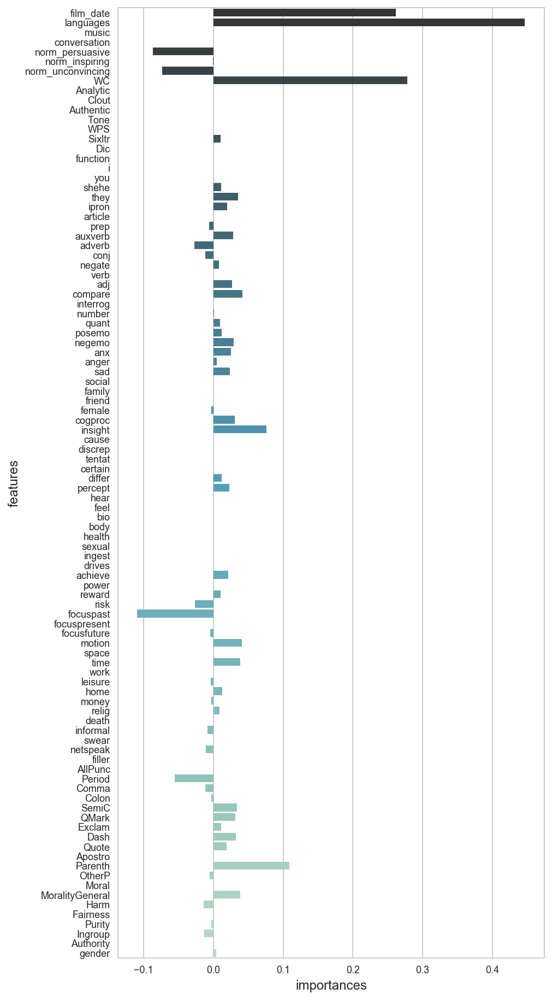

In [593]:
fig = plt.figure(figsize=(7,16))
ax = fig.gca()
sns.barplot(y='variable',x='Lasso_coef', data=Lasso_coef, palette='GnBu_d');
ax.set_ylabel('features', fontsize=12)
ax.set_xlabel('importances', fontsize=12);

In [902]:
MSE = mean_squared_error(y_test, best_lm.predict(X_test_s))

In [904]:
np.sqrt(MSE)

0.49429534148158644

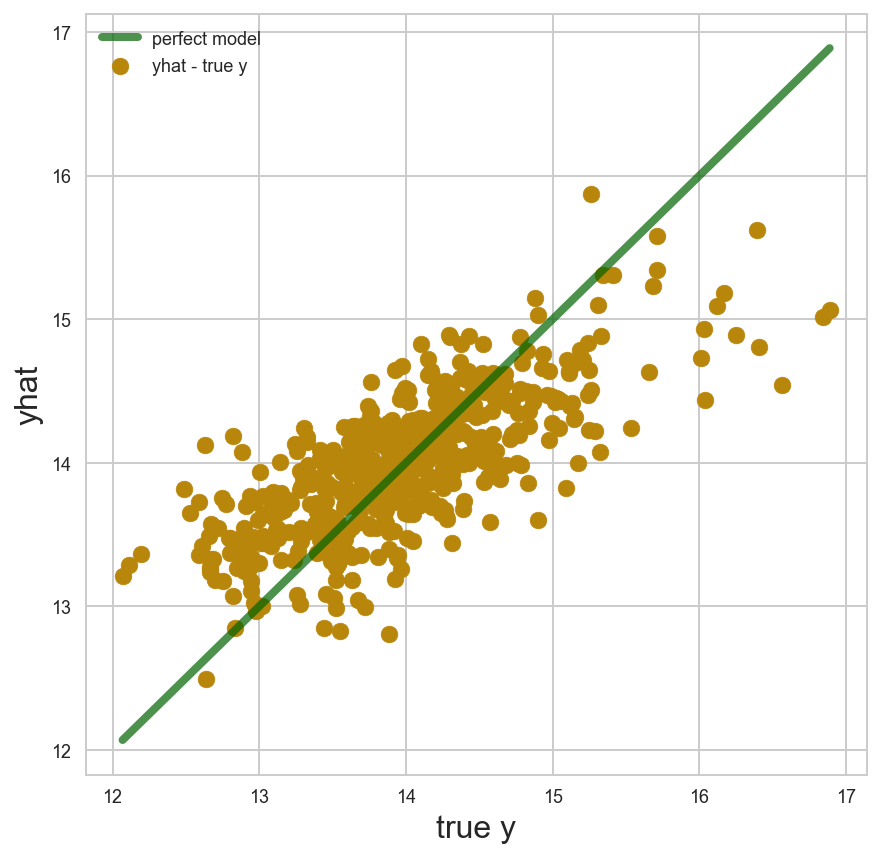

In [595]:
plot_y_yhat(y_test, best_lm.predict(X_test_s))

## Predicting the Persuasiveness

In [367]:
y = df_.norm_persuasive
X = X = df_[['film_date', 'languages','music', 'gender',
         'conversation','WC','Analytic',
         'Clout','Authentic','Tone','WPS','Sixltr','Dic','function','i','you','shehe','they','ipron',
         'article','prep','auxverb','adverb','conj','negate','verb','adj','compare','interrog','number',
        'quant','posemo','negemo','anx','anger','sad','social','family','friend','female','cogproc',
        'insight','cause','discrep','tentat','certain','differ','percept','hear','feel','bio','body',
        'health','sexual','ingest','drives','achieve','power','reward','risk','focuspast','focuspresent',
        'focusfuture','motion','space','time','work','leisure','home','money','relig','death','informal',
        'swear','netspeak','filler','AllPunc','Period','Comma','Colon','SemiC','QMark','Exclam','Dash','Quote',
        'Apostro','Parenth','OtherP','Moral','MoralityGeneral','Harm','Fairness','Purity','Ingroup','Authority',
        'gender'
         ]]

In [368]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state = 1)
rs = RobustScaler()
rs.fit(X_train)
X_train_s = rs.transform(X_train)
X_test_s = rs.transform(X_test)

In [369]:
lr = LinearRegression()
lr.fit(X_train_s, y_train)
cross_val_score(lr, X_train_s, y_train, cv = 3).mean()

0.26669105104774316

In [338]:
# finding the best alpha on the training set
alpha_values = np.logspace(-3,3,50)
mod_ridge = RidgeCV(alphas=alpha_values,  cv=6)
mod_ridge.fit(X_train_s, y_train)
best_alpha = mod_ridge.alpha_

# creating another ridge model with the best alpha to test it again on the training set
best_r_m = Ridge(alpha = best_alpha)
print('Scores: ', cross_val_score(best_r_m, X_train_s, y_train, cv=6))
print('Mean Score: ', cross_val_score(best_r_m, X_train_s, y_train, cv=6).mean())

Scores:  [0.27092669 0.36817879 0.28602643 0.37012898 0.28956862 0.32191478]
Mean Score:  0.31779071485267457


In [339]:
# finding the best alpha on the training set
mod_lasso = LassoCV(n_alphas = 500, alphas=np.logspace(-3,3,100), cv=3, )
mod_lasso.fit(X_train_s, y_train)

# creating another lasso model with the best alpha
best_alpha = mod_lasso.alpha_
best_lm = Lasso(alpha=best_alpha)
print('Scores: ', cross_val_score(best_lm, X_train_s, y_train, cv=6))
print('Mean Score: ', cross_val_score(best_lm, X_train_s, y_train, cv=6).mean())

/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)


Scores:  [0.27241729 0.37022193 0.28310206 0.39623026 0.28729082 0.31954838]
Mean Score:  0.32146845573707405


In [340]:
best_lm.fit(X_train_s, y_train).score(X_test_s, y_test)

0.33219661098096553

In [341]:
Lasso_coef = pd.DataFrame({'variable': X.columns, 'Lasso_coef': best_lm.coef_, 'abs_coef': np.abs(best_lm.coef_)})
Lasso_coef.sort_values('abs_coef', ascending=False).head(20)

,Lasso_coef,abs_coef,variable
5,27.717551,27.717551,WC
1,23.100616,23.100616,languages
59,17.193838,17.193838,risk
57,15.851676,15.851676,power
0,-13.503431,13.503431,film_date
89,12.917428,12.917428,MoralityGeneral
69,12.494252,12.494252,money
86,-12.349692,12.349692,Parenth
7,10.760910,10.760910,Clout
22,-10.363017,10.363017,adverb


## Predicting Gender

In [927]:
y = df_.gender

In [928]:
y.mean()

0.6776814734561214

In [929]:
X = df_[['film_date', 'languages','music',
         'conversation','norm_persuasive','norm_unconvincing','norm_inspiring', 'WC','Analytic',
         'Clout','Authentic','Tone','WPS','Sixltr','Dic','function','i','you','shehe','they','ipron',
         'article','prep','auxverb','adverb','conj','negate','verb','adj','compare','interrog','number',
        'quant','posemo','negemo','anx','anger','sad','social','family','friend','female','cogproc',
        'insight','cause','discrep','tentat','certain','differ','percept','hear','feel','bio','body',
        'health','sexual','ingest','drives','achieve','power','reward','risk','focuspast','focuspresent',
        'focusfuture','motion','space','time','work','leisure','home','money','relig','death','informal',
        'swear','netspeak','filler','AllPunc','Period','Comma','Colon','SemiC','QMark','Exclam','Dash','Quote',
        'Apostro','Parenth','OtherP','Moral','MoralityGeneral','Harm','Fairness','Purity','Ingroup','Authority'
         ]]

In [930]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state = 1, stratify=y)
rs = RobustScaler()
rs.fit(X_train)
X_train_s = rs.transform(X_train)
X_test_s = rs.transform(X_test)

### Random Forest Classifier

In [912]:
pipeline_RFC = Pipeline([
    ('rfc', RandomForestClassifier(n_estimators=30)),
])

parameters_RFC = {"rfc__max_depth": (3, 6, 10, 15, None),
              "rfc__max_features": ('sqrt', 'log2', None, 0.2, 0.5, 0.7),
              "rfc__min_samples_split": (2, 3, 10, 20, 50),
              "rfc__min_samples_leaf": (1, 3, 10, 20, 50),
              "rfc__bootstrap": (True, False),
              "rfc__criterion": ("gini", "entropy")}

In [913]:
gs_rfc = GridSearchCV(pipeline_RFC, param_grid = parameters_RFC, cv=3, n_jobs=-1, verbose=1)

In [119]:

gs_rfc.fit(X_train, y_train)

Fitting 3 folds for each of 3000 candidates, totalling 9000 fits


[Parallel(n_jobs=-1)]: Done  76 tasks      | elapsed:    2.3s
[Parallel(n_jobs=-1)]: Done 376 tasks      | elapsed:   18.6s
[Parallel(n_jobs=-1)]: Done 752 tasks      | elapsed:   46.0s
[Parallel(n_jobs=-1)]: Done 1114 tasks      | elapsed:  1.4min
[Parallel(n_jobs=-1)]: Done 1574 tasks      | elapsed:  2.2min
[Parallel(n_jobs=-1)]: Done 2132 tasks      | elapsed:  3.2min
[Parallel(n_jobs=-1)]: Done 2819 tasks      | elapsed:  4.0min
[Parallel(n_jobs=-1)]: Done 3569 tasks      | elapsed:  5.7min
[Parallel(n_jobs=-1)]: Done 4427 tasks      | elapsed:  7.5min
[Parallel(n_jobs=-1)]: Done 5377 tasks      | elapsed:  9.4min
[Parallel(n_jobs=-1)]: Done 6427 tasks      | elapsed: 12.2min
[Parallel(n_jobs=-1)]: Done 7577 tasks      | elapsed: 15.3min
[Parallel(n_jobs=-1)]: Done 8827 tasks      | elapsed: 19.7min
[Parallel(n_jobs=-1)]: Done 9000 out of 9000 | elapsed: 20.5min finished


GridSearchCV(cv=3, error_score='raise',
       estimator=Pipeline(memory=None,
     steps=[('rfc', RandomForestClassifier(bootstrap=True, class_weight=None, criterion='gini',
            max_depth=None, max_features='auto', max_leaf_nodes=None,
            min_impurity_decrease=0.0, min_impurity_split=None,
            min_samples_leaf=1, min_samples_split=2,
            min_weight_fraction_leaf=0.0, n_estimators=30, n_jobs=1,
            oob_score=False, random_state=None, verbose=0,
            warm_start=False))]),
       fit_params=None, iid=True, n_jobs=-1,
       param_grid={'rfc__max_depth': (3, 6, 10, 15, None), 'rfc__max_features': ('sqrt', 'log2', None, 0.2, 0.5, 0.7), 'rfc__min_samples_split': (2, 3, 10, 20, 50), 'rfc__min_samples_leaf': (1, 3, 10, 20, 50), 'rfc__bootstrap': (True, False), 'rfc__criterion': ('gini', 'entropy')},
       pre_dispatch='2*n_jobs', refit=True, return_train_score='warn',
       scoring=None, verbose=1)

In [120]:
# Model Scores, best parameters and the intercept
print('Best Model Score:', gs_rfc.best_score_)
print('Best Parameters:', gs_rfc.best_params_)
print('Accuracy Score:', gs_rfc.best_estimator_.score(X_test, y_test))

Best Model Score: 0.7321981424148607
Best Parameters: {'rfc__bootstrap': False, 'rfc__criterion': 'entropy', 'rfc__max_depth': None, 'rfc__max_features': 0.5, 'rfc__min_samples_leaf': 10, 'rfc__min_samples_split': 3}
Accuracy Score: 0.703971119133574


In [911]:
best_rf = gs_rfc.best_estimator_
best_rf.fit(X_train, y_train)

NameError: name 'gs_rfc' is not defined

In [914]:
best_rf = RandomForestClassifier(bootstrap=False, class_weight=None,
            criterion='entropy', max_depth=None, max_features=0.5,
            max_leaf_nodes=None, min_impurity_decrease=0.0,
            min_impurity_split=None, min_samples_leaf=10,
            min_samples_split=3, min_weight_fraction_leaf=0.0,
            n_estimators=30, n_jobs=1, oob_score=False, random_state=None,
            verbose=0, warm_start=False).fit(X_train, y_train)

In [602]:
dot_data = StringIO()
export_graphviz(best_rf.estimators_[0], out_file=dot_data,
                feature_names=X_train.columns,
#                 class_names=best_rf[0].feature_names,
               filled=True, rounded=True,
                proportion=True,
                special_characters=True,
                node_ids=True)
graph = pydotplus.graph_from_dot_data(dot_data.getvalue())

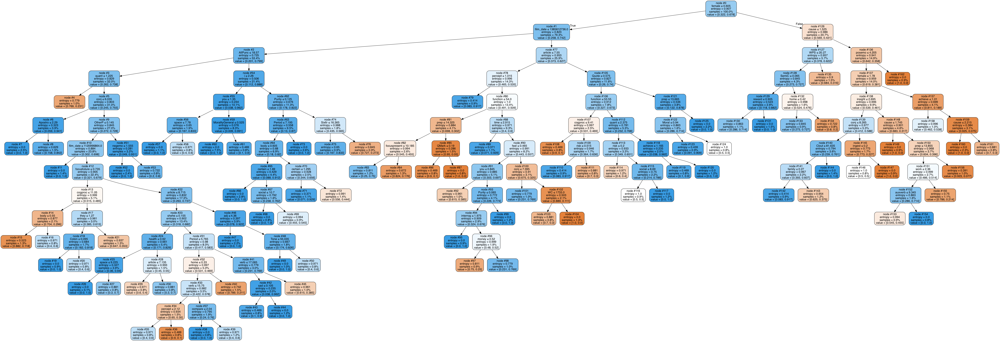

In [603]:
Image(graph.create_png())

In [606]:
feature_im = pd.DataFrame({'importance':best_rf.estimators_[0].feature_importances_, 'variable':X_test.columns})
feature_im.sort_values(by=['importance'], ascending=False).head(20)

,importance,variable
41,0.111978,female
25,0.054440,conj
0,0.051715,film_date
44,0.038226,cause
22,0.034893,prep
21,0.033997,article
32,0.028398,quant
78,0.026964,AllPunc
27,0.026598,verb
15,0.024203,function


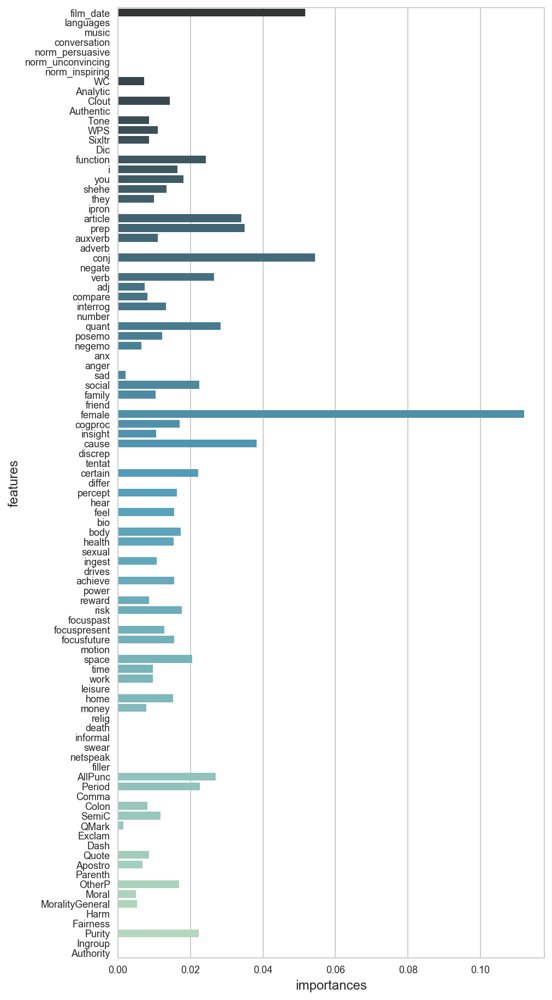

In [607]:
fig = plt.figure(figsize=(7,16))
ax = fig.gca()
sns.barplot(y='variable',x='importance', data=feature_im, palette='GnBu_d');
ax.set_ylabel('features', fontsize=12)
ax.set_xlabel('importances', fontsize=12);

In [ ]:
roc_curve()

In [938]:
fpr_rf, tpr_rf, treshold_rf = roc_curve(y_test, best_rf.predict(X_test))
roc_auc_rf = auc(fpr_rf, tpr_rf)

### Logistic Regression 

In [ ]:
gs_params = {'penalty':['l1','l2'],
             'solver':['liblinear'],
             'C':np.logspace(-5,3,50)}
mod_2 = GridSearchCV(LogisticRegression(), gs_params, cv=3, verbose=2, n_jobs=6)
mod_2.fit(X_train_s, y_train)

In [772]:
# Model Scores, best parameters and the intercept
print('Best Model Score:', mod_2.best_score_)
print('Best Parameters:', mod_2.best_params_)
print('Accuracy Score:', mod_2.best_estimator_.score(X_test_s, y_test))
print('Coefficient:', mod_2.best_estimator_.intercept_)

Best Model Score: 0.7213622291021672
Best Parameters: {'C': 0.026826957952797246, 'penalty': 'l2', 'solver': 'liblinear'}
Accuracy Score: 0.7292418772563177
Coefficient for Houston: [0.38722152]


In [610]:
mod_2 = LogisticRegression(C= 0.026826957952797246, penalty= 'l2', solver='liblinear').fit(X_train_s, y_train)

In [620]:
mod_2

LogisticRegression(C=0.026826957952797246, class_weight=None, dual=False,
          fit_intercept=True, intercept_scaling=1, max_iter=100,
          multi_class='ovr', n_jobs=1, penalty='l2', random_state=None,
          solver='liblinear', tol=0.0001, verbose=0, warm_start=False)

In [664]:
feature_im = pd.DataFrame({'importance': mod_2.coef_[0], 'variable':X_test.columns})
feature_im.sort_values(by=['importance'], ascending=False).head(20)

,importance,variable
21,0.333380,article
31,0.224508,number
18,0.211184,shehe
17,0.205379,you
80,0.176072,Comma
79,0.174899,Period
88,0.170043,Parenth
32,0.168610,quant
64,0.167530,focusfuture
96,0.158928,Authority


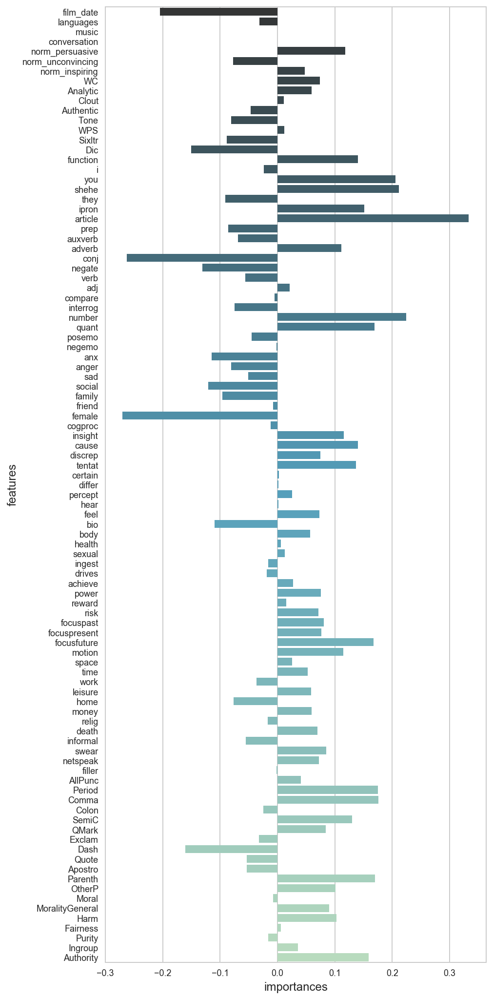

In [781]:
sns.set(style="whitegrid", color_codes=True, font_scale=0.9)
fig = plt.figure(figsize=(7,18))
ax = fig.gca()
sns.barplot(y='variable',x='importance', data=feature_im, palette='GnBu_d');
ax.set_ylabel('features', fontsize=12)
ax.set_xlabel('importances', fontsize=12);

In [669]:
mod2_yhat = mod_2.predict(X_test_s)
confusion = confusion_matrix(y_test, mod2_yhat, labels=[1,0])
pd.DataFrame(confusion, columns=['pred_male', 'pred_female'], index=['male', 'female'])

,pred_male,pred_female
male,330,45
female,109,70


In [671]:
print(classification_report(y_test, mod2_yhat))

             precision    recall  f1-score   support

          0       0.61      0.39      0.48       179
          1       0.75      0.88      0.81       375

avg / total       0.71      0.72      0.70       554



In [939]:
fpr_lr, tpr_lr, treshold_lr = roc_curve(y_test, mod2_yhat)
roc_auc_lr = auc(fpr_lr, tpr_lr)

### KNN Classifier

In [931]:
knn_params = {'n_neighbors':[3,9,12,15,25],
             'weights':['uniform','distance'],
            'metric':['euclidean','manhattan']}
mod_3 = GridSearchCV(KNeighborsClassifier(), knn_params, cv=3, n_jobs=-1, verbose=1)
mod_3.fit(X_train_s, y_train)

Fitting 3 folds for each of 20 candidates, totalling 60 fits


[Parallel(n_jobs=-1)]: Done  42 tasks      | elapsed:    2.2s
[Parallel(n_jobs=-1)]: Done  60 out of  60 | elapsed:    3.0s finished


GridSearchCV(cv=3, error_score='raise',
       estimator=KNeighborsClassifier(algorithm='auto', leaf_size=30, metric='minkowski',
           metric_params=None, n_jobs=1, n_neighbors=5, p=2,
           weights='uniform'),
       fit_params=None, iid=True, n_jobs=-1,
       param_grid={'n_neighbors': [3, 9, 12, 15, 25], 'weights': ['uniform', 'distance'], 'metric': ['euclidean', 'manhattan']},
       pre_dispatch='2*n_jobs', refit=True, return_train_score='warn',
       scoring=None, verbose=1)

In [932]:
# Model Scores, best parameters and the intercept
print('Best Model Score:', mod_3.best_score_)
print('Best Parameters:', mod_3.best_params_)
print('Accuracy Score:', mod_3.best_estimator_.score(X_test_s, y_test))

Best Model Score: 0.7020123839009288
Best Parameters: {'metric': 'euclidean', 'n_neighbors': 15, 'weights': 'uniform'}
Accuracy Score: 0.6931407942238267


In [934]:
mod3_yhat = mod_3.best_estimator_.predict(X_test_s)
confusion = confusion_matrix(y_test, mod3_yhat, labels=[1,0])
pd.DataFrame(confusion, columns=['pred_male', 'pred_female'], index=['male', 'female'])

,pred_male,pred_female
male,339,36
female,134,45


In [940]:
fpr_knn, tpr_knn, treshold_knn = roc_curve(y_test, mod3_yhat)
roc_auc_knn = auc(fpr_knn, tpr_knn)

### ROC Curves

In [942]:
sns.set(style="whitegrid", color_codes=True, font_scale=0.9)

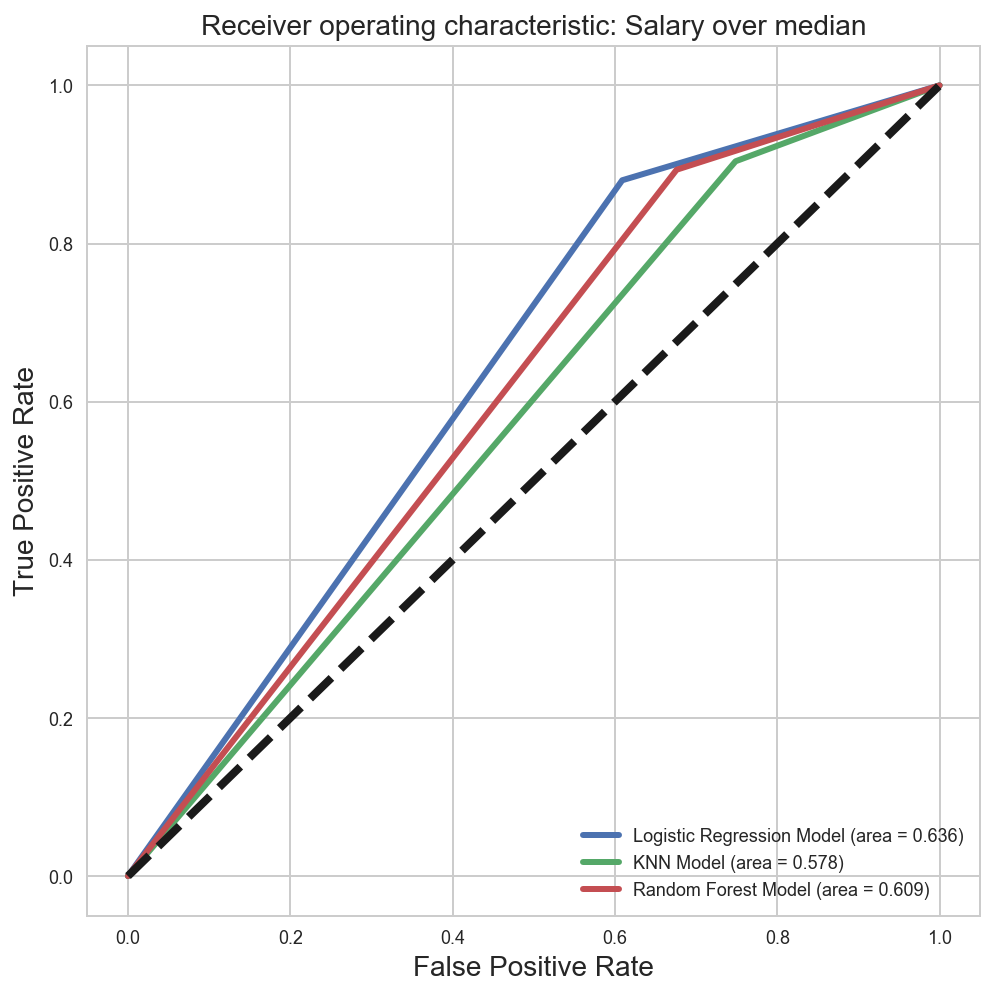

In [943]:
fig, ax = plt.subplots(figsize=(8,8))

ax.plot(fpr_lr, tpr_lr, label='Logistic Regression Model (area = %0.3f)' %roc_auc_lr, linewidth=3)
ax.plot(fpr_knn, tpr_knn, label='KNN Model (area = %0.3f)' %roc_auc_knn, linewidth=3)
ax.plot(fpr_rf, tpr_rf, label='Random Forest Model (area = %0.3f)' %roc_auc_rf, linewidth=3)
ax.plot([0, 1], [0, 1], 'k--', linewidth=4)

ax.set_xlabel('False Positive Rate', fontsize=14)
ax.set_ylabel('True Positive Rate', fontsize=14)
ax.set_title('Receiver operating characteristic: Salary over median', fontsize=14)
ax.legend(loc="lower right");

## EDA on Words

In [738]:
from sklearn.base import BaseEstimator
from sklearn.base import TransformerMixin
def getlemmatized(x):
    
    x = x.lower()
    
    tb = TextBlob(x)
    words_and_pos = tb.tags
    lemmatized_statement = []
    
    for word, pos in words_and_pos:
        
        if pos[0]=='V': use_pos='v'
        elif pos[0]=='N': use_pos='n'
        elif pos[0]=='R': use_pos='r'
        elif pos[0]=='J': use_pos='a'
        else: use_pos=None
        
        lemmatized_word = word.lemmatize(use_pos)
        
        if "'" not in word:
            lemmatized_statement.append(lemmatized_word)
    
    lemmatized_statement = ' '.join(lemmatized_statement)
    
    return lemmatized_statement

class ExtractLemmatized(BaseEstimator,TransformerMixin):
    """Takes in df, outputs readability column"""

    def __init__(self, column_choice):
        self.column_choice = column_choice
        pass

    def transform(self, df, y=None):
        """Returns readability column"""
        column = df[self.column_choice].map(getlemmatized)
        return  column

    def fit(self, df, y=None):
        return self

### Overall 

In [739]:
df_try = df.copy()

In [740]:
df_try['lemmatized'] = df_try.transcript.map(getlemmatized)

In [775]:
def truncate_colormap(cmap, minval=0.0, maxval=1.0, n=100):
    '''
    Takes a matplotlib colormap string, as well as a minimum and maximum threshold for sampling that colormap.
    The default is to sample the entire colormap (from 0.0 to 1.0) 100 times.
    Returns a new colormap object.
    '''
    
    #obtaining the colormap object from the associated string
    cmap = plt.get_cmap(cmap)
    
    #creating a new colormap by sampling within the minimum and maximum threshold
    new_cmap = colors.LinearSegmentedColormap.from_list(
        'truncated_{}'.format(cmap.name),
         cmap(np.linspace(minval, maxval, n)))
    
    return new_cmap

ocean_truncated = truncate_colormap('ocean', 0.0, 0.7)
cmr_truncated = truncate_colormap('CMRmap',0.1,0.75)

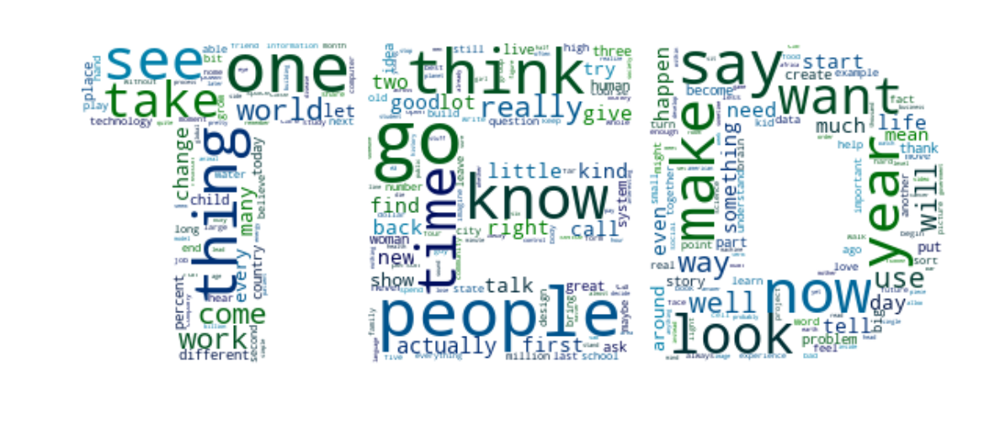

In [776]:
#creating a mask from a picture of the Natural History Museum logo
nhm_mask = np.array(Image.open(('ted.jpg')))


#creating a WordCloud with the top 500 single words from the lemmatized text

wc = WordCloud(background_color='white',
               max_words=500,
               mask=nhm_mask,
               colormap=ocean_truncated,
               collocations=False).generate(' '.join(df_try['lemmatized']))

#saving the resulting WordCloud image
wc.to_file('ted_wordcloud_1.png')

#displaying the WordCloud
plt.figure(figsize=[10,10])
plt.imshow(wc, interpolation='bilinear')
plt.axis("off")
plt.show()

### Topic Categories

technology_th


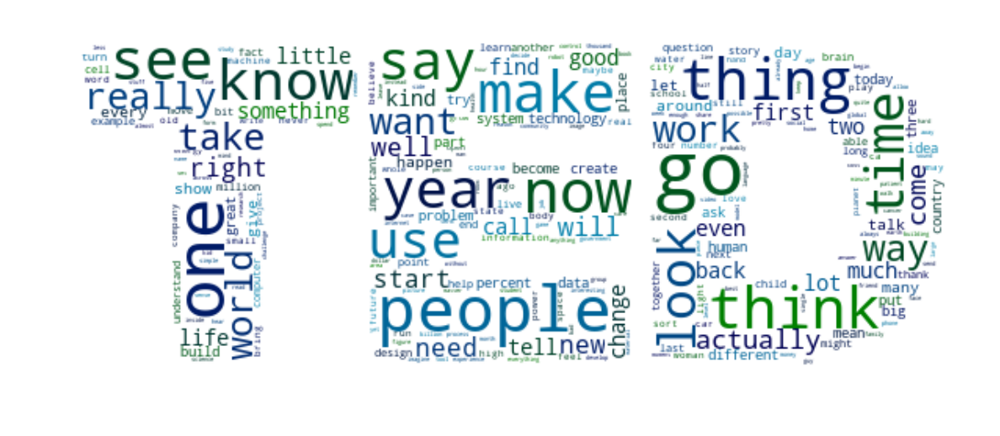

society_th


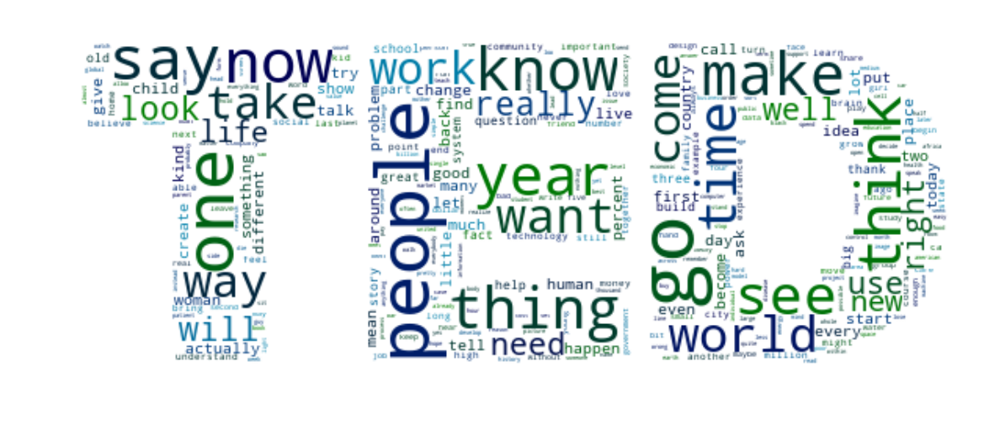

policy_politics_th


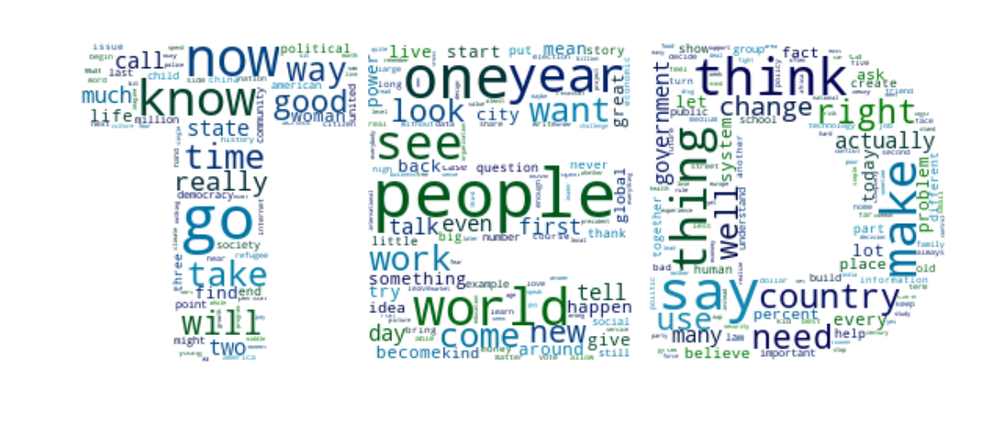

security_th


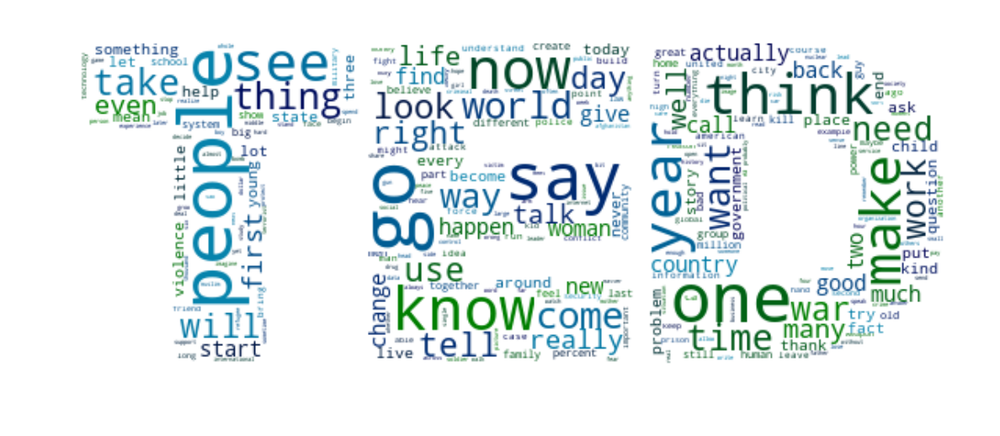

science_and_research_th


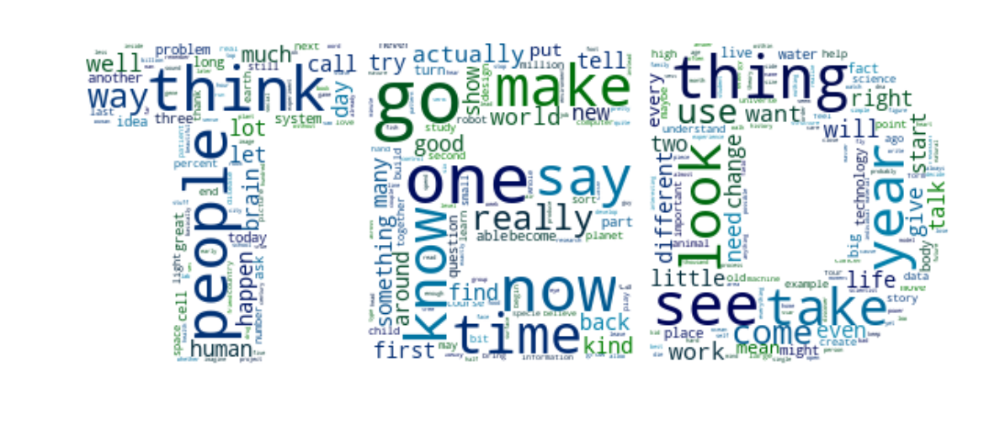

nature_environment_th


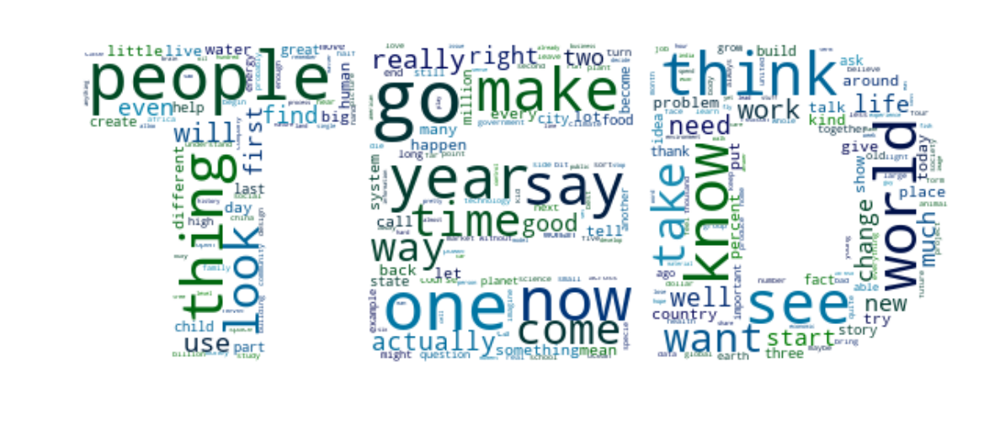

living_spaces_cult_th


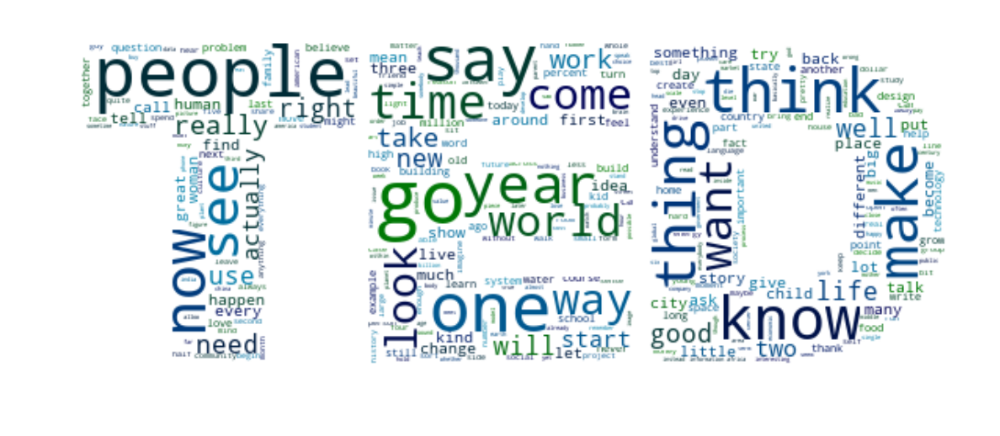

religions_spirituality_th


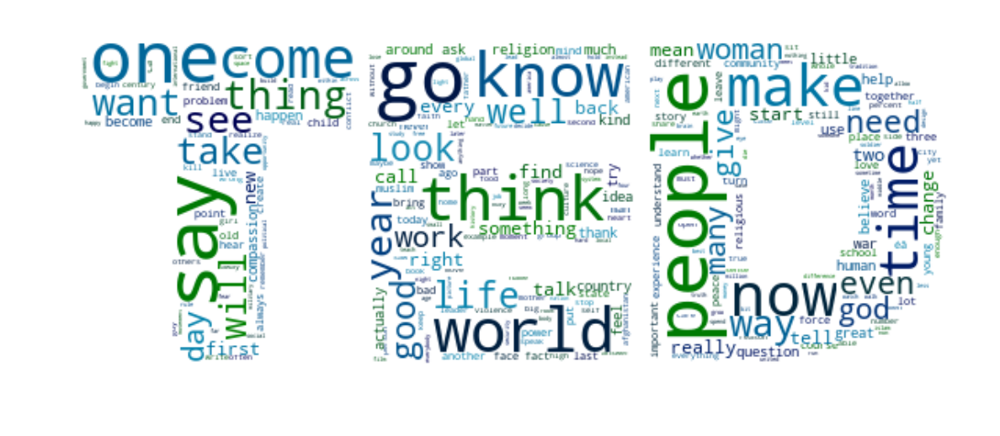

tedmem_awardwin_th


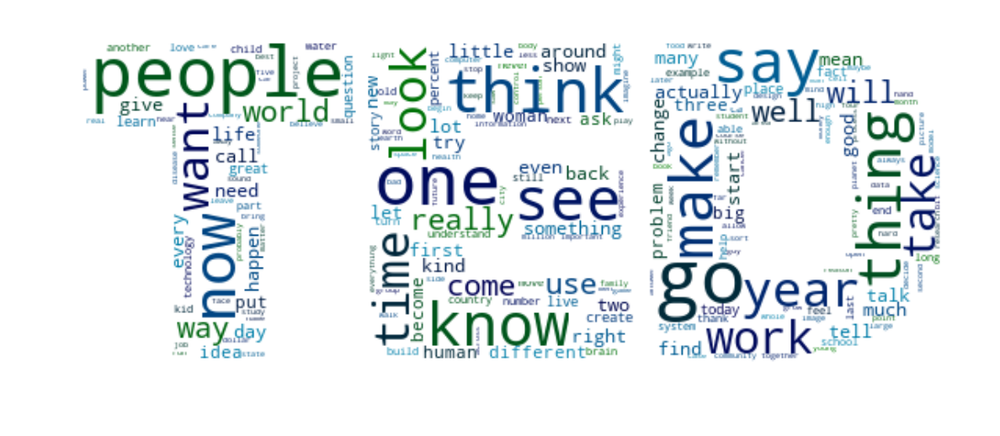

emotions_psychology_th


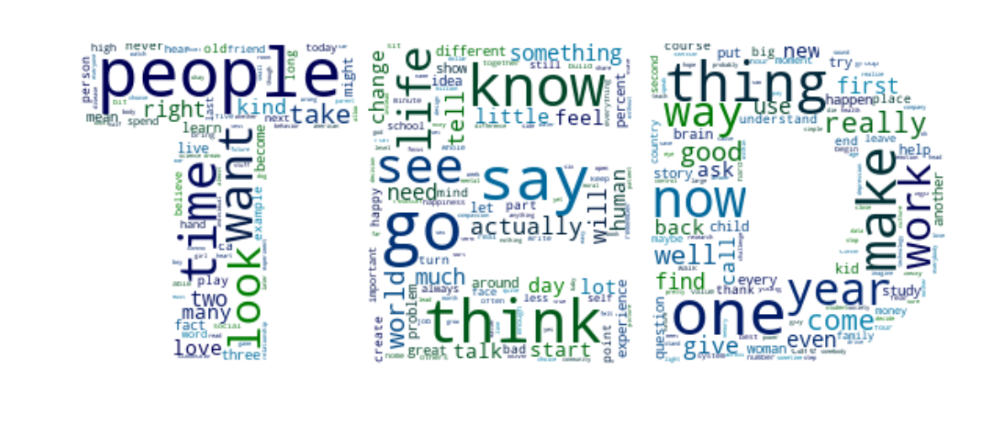

business_th


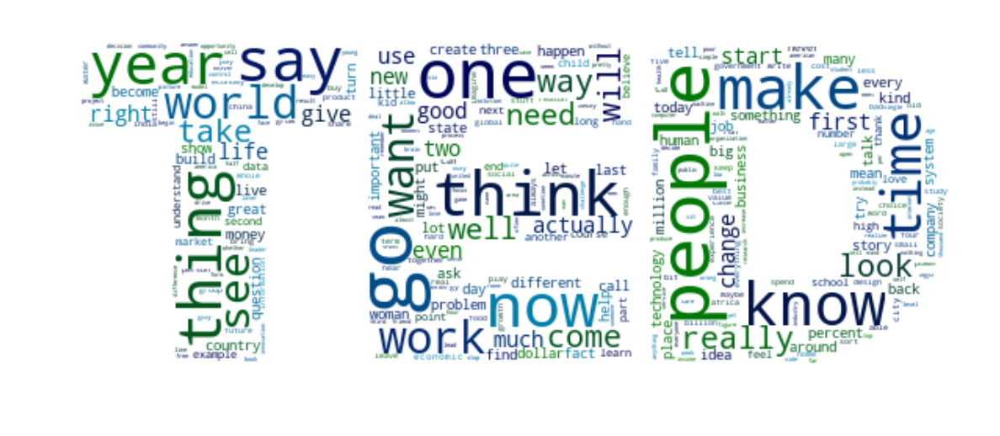

entertainment_th


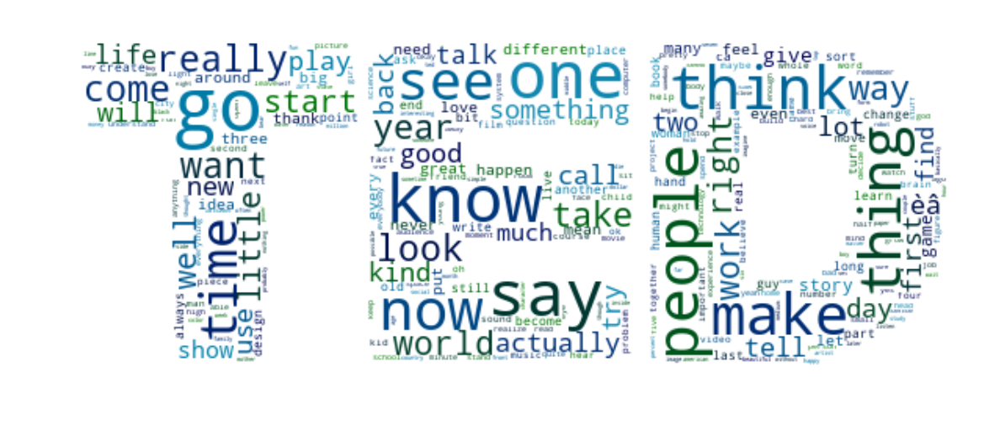

media_th


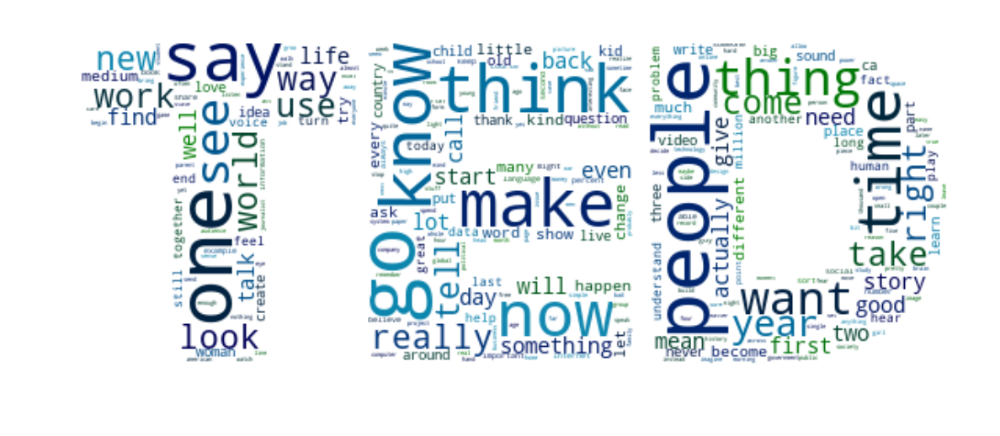

music_th


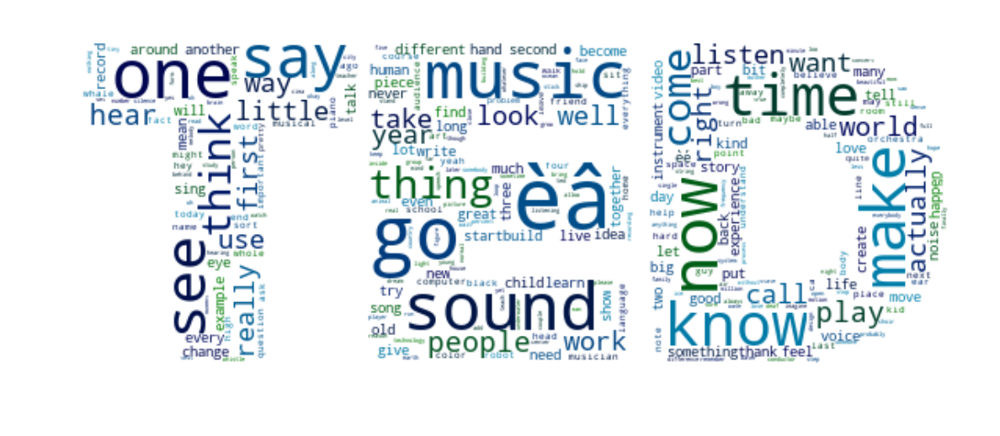

health_and_medicine_th


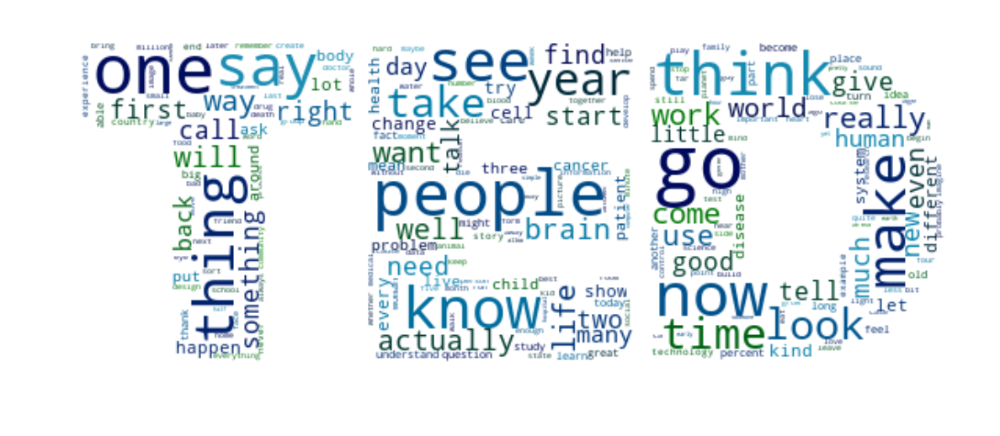

art_and_design_th


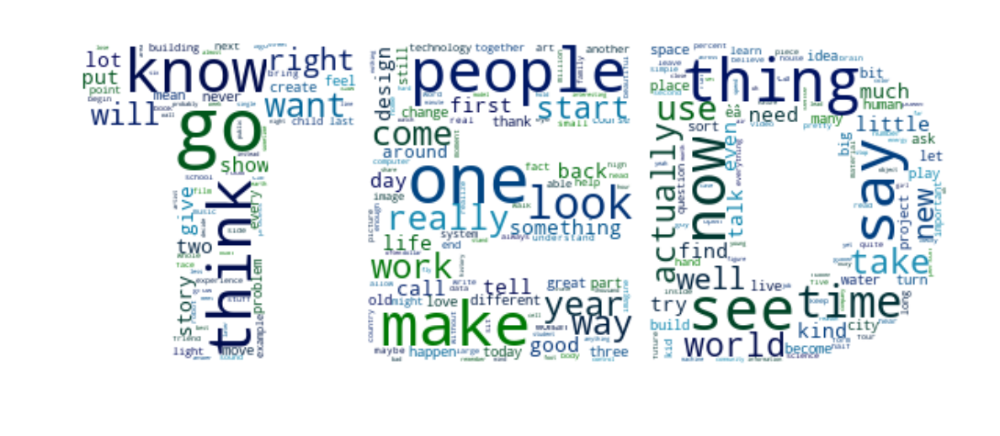

gender_matters_th


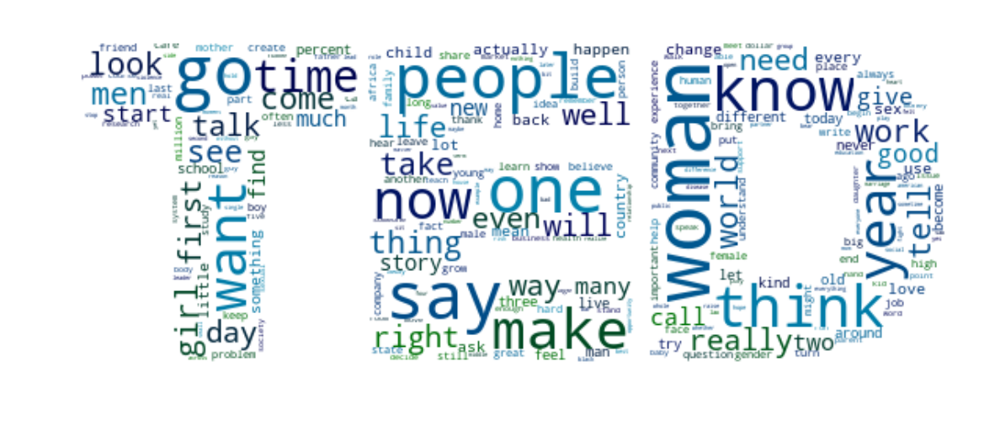

educ_learn_youth_th


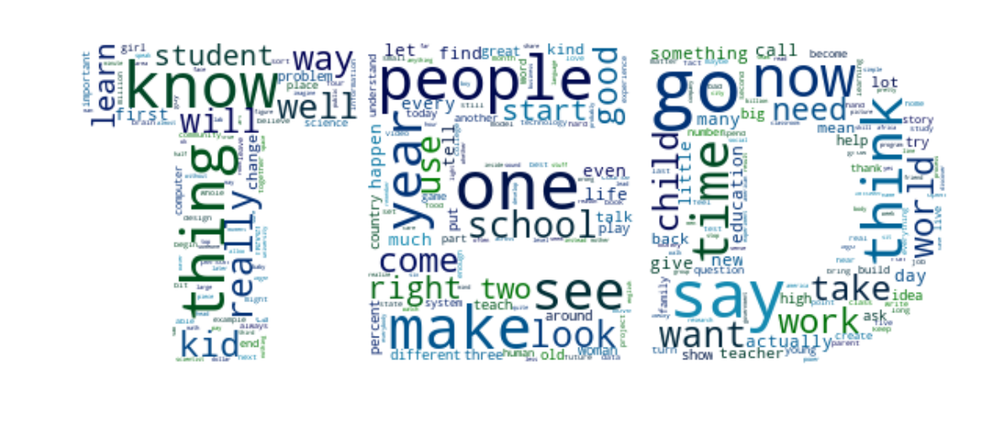

sports


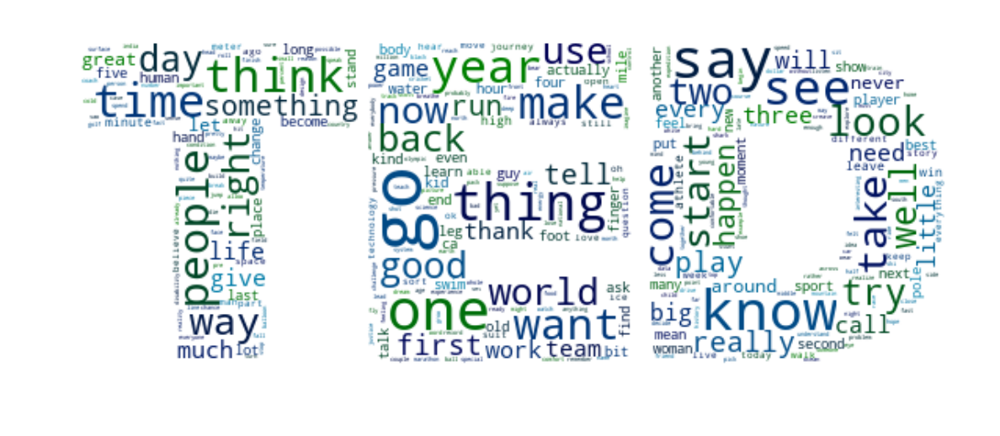

literature_th


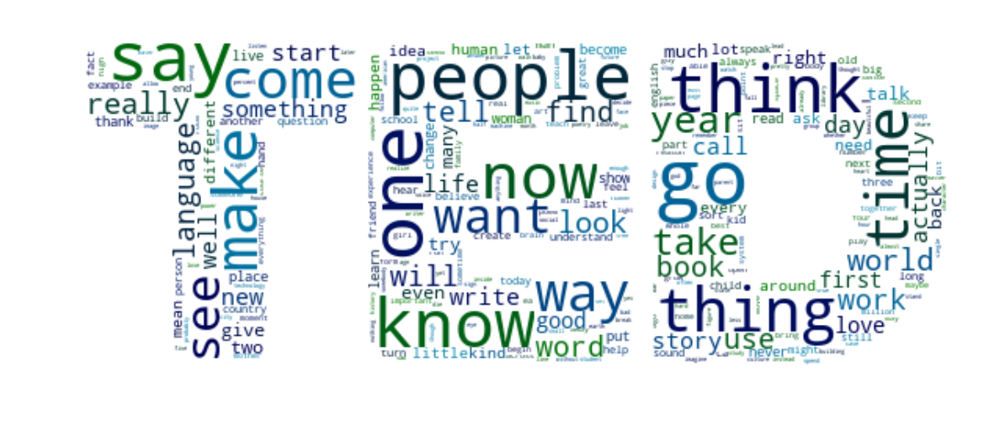

human_th


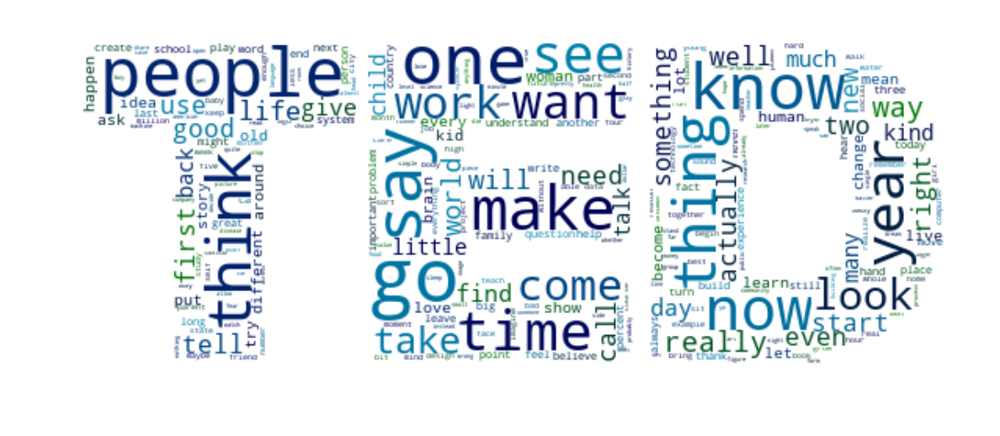

continents_cities_countries_th


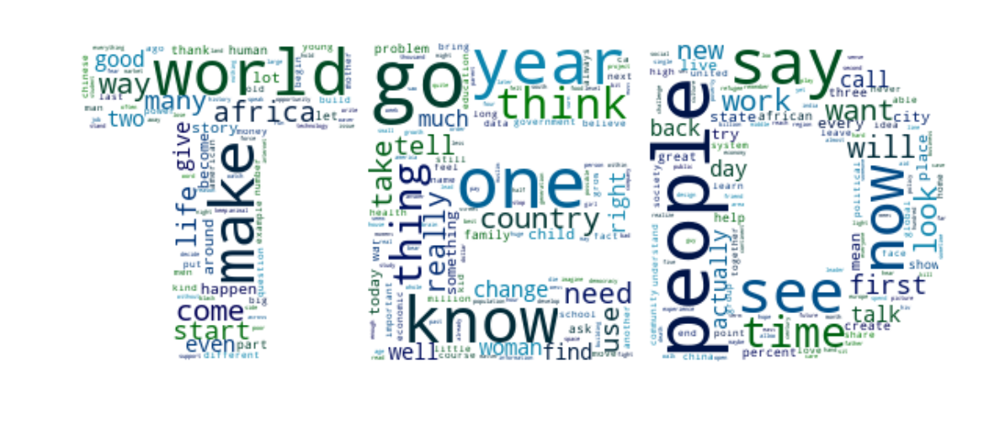

In [779]:
for i in list(df.columns)[139:161]:
    wc = WordCloud(background_color='white',
                   max_words=500,
                   mask=nhm_mask,
                   colormap=ocean_truncated,
                   collocations=False).generate(' '.join(df_try.lemmatized[df_try[i]==1]))

    #saving the resulting WordCloud image
    wc.to_file('ted_wordcloud_{}.png'.format(i))
    print(i)
    #displaying the WordCloud
    plt.figure(figsize=[10,10])
    plt.imshow(wc, interpolation='bilinear')
    plt.axis("off")
    plt.show()

## NLP to predict high/low views

In [377]:
X = df.transcript
y = df.views.map(lambda x: 1 if x>df.views.median() else 0)
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=42)

In [379]:
y.mean()

0.4997919267582189

In [380]:
pipeline_rfp = Pipeline([('extlem', ExtractLemmatized(column_choice='transcript')),
    ('vect', CountVectorizer(stop_words='english')),
                      ('tfidf', TfidfTransformer()),
                       ('rfcml', RandomForestClassifier(n_estimators=50))
                        ])

parameters_rfp= {
# 'vect__max_features': (500, 1000, 5000),
    'vect__ngram_range':((1,1), (1,2)),
    "rfcml__max_depth": (3, 6, 10, 15, 30, None),
              "rfcml__max_features": ('sqrt', 'log2', None, 0.2, 0.5, 0.7),
#               "rfcml__estimator__min_samples_split": (2, 3, 10, 20, 50),
#               "rfcml__estimator__min_samples_leaf": (1, 3, 10, 20, 50),
#               "rfcml__estimator__bootstrap": (True, False),
#               "rfcml__estimator__criterion": ("gini", "entropy")
                }

In [381]:
pipeline_rfp.fit(X_train, y_train)

Pipeline(memory=None,
     steps=[('extlem', ExtractLemmatized(column_choice='transcript')), ('vect', CountVectorizer(analyzer='word', binary=False, decode_error='strict',
        dtype=<class 'numpy.int64'>, encoding='utf-8', input='content',
        lowercase=True, max_df=1.0, max_features=None, min_df=1,
        ngram_rang...n_jobs=1,
            oob_score=False, random_state=None, verbose=0,
            warm_start=False))])

In [382]:
pipeline_rfp.score(X_test, y_test)

0.6213592233009708

## Multilabel Classification using the text scripts

In [966]:
X = df.transcript

In [967]:
y = df[list(df.columns)[139:161]]
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=42)

In [30]:
len(list(df.columns)[139:161])

22

### KNN Classification

In [38]:
pipeline_knn = Pipeline([('extlem', ExtractLemmatized(column_choice='transcript')),
    ('vect', CountVectorizer(stop_words='english')),
                      ('tfidf', TfidfTransformer()),
                       ('knn', OneVsRestClassifier(KNeighborsClassifier()))
                        ])

parameters_knn= {
'vect__max_features': (None, 1000),
    'vect__ngram_range':((1,1), (1,2)),
#                 "rfcml__estimator__max_depth": (3, 6, 10, 15, 30, None),
#               "rfcml__estimator__max_features": ('sqrt', 'log2', None, 0.2, 0.5, 0.7),
# #               "rfcml__estimator__bootstrap": (True, False),
# #               "rfcml__estimator__criterion": ("gini", "entropy")
   'knn__estimator__n_neighbors':(9,12,15,25),
             'knn__estimator__weights':('uniform','distance'),
#             'knn__estimator__metric':['euclidean','manhattan']
                }

In [39]:
gr_rfcml = GridSearchCV(pipeline_knn, parameters_knn, cv=3, n_jobs=7, verbose=2)
gr_rfcml.fit(X_train, y_train)

Fitting 3 folds for each of 32 candidates, totalling 96 fits
[CV] knn__estimator__n_neighbors=9, knn__estimator__weights=uniform, vect__max_features=None, vect__ngram_range=(1, 1) 
[CV] knn__estimator__n_neighbors=9, knn__estimator__weights=uniform, vect__max_features=None, vect__ngram_range=(1, 1) 
[CV] knn__estimator__n_neighbors=9, knn__estimator__weights=uniform, vect__max_features=None, vect__ngram_range=(1, 1) 
[CV] knn__estimator__n_neighbors=9, knn__estimator__weights=uniform, vect__max_features=None, vect__ngram_range=(1, 2) 
[CV] knn__estimator__n_neighbors=9, knn__estimator__weights=uniform, vect__max_features=None, vect__ngram_range=(1, 2) 
[CV] knn__estimator__n_neighbors=9, knn__estimator__weights=uniform, vect__max_features=None, vect__ngram_range=(1, 2) 
[CV] knn__estimator__n_neighbors=9, knn__estimator__weights=uniform, vect__max_features=1000, vect__ngram_range=(1, 1) 
[CV]  knn__estimator__n_neighbors=9, knn__estimator__weights=uniform, vect__max_features=None, vect

[Parallel(n_jobs=7)]: Done  27 tasks      | elapsed: 88.1min


[CV] knn__estimator__n_neighbors=12, knn__estimator__weights=uniform, vect__max_features=1000, vect__ngram_range=(1, 2) 
[CV]  knn__estimator__n_neighbors=12, knn__estimator__weights=uniform, vect__max_features=None, vect__ngram_range=(1, 2), total=12.5min
[CV] knn__estimator__n_neighbors=12, knn__estimator__weights=uniform, vect__max_features=1000, vect__ngram_range=(1, 2) 
[CV]  knn__estimator__n_neighbors=12, knn__estimator__weights=uniform, vect__max_features=1000, vect__ngram_range=(1, 1), total=13.4min
[CV] knn__estimator__n_neighbors=12, knn__estimator__weights=uniform, vect__max_features=1000, vect__ngram_range=(1, 2) 
[CV]  knn__estimator__n_neighbors=12, knn__estimator__weights=uniform, vect__max_features=None, vect__ngram_range=(1, 2), total=13.7min
[CV] knn__estimator__n_neighbors=12, knn__estimator__weights=distance, vect__max_features=None, vect__ngram_range=(1, 1) 
[CV]  knn__estimator__n_neighbors=12, knn__estimator__weights=uniform, vect__max_features=1000, vect__ngram

[CV] knn__estimator__n_neighbors=15, knn__estimator__weights=distance, vect__max_features=None, vect__ngram_range=(1, 2) 
[CV]  knn__estimator__n_neighbors=15, knn__estimator__weights=uniform, vect__max_features=1000, vect__ngram_range=(1, 2), total=13.4min
[CV] knn__estimator__n_neighbors=15, knn__estimator__weights=distance, vect__max_features=1000, vect__ngram_range=(1, 1) 
[CV]  knn__estimator__n_neighbors=15, knn__estimator__weights=distance, vect__max_features=None, vect__ngram_range=(1, 1), total=13.2min
[CV] knn__estimator__n_neighbors=15, knn__estimator__weights=distance, vect__max_features=1000, vect__ngram_range=(1, 1) 
[CV]  knn__estimator__n_neighbors=15, knn__estimator__weights=distance, vect__max_features=None, vect__ngram_range=(1, 1), total=13.2min
[CV] knn__estimator__n_neighbors=15, knn__estimator__weights=distance, vect__max_features=1000, vect__ngram_range=(1, 1) 
[CV]  knn__estimator__n_neighbors=15, knn__estimator__weights=distance, vect__max_features=None, vect_

[CV]  knn__estimator__n_neighbors=25, knn__estimator__weights=distance, vect__max_features=1000, vect__ngram_range=(1, 1), total= 9.3min
[CV]  knn__estimator__n_neighbors=25, knn__estimator__weights=distance, vect__max_features=1000, vect__ngram_range=(1, 2), total= 9.4min
[CV]  knn__estimator__n_neighbors=25, knn__estimator__weights=distance, vect__max_features=1000, vect__ngram_range=(1, 2), total= 9.2min
[CV]  knn__estimator__n_neighbors=25, knn__estimator__weights=distance, vect__max_features=1000, vect__ngram_range=(1, 2), total= 9.1min


[Parallel(n_jobs=7)]: Done  96 out of  96 | elapsed: 300.9min finished


GridSearchCV(cv=3, error_score='raise',
       estimator=Pipeline(memory=None,
     steps=[('extlem', ExtractLemmatized(column_choice='transcript')), ('vect', CountVectorizer(analyzer='word', binary=False, decode_error='strict',
        dtype=<class 'numpy.int64'>, encoding='utf-8', input='content',
        lowercase=True, max_df=1.0, max_features=None, min_df=1,
        ngram_rang...tric_params=None, n_jobs=1, n_neighbors=5, p=2,
           weights='uniform'),
          n_jobs=1))]),
       fit_params=None, iid=True, n_jobs=7,
       param_grid={'vect__max_features': (None, 1000), 'vect__ngram_range': ((1, 1), (1, 2)), 'knn__estimator__n_neighbors': (9, 12, 15, 25), 'knn__estimator__weights': ('uniform', 'distance')},
       pre_dispatch='2*n_jobs', refit=True, return_train_score='warn',
       scoring=None, verbose=2)

In [44]:
gr_rfcml.best_estimator_.get_params()

{'extlem': ExtractLemmatized(column_choice='transcript'),
 'extlem__column_choice': 'transcript',
 'knn': OneVsRestClassifier(estimator=KNeighborsClassifier(algorithm='auto', leaf_size=30, metric='minkowski',
            metric_params=None, n_jobs=1, n_neighbors=9, p=2,
            weights='uniform'),
           n_jobs=1),
 'knn__estimator': KNeighborsClassifier(algorithm='auto', leaf_size=30, metric='minkowski',
            metric_params=None, n_jobs=1, n_neighbors=9, p=2,
            weights='uniform'),
 'knn__estimator__algorithm': 'auto',
 'knn__estimator__leaf_size': 30,
 'knn__estimator__metric': 'minkowski',
 'knn__estimator__metric_params': None,
 'knn__estimator__n_jobs': 1,
 'knn__estimator__n_neighbors': 9,
 'knn__estimator__p': 2,
 'knn__estimator__weights': 'uniform',
 'knn__n_jobs': 1,
 'memory': None,
 'steps': [('extlem', ExtractLemmatized(column_choice='transcript')),
  ('vect',
   CountVectorizer(analyzer='word', binary=False, decode_error='strict',
           dtype=<

In [754]:
gr_rfcml.best_params_

{'knn__estimator__n_neighbors': 9,
 'knn__estimator__weights': 'uniform',
 'vect__max_features': 1000,
 'vect__ngram_range': (1, 2)}

In [824]:
prediction = gr_rfcml.predict(X_test)

In [825]:
jaccard_similarity_score(y_test, prediction)

0.37119475916285904

In [53]:
precision = dict()
recall = dict()
average_precision = dict()
th = dict()
for i in range(len(y.columns)):
    precision[i], recall[i], th[i]= precision_recall_curve(y_test[y_test.columns[i]], pred_prb[:,i])
    average_precision[i] = average_precision_score(y_test[y_test.columns[i]], predictions[:,i])

In [108]:
average_precision_score(y_test,prediction,average="macro"), average_precision_score(y_test,prediction,average="weighted")

(0.34603576203736597, 0.4436522872153945)

In [125]:
average_precision_score(y_test,prediction,average="micro")

0.3935153769962684

In [972]:
y_train.mean().mean()

0.19587071667927794

In [ ]:

predictions = gr_rfcml.best_estimator_.predict(X_test)
pred_prb = gr_rfcml.best_estimator_.predict_proba(X_test)
dict_pd = {}

        
        

In [848]:
dict_base = {}
for i in range(len(y.columns)):
    col_true = y_test.iloc[:,i]
    col_pred = prediction[:,i]
    dict_base[y_test.columns[i]]= y_train.iloc[:,i].mean()
    dict_pd[y_test.columns[i]] = accuracy_score(col_true, col_pred)
col_acc = pd.Series(dict_pd)
col_base = pd.Series(dict_base)

In [850]:
col_base

art_and_design_th                 0.351367
business_th                       0.247919
continents_cities_countries_th    0.103448
educ_learn_youth_th               0.097503
emotions_psychology_th            0.124257
entertainment_th                  0.144471
gender_matters_th                 0.068966
health_and_medicine_th            0.258026
human_th                          0.313317
literature_th                     0.082640
living_spaces_cult_th             0.294887
media_th                          0.077289
music_th                          0.024376
nature_environment_th             0.383472
policy_politics_th                0.102854
religions_spirituality_th         0.048751
science_and_research_th           0.374554
security_th                       0.088585
society_th                        0.353151
sports                            0.015458
technology_th                     0.480975
tedmem_awardwin_th                0.272889
dtype: float64

In [852]:
col_acc

art_and_design_th                 0.785021
business_th                       0.822469
continents_cities_countries_th    0.897365
educ_learn_youth_th               0.898752
emotions_psychology_th            0.901526
entertainment_th                  0.886269
gender_matters_th                 0.955617
health_and_medicine_th            0.819695
human_th                          0.719834
literature_th                     0.938974
living_spaces_cult_th             0.744799
media_th                          0.925104
music_th                          0.980583
nature_environment_th             0.753121
policy_politics_th                0.918169
religions_spirituality_th         0.955617
science_and_research_th           0.757282
security_th                       0.918169
society_th                        0.643551
sports                            0.988904
technology_th                     0.679612
tedmem_awardwin_th                0.721221
dtype: float64

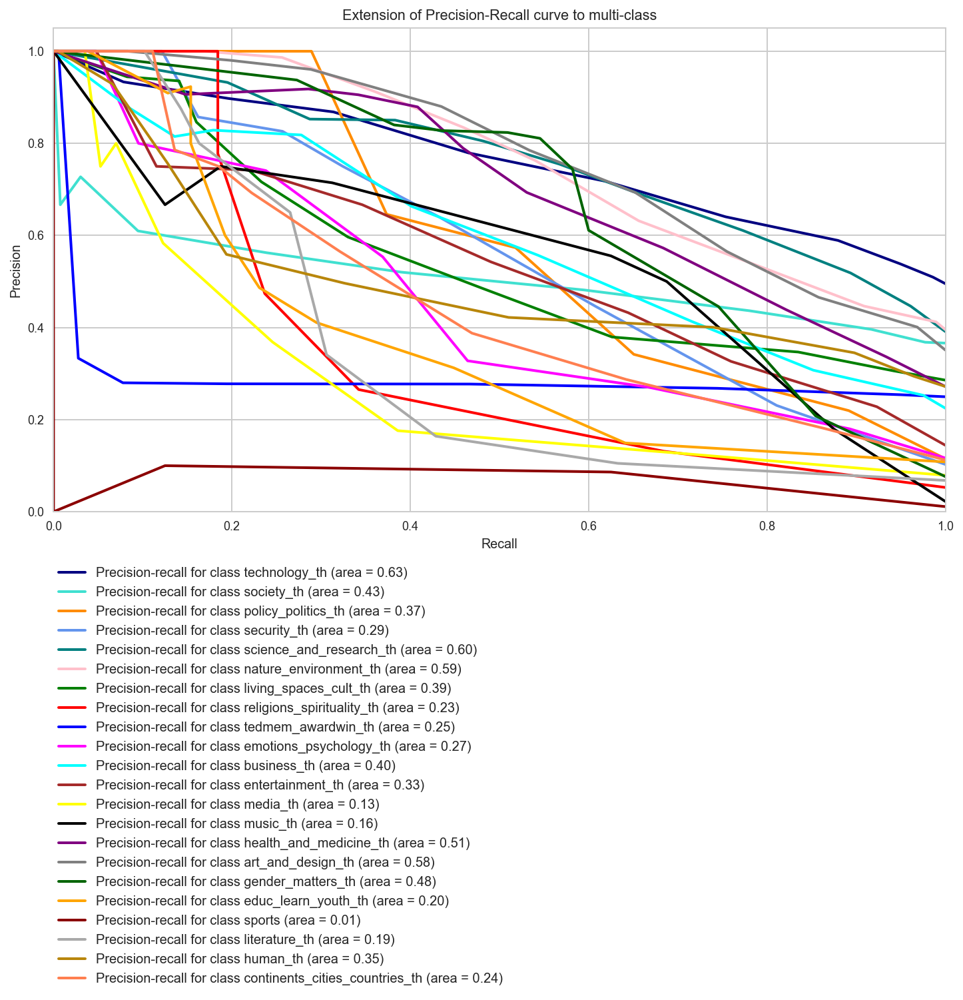

In [970]:
from itertools import cycle
colors = cycle(['navy', 'turquoise', 'darkorange', 'cornflowerblue', 'teal', 'pink', 'green', 'red', 'blue', 'magenta',
               'cyan', 'brown', 'yellow', 'black', 'purple', 'grey', 'darkgreen', 'orange', 'darkred', 'darkgrey', 'darkgoldenrod',
               'coral'])
lines = []
labels = []
sns.set(style="whitegrid", color_codes=True, font_scale=0.9)
plt.figure(figsize=(12, 8))

for i, color in zip(range(len(precision.keys())-1), colors):
    l, = plt.plot(recall[i], precision[i], color=color, lw=2)
    lines.append(l)
    labels.append('Precision-recall for class {0} (area = {1:0.2f})'.format(y.columns[i], average_precision[i]))
    
fig = plt.gcf()
fig.subplots_adjust(bottom=0.25)
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('Recall')
plt.ylabel('Precision')
plt.title('Extension of Precision-Recall curve to multi-class')
plt.legend(lines, labels, loc=(0, -.99), prop=dict(size=10));


In [814]:
#  A "micro-average": quantifying score on all classes jointly
precision["micro"], recall["micro"], _ = precision_recall_curve(np.array(y_test).ravel(),
    pred_prb.ravel())
average_precision["micro"] = average_precision_score(y_test, predictions,
                                                     average="micro")
print('Average precision score, micro-averaged over all classes: {0:0.2f}'
      .format(average_precision["micro"]))

Average precision score, micro-averaged over all classes: 0.39


In [87]:
y_baseline = y_train.copy()
for col in y_baseline.columns:
    if y_baseline[col].mean()>0.5:
        y_baseline[col] = 1
    else:
        y_baseline[col] = 0

In [90]:
y_baseline.head(4)

,technology_th,society_th,policy_politics_th,security_th,science_and_research_th,nature_environment_th,living_spaces_cult_th,religions_spirituality_th,tedmem_awardwin_th,emotions_psychology_th,business_th,entertainment_th,media_th,music_th,health_and_medicine_th,art_and_design_th,gender_matters_th,educ_learn_youth_th,sports,literature_th,human_th,continents_cities_countries_th
458,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
78,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
1103,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
32,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0


In [102]:
average_precision_score(y_train,y_baseline,average="macro"), average_precision_score(y_train,y_baseline,average="weighted")


(0.19587071667927794, 0.2901275155982182)

In [973]:
average_precision_score(y_train,y_baseline,average="micro")

0.1958707166792779

Text(0.5,1,'Average precision score, micro-averaged over all classes: AP=0.44')

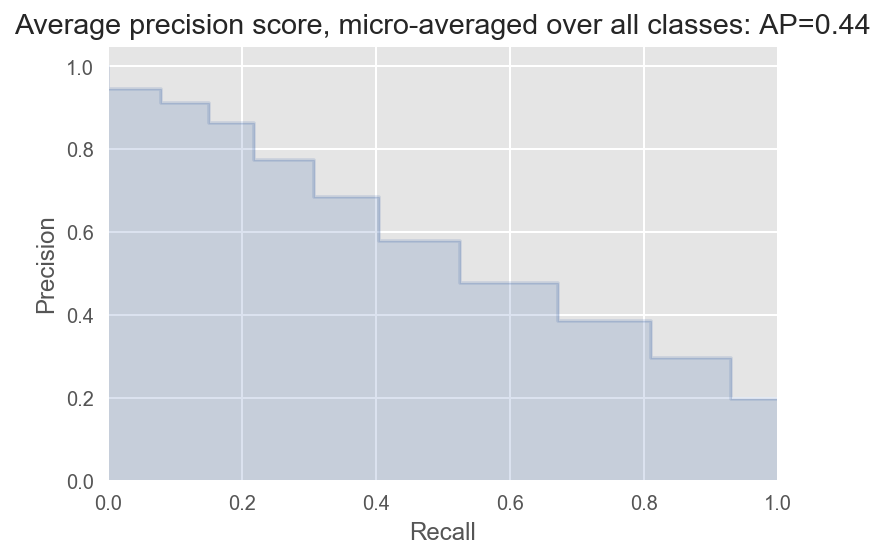

In [81]:
plt.figure()
plt.step(recall['micro'], precision['micro'], color='b', alpha=0.2,
         where='post')
plt.fill_between(recall["micro"], precision["micro"], step='post', alpha=0.2,
                 color='b')

plt.xlabel('Recall')
plt.ylabel('Precision')
plt.ylim([0.0, 1.05])
plt.xlim([0.0, 1.0])
plt.title(
    'Average precision score, micro-averaged over all classes: AP={0:0.2f}'
    .format(average_precision["micro"]))

In [169]:
from sklearn.metrics import jaccard_similarity_score

### Extra Trees Classifier

In [165]:
pipeline_et = Pipeline([('extlem', ExtractLemmatized(column_choice='transcript')),
    ('vect', CountVectorizer(stop_words='english')),
                      ('tfidf', TfidfTransformer()),
                       ('et', OneVsRestClassifier(ExtraTreesClassifier()))
                        ])

parameters_et= {
'vect__max_features': (500, 1000),
    'vect__ngram_range':((1,1), (1,2)),
                "et__estimator__max_depth": (15, 30),
              "et__estimator__max_features": ('sqrt', 'log2', None, 0.2, 0.5),
# #               "rfcml__estimator__bootstrap": (True, False),
# #               "rfcml__estimator__criterion": ("gini", "entropy")
                }

In [166]:
gr_et = GridSearchCV(pipeline_et, parameters_et, cv=3, verbose=2, n_jobs=8)

In [167]:
gr_et.fit(X_train, y_train)

Fitting 3 folds for each of 40 candidates, totalling 120 fits
[CV] et__estimator__max_depth=15, et__estimator__max_features=sqrt, vect__max_features=500, vect__ngram_range=(1, 1) 
[CV] et__estimator__max_depth=15, et__estimator__max_features=sqrt, vect__max_features=500, vect__ngram_range=(1, 1) 
[CV] et__estimator__max_depth=15, et__estimator__max_features=sqrt, vect__max_features=500, vect__ngram_range=(1, 1) 
[CV] et__estimator__max_depth=15, et__estimator__max_features=sqrt, vect__max_features=500, vect__ngram_range=(1, 2) 
[CV] et__estimator__max_depth=15, et__estimator__max_features=sqrt, vect__max_features=500, vect__ngram_range=(1, 2) 
[CV] et__estimator__max_depth=15, et__estimator__max_features=sqrt, vect__max_features=500, vect__ngram_range=(1, 2) 
[CV] et__estimator__max_depth=15, et__estimator__max_features=sqrt, vect__max_features=1000, vect__ngram_range=(1, 1) 
[CV] et__estimator__max_depth=15, et__estimator__max_features=sqrt, vect__max_features=1000, vect__ngram_range=

[Parallel(n_jobs=8)]: Done  25 tasks      | elapsed: 207.7min


[CV] et__estimator__max_depth=15, et__estimator__max_features=None, vect__max_features=1000, vect__ngram_range=(1, 1) 
[CV]  et__estimator__max_depth=15, et__estimator__max_features=None, vect__max_features=500, vect__ngram_range=(1, 1), total=13.6min
[CV] et__estimator__max_depth=15, et__estimator__max_features=None, vect__max_features=1000, vect__ngram_range=(1, 2) 
[CV]  et__estimator__max_depth=15, et__estimator__max_features=None, vect__max_features=500, vect__ngram_range=(1, 1), total=13.6min
[CV] et__estimator__max_depth=15, et__estimator__max_features=None, vect__max_features=1000, vect__ngram_range=(1, 2) 
[CV]  et__estimator__max_depth=15, et__estimator__max_features=None, vect__max_features=500, vect__ngram_range=(1, 2), total=13.8min
[CV] et__estimator__max_depth=15, et__estimator__max_features=None, vect__max_features=1000, vect__ngram_range=(1, 2) 
[CV]  et__estimator__max_depth=15, et__estimator__max_features=None, vect__max_features=500, vect__ngram_range=(1, 2), total=

[CV] et__estimator__max_depth=30, et__estimator__max_features=sqrt, vect__max_features=500, vect__ngram_range=(1, 2) 
[CV]  et__estimator__max_depth=15, et__estimator__max_features=0.5, vect__max_features=1000, vect__ngram_range=(1, 2), total=13.6min
[CV] et__estimator__max_depth=30, et__estimator__max_features=sqrt, vect__max_features=1000, vect__ngram_range=(1, 1) 
[CV]  et__estimator__max_depth=15, et__estimator__max_features=0.5, vect__max_features=1000, vect__ngram_range=(1, 2), total=13.6min
[CV] et__estimator__max_depth=30, et__estimator__max_features=sqrt, vect__max_features=1000, vect__ngram_range=(1, 1) 
[CV]  et__estimator__max_depth=30, et__estimator__max_features=sqrt, vect__max_features=500, vect__ngram_range=(1, 1), total=13.0min
[CV] et__estimator__max_depth=30, et__estimator__max_features=sqrt, vect__max_features=1000, vect__ngram_range=(1, 1) 
[CV]  et__estimator__max_depth=30, et__estimator__max_features=sqrt, vect__max_features=500, vect__ngram_range=(1, 1), total=1

[CV] et__estimator__max_depth=30, et__estimator__max_features=0.2, vect__max_features=500, vect__ngram_range=(1, 1) 
[CV]  et__estimator__max_depth=30, et__estimator__max_features=None, vect__max_features=1000, vect__ngram_range=(1, 1), total=14.1min
[CV] et__estimator__max_depth=30, et__estimator__max_features=0.2, vect__max_features=500, vect__ngram_range=(1, 2) 
[CV]  et__estimator__max_depth=30, et__estimator__max_features=None, vect__max_features=1000, vect__ngram_range=(1, 1), total=14.0min
[CV] et__estimator__max_depth=30, et__estimator__max_features=0.2, vect__max_features=500, vect__ngram_range=(1, 2) 
[CV]  et__estimator__max_depth=30, et__estimator__max_features=None, vect__max_features=1000, vect__ngram_range=(1, 2), total=14.3min
[CV] et__estimator__max_depth=30, et__estimator__max_features=0.2, vect__max_features=500, vect__ngram_range=(1, 2) 
[CV]  et__estimator__max_depth=30, et__estimator__max_features=None, vect__max_features=1000, vect__ngram_range=(1, 2), total=14.3

[Parallel(n_jobs=8)]: Done 120 out of 120 | elapsed: 456.6min finished


GridSearchCV(cv=3, error_score='raise',
       estimator=Pipeline(memory=None,
     steps=[('extlem', ExtractLemmatized(column_choice='transcript')), ('vect', CountVectorizer(analyzer='word', binary=False, decode_error='strict',
        dtype=<class 'numpy.int64'>, encoding='utf-8', input='content',
        lowercase=True, max_df=1.0, max_features=None, min_df=1,
        ngram_rang...,
           oob_score=False, random_state=None, verbose=0, warm_start=False),
          n_jobs=1))]),
       fit_params=None, iid=True, n_jobs=8,
       param_grid={'vect__max_features': (500, 1000), 'vect__ngram_range': ((1, 1), (1, 2)), 'et__estimator__max_depth': (15, 30), 'et__estimator__max_features': ('sqrt', 'log2', None, 0.2, 0.5)},
       pre_dispatch='2*n_jobs', refit=True, return_train_score='warn',
       scoring=None, verbose=2)

In [168]:
pred = gr_et.predict(X_test)

In [ ]:
gr_et.best_estimator_

In [170]:
jaccard_similarity_score(y_test, pred)

0.32271216224059496

In [186]:
hamming_loss(y_test, pred)

0.15962678098600427

In [188]:
zero_one_loss(y_test, pred, normalize=False)

695

### Binary Relevance

In [191]:
pipeline_br = Pipeline([('extlem', ExtractLemmatized(column_choice='transcript')),
    ('vect', CountVectorizer(stop_words='english')),
                      ('tfidf', TfidfTransformer()),
                       ('et', BinaryRelevance(ExtraTreesClassifier()))
                        ])

In [193]:
pipeline_br.fit(X_train, y_train)

Pipeline(memory=None,
     steps=[('extlem', ExtractLemmatized(column_choice='transcript')), ('vect', CountVectorizer(analyzer='word', binary=False, decode_error='strict',
        dtype=<class 'numpy.int64'>, encoding='utf-8', input='content',
        lowercase=True, max_df=1.0, max_features=None, min_df=1,
        ngram_rang..._score=False, random_state=None, verbose=0, warm_start=False),
        require_dense=[True, True]))])

In [194]:
pipeline_br_pred = pipeline_br.predict(X_test)

In [195]:
jaccard_similarity_score(y_test, pipeline_br_pred)

0.21763438826545622

### Classifier Chain

In [197]:
pipeline_cc = Pipeline([('extlem', ExtractLemmatized(column_choice='transcript')),
    ('vect', CountVectorizer(stop_words='english')),
                      ('tfidf', TfidfTransformer()),
                       ('et', ClassifierChain(ExtraTreesClassifier()))
                        ])

In [198]:
pipeline_cc.fit(X_train, y_train)

Pipeline(memory=None,
     steps=[('extlem', ExtractLemmatized(column_choice='transcript')), ('vect', CountVectorizer(analyzer='word', binary=False, decode_error='strict',
        dtype=<class 'numpy.int64'>, encoding='utf-8', input='content',
        lowercase=True, max_df=1.0, max_features=None, min_df=1,
        ngram_rang..._score=False, random_state=None, verbose=0, warm_start=False),
        require_dense=[True, True]))])

In [200]:
jaccard_similarity_score(y_test, pipeline_cc.predict(X_test))

0.21048807872663627

### Label Powerset

In [206]:
pipeline_lp = Pipeline([('extlem', ExtractLemmatized(column_choice='transcript')),
    ('vect', CountVectorizer(stop_words='english')),
                      ('tfidf', TfidfTransformer()),
                       ('et', LabelPowerset(ExtraTreesClassifier()))
                        ])

In [207]:
pipeline_lp.fit(X_train, y_train)

Pipeline(memory=None,
     steps=[('extlem', ExtractLemmatized(column_choice='transcript')), ('vect', CountVectorizer(analyzer='word', binary=False, decode_error='strict',
        dtype=<class 'numpy.int64'>, encoding='utf-8', input='content',
        lowercase=True, max_df=1.0, max_features=None, min_df=1,
        ngram_rang...b_score=False, random_state=None, verbose=0, warm_start=False),
       require_dense=[True, True]))])

In [208]:
jaccard_similarity_score(y_test, pipeline_lp.predict(X_test))

0.2347145418920731